# Model evaluation

# 1. Introduction to this notebook

## 1.1 Focus of prediction

For this task, we will be focusing on predicting daily stock close prices. The purpose is to predict close prices every day at market close (excepting weekends), having time for the algorithms to retrain and output predictions for the following days.

## 1.1 Imports

In [1]:
%load_ext autoreload
%autoreload 2

from datetime import datetime
import pandas as pd
import polars as pl 
import numpy as np
import sklearn
import skforecast
from skforecast.plot import plot_residuals
from skforecast.plot import plot_prediction_distribution
import matplotlib.pyplot as plt
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import RFECV
from skforecast.recursive import ForecasterRecursiveMultiSeries, ForecasterRecursive
from skforecast.direct import ForecasterDirectMultiVariate
from skforecast.model_selection import TimeSeriesFold, OneStepAheadFold
from skforecast.model_selection import backtesting_forecaster
from skforecast.model_selection import bayesian_search_forecaster
from skforecast.model_selection import backtesting_forecaster_multiseries
from skforecast.model_selection import bayesian_search_forecaster_multiseries
from skforecast.feature_selection import select_features_multiseries
from skforecast.preprocessing import RollingFeatures
from skforecast.exceptions import OneStepAheadValidationWarning
from skforecast.plot import set_dark_theme
from skforecast.preprocessing import series_long_to_dict
from skforecast.preprocessing import exog_long_to_dict
import plotly.graph_objects as go

from xgboost import XGBRegressor

from feature_engine.datetime import DatetimeFeatures
from feature_engine.creation import CyclicalFeatures
from feature_engine.timeseries.forecasting import LagFeatures
from feature_engine.timeseries.forecasting import WindowFeatures
from sklearn.pipeline import make_pipeline
from skforecast.exceptions.exceptions import MissingExogWarning, MissingValuesWarning, LongTrainingWarning, IgnoredArgumentWarning


from tqdm import tqdm

import math

# Warnings
# ==============================================================================
import warnings
warnings.filterwarnings('once')
warnings.simplefilter('ignore', category=LongTrainingWarning)
warnings.simplefilter('ignore', category=IgnoredArgumentWarning)
warnings.simplefilter('ignore', category=MissingValuesWarning)
warnings.simplefilter('ignore', category=MissingExogWarning)


import sys 
sys.path.append("..")
from src.support.data_transformation import TickerExtender, TechnicalIndicators, FileHandler
from src.support.timeseries_support import TimeSeriesAnalysis
from src.support.file_handling import FileHandler
ticker_extender = TickerExtender()
file_handler = FileHandler()

import seaborn as sns
set_dark_theme()

import random 
from itertools import cycle
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.stats.diagnostic import het_arch
from statsmodels.tsa.stattools import pacf, acf

import networkx as nx
import pandas_market_calendars as mcal
import exchange_calendars as ecals

from typing import List, Union, Optional, Dict

import src.support.data_visualization as dv

In [2]:
skforecast.__version__

'0.14.0'

In [213]:
def calculate_top_acf_pacf_df(df, cols, n_lags=60, method='pacf'):
    
    n_rows = math.ceil(len(cols) / 2)
    n_cols = 1 if len(cols) == 1 else 2

    acf_pacf_df = []

    fig, axs = plt.subplots(n_rows, 2, figsize=(12, 1.5 * n_rows))
    axs = axs.flat
        
    for i, col in enumerate(cols):
        series = df[col].pct_change(1).dropna()
        
        if method == 'pacf':
            values = pacf(series, nlags=n_lags)
            plot_func = plot_pacf

        elif method == 'acf':
            values = acf(series, nlags=n_lags)
            plot_func = plot_acf
        else:
            raise ValueError("Method must be either 'pacf' or 'acf'")
        
        values_df = pd.DataFrame({
            'lag': range(1, len(values)),
            'value': values[1:],
            'variable': col
        })
        acf_pacf_df.append(values_df)
        
        plot_func(series, lags=n_lags, ax=axs[i])
        axs[i].set_title(col, fontsize=10)
        axs[i].set_ylim(-0.5, 1.1)
    
    plt.tight_layout()

    top_acf_pacf_df, top_acf_pacf_dict = calculate_top_lags(acf_pacf_df, top_n_lags=5)
    

    return top_acf_pacf_df, top_acf_pacf_dict

def calculate_top_lags(acf_pacf_df, top_n_lags=5):
    print("Showing all possible lags:")
    print("=========")
    top_lags = set()
    top_lags_dict = dict()
    for values_df in acf_pacf_df:
        variable = values_df['variable'].iloc[0]
        values_df['value'] = values_df['value'].abs()
        lags = values_df.nlargest(top_n_lags, 'value')['lag'].tolist()
        top_lags_dict[variable] = lags
        top_lags.update(lags)
        print(f"{variable}: {lags}")
    top_lags = list(top_lags)
    return top_lags, top_lags_dict

def evaluate_direct_multiseries(dataframe: pd.DataFrame,
                                start_train:str,
                                end_val:str,
                                end_test:str,
                                model: object, 
                                forecast_horizon:int, 
                                target_list: List[str], 
                                predictors_list: List[str], 
                                window_stats: List[str], 
                                window_sizes: List[int], 
                                lags: List[int],
                                exog_features: List[str] = [], 
                                differentiation: int = 1, 
                                refit: Union[bool, int]= 8,
                                fixed_train_size: int= True,
                                verbose: bool = False,
                                suppress_warnings: bool = True,
                                show_individual_progress = False,
                                n_jobs: Union[str, int] = "auto"):
    # Entrenar y realizar backtesting de un modelo para cada item - direct
    # ======================================================================================
    items = []
    mape_values = []
    predictions = []
    forecasters_direct = {} # Should be aligned for predictions to start on Mondays and end on Fridays

    initial_train_size = len(dataframe.loc[start_train:end_val,])
    initial_train_start = dataframe.loc[[start_train],].index.day_name()[0]
    initial_train_end = dataframe.loc[[end_val],].index.day_name()[0]
    print(f"Initial train size starts on {start_train} ({initial_train_start}) and ends on {end_val} ({initial_train_end}).")

    for item in tqdm(target_list):
        # warnings.simplefilter('ignore', category='LongTrainingWarning')
        # Definir el forecaster
        window_features = RollingFeatures(stats=window_stats*len(window_sizes), window_sizes=window_sizes)

        forecasters_direct[item] = ForecasterDirectMultiVariate(
                                        level                   = item,
                                        regressor               = model,
                                        steps                   = forecast_horizon,
                                        lags                    = lags,
                                        window_features         = window_features,
                                        differentiation         = differentiation,
                                        differentiator= "pct",
                                        n_jobs=n_jobs
                                        )
        
        # Backtesitng 
        cv = TimeSeriesFold(
                    steps              = forecast_horizon,
                    initial_train_size = initial_train_size,
                    refit              = refit,
                    fixed_train_size   = fixed_train_size,
                    differentiation=1
                )

        metric, preds = backtesting_forecaster_multiseries(
                                            forecaster            = forecasters_direct[item],
                                            series                = dataframe.loc[start_train:end_test,predictors_list], 
                                            levels                = [item],
                                            exog                  = dataframe.loc[start_train:end_test,exog_features] if exog_features else None,
                                            cv                    = cv,
                                            metric                = 'mean_absolute_percentage_error',
                                            add_aggregated_metric = False,
                                            verbose               = verbose,
                                            suppress_warnings     = suppress_warnings,
                                            show_progress         = show_individual_progress ,
                                            n_jobs                = n_jobs
                                        )   

        
        items.append(item)
        mape_values.append(metric.at[0, 'mean_absolute_percentage_error'])
        predictions.append(preds)
        

    # Resultados
    direct_series_results = pd.DataFrame({
                        "levels": items,
                        "mape": mape_values,
                        "predictions": predictions
                        })
    
    print(f"The mean MAPE for uniseries is {direct_series_results['mape'].mean():.6f}")
    
    return direct_series_results, forecasters_direct


def evaluate_recursive_multiseries(dataframe: pd.DataFrame,
                                start_train:str,
                                end_val:str,
                                end_test:str,
                                model: object, 
                                forecast_horizon:int, 
                                target_list: List[str], 
                                predictors_list: List[str], 
                                window_stats: List[str], 
                                window_sizes: List[int], 
                                lags: List[int],
                                exog_features: List[str] = [], 
                                differentiation: int = 1, 
                                refit: Union[bool, int]= 8,
                                fixed_train_size: int= True,
                                verbose: bool = False,
                                suppress_warnings: bool = True,
                                show_individual_progress = False,
                                show_progress: bool = False,
                                n_jobs: Union[str, int] = "auto"):


  # Fit forecaster
  # ==============================================================================
  # Define the forecaster. 
  window_features = RollingFeatures(stats=window_stats, window_sizes=window_sizes)
  forecaster_recursive = ForecasterRecursiveMultiSeries(
                      regressor       = model,
                      lags            = lags,
                      window_features = window_features,
                      differentiation = differentiation,
                      differentiator="pct"
                  )
  
  forecaster_recursive.fit(series            = dataframe.loc[start_train:end_val,predictors_list], 
                           exog              = dataframe.loc[start_train:end_val,exog_features] if exog_features else None,
                           suppress_warnings = suppress_warnings)
  

  # Backtesting
  # ==============================================================================
  cv = TimeSeriesFold(
          steps              = forecast_horizon,
          initial_train_size = dataframe.loc[start_train:end_val,].shape[0], # get first key to obtain length of series
          refit              = refit,
          fixed_train_size   = fixed_train_size,
          differentiation    = differentiation
       )
  

  metrics_levels, backtest_predictions = backtesting_forecaster_multiseries(
      forecaster            = forecaster_recursive,
      series                = dataframe.loc[start_train:end_test, predictors_list],
      exog                  = dataframe.loc[start_train:end_test, exog_features] if exog_features else None,
      levels                = target_list,
      cv                    = cv,
      metric                = "mean_absolute_percentage_error",
      add_aggregated_metric = False,
      n_jobs                = n_jobs,
      verbose               = verbose,
      show_progress         = show_progress,
      suppress_warnings     = suppress_warnings
  )


  print(f"The mean MAPE is {metrics_levels['mean_absolute_percentage_error'].mean()}")

  return metrics_levels, backtest_predictions


def fill_na_dict(ts_dict: Dict, method: str = "ffill", verbose: bool = False, series_name: str = "Series"):
    if method == "interpolate":
        print(f"{series_name} values interpolated") if verbose else None
        ts_dict = {k: v.interpolate() for k, v in ts_dict.items()}

    elif method == "ffill":
        print(f"{series_name} values filled forward") if verbose else None
        ts_dict = {k: v.ffill() for k, v in ts_dict.items()}

    elif method == None:
        pass

    else:
        raise ValueError("NaN imputation method not implemented.")
    
    return ts_dict

def long_series_exog_to_dict(dataframe: pd.DataFrame,
                                series_id_column: str, 
                                start_train:str,
                                end_train:str,
                                start_test: str,
                                end_test:str,
                                exog_dataframe: pd.DataFrame = None,
                                index_freq: str = "B",
                                fill_nan: str = "ffill",
                                verbose: bool = False,
                                partition_name: str = "Train"):


  # Transform series and exog to dictionaries
  # ==============================================================================
    series_dict = series_long_to_dict(
                    data      = dataframe,
                    series_id = series_id_column,
                    index     = 'datetime', # Add error handling for column 'datetime'
                    values    = 'close',
                    freq      = index_freq
                    )
    
  
    series_dict = fill_na_dict(ts_dict = series_dict, 
                 method = fill_nan, verbose=verbose, series_name="Autoreg series")

    # Series train-test split
    # ==============================================================================
    series_dict_train = {k: v.loc[start_train: end_train,] for k, v in series_dict.items()}
    series_dict  = {k: v.loc[start_train:end_test,] for k, v in series_dict.items()} # Equivalent to test, must include train


    if isinstance(exog_dataframe, pd.DataFrame):
        # Transform exog to dictionaries
        # ==============================================================================
        exog_dict = exog_long_to_dict(
                        data      = exog_dataframe,
                        series_id = series_id_column,
                        index     = 'datetime', # Add error handling for column 'datetime'
                        freq      = index_freq
                    )
        
        exog_dict = fill_na_dict(ts_dict = exog_dict, 
                    method = fill_nan, verbose=verbose, series_name="Exog series")
    
        # Exog train-test splits
        # ==============================================================================
        exog_dict_train   = {k: v.loc[start_train: end_train,] for k, v in exog_dict.items()}
        exog_dict  = {k: v.loc[start_train:end_test,] for k, v in exog_dict.items()} # Equivalent to test, must include train

    else:
        exog_dict = None
        exog_dict_train = None

    # Series description
    # ==============================================================================
    if verbose:
        for k in series_dict.keys():
            print(f"{k}:")
            try:
                print(
                    f"\t{partition_name}: len={len(series_dict_train[k])}, {series_dict_train[k].index[0]}"
                    f" --- {series_dict_train[k].index[-1]} "
                    f" (len={len(series_dict_train[k])})"
                    f" (missing={series_dict_train[k].isnull().sum()})"
                    f" First day: {series_dict_train[k].index.min().day_name()}. Last day: {series_dict_train[k].index.max().day_name()}."
                )
            except:
                print(f"\t{partition_name}: len=0")
            try:
                series_dict_test  = {k: v.loc[start_test:end_test,] for k, v in series_dict.items()} # Just for verbose purposes
                print(
                    f"\tTest : len={len(series_dict_test[k])}, {series_dict_test[k].index[0]}"
                    f" --- {series_dict_test[k].index[-1]} "
                    f" (len={len(series_dict_test[k])})"
                    f" (missing={series_dict_test[k].isnull().sum()})"
                    f" First day: {series_dict_test[k].index.min().day_name()}. Last day: {series_dict_test[k].index.max().day_name()}."
                )
            except:
                print(f"\tTest : len=0")

        for k in exog_dict.keys():
            print(f"{k}:")
            try:
                print(
                    f"\t{partition_name}: len={len(exog_dict_train[k])}, {exog_dict_train[k].index[0]}"
                    f" --- {exog_dict_train[k].index[-1]} "
                    f" (len={len(exog_dict_train[k])})"
                    # f" (missing={exog_dict_train[k].isnull().sum()})"
                    f" First day: {exog_dict_train[k].index.min().day_name()}. Last day: {exog_dict_train[k].index.max().day_name()}."
                )
            except:
                print(f"\t{partition_name}: len=0")
            try:
                exog_dict_test  = {k: v.loc[start_test:end_test,] for k, v in exog_dict.items()} # Just for verbose purposes
                print(
                    f"\tTest : len={len(exog_dict_test[k])}, {exog_dict_test[k].index[0]}"
                    f" --- {exog_dict_test[k].index[-1]} "
                    f" (len={len(exog_dict_test[k])})"
                    # f" (missing={exog_dict_test[k].isnull().sum().sum()})"
                    f" First day: {exog_dict_test[k].index.min().day_name()}. Last day: {exog_dict_test[k].index.max().day_name()}."
                )
            except:
                print(f"\tTest : len=0")

    
    return series_dict, exog_dict, series_dict_train, exog_dict_train

def evaluate_recursive_multiseries_2(
                                series_train: Union[Dict, pd.DataFrame],
                                series: Union[Dict, pd.DataFrame],
                                model: object, 
                                forecast_horizon: int, 
                                window_stats: List[str], 
                                window_sizes: List[int], 
                                lags: List[int],
                                exog_train: Union[Dict, pd.DataFrame] = None,
                                exog: Union[Dict, pd.DataFrame] = None,
                                transformer_exog: object = None,
                                encoding: str = "onehot",
                                differentiation: int = 1, 
                                refit: Union[bool,int] = 8,
                                fixed_train_size: bool = True,
                                suppress_warnings: bool = False,
                                show_progress: bool = True,
                                n_jobs: Union[str,int] = "auto",
                                verbose: bool = False):

    # Fit forecaster
    # ==============================================================================
    # Define the forecaster. 
    window_features = RollingFeatures(stats=window_stats, window_sizes=window_sizes)
    forecaster_recursive = ForecasterRecursiveMultiSeries(
                        regressor        = model,
                        lags             = lags,
                        window_features  = window_features,
                        differentiation  = differentiation,
                        differentiator   = "pct",
                        transformer_exog = transformer_exog,
                        encoding         = encoding,
                    )
    
    forecaster_recursive.fit(series=series_train, 
                            exog=exog_train,
                                suppress_warnings=suppress_warnings)
    
    display(forecaster_recursive)
    

    # Backtesting
    # ==============================================================================
    cv = TimeSeriesFold(
            steps              = forecast_horizon,
            initial_train_size = len(next(iter(series_train.values()))) if isinstance(series_train, dict) else series_train.shape[0], # get first key to obtain length of series
            refit              = refit,
            fixed_train_size   = fixed_train_size,
            differentiation    = differentiation
        )
    

    metrics_levels, backtest_predictions = backtesting_forecaster_multiseries(
        forecaster            = forecaster_recursive,
        series                = series,
        exog                  = exog,
        cv                    = cv,
        metric                = "mean_absolute_percentage_error",
        add_aggregated_metric = False,
        n_jobs                = n_jobs,
        verbose               = verbose,
        show_progress         = show_progress,
        suppress_warnings     = suppress_warnings
    )


    print(f"The mean MAPE is {metrics_levels['mean_absolute_percentage_error'].mean()}")

    return metrics_levels, backtest_predictions, forecaster_recursive

def evaluate_recursive_multiseries_separate(dataframe: pd.DataFrame,
                                series_id_column: str, 
                                start_train:str,
                                end_train:str,
                                start_test: str,
                                end_test:str,
                                model: object, 
                                forecast_horizon: int, 
                                window_stats: List[str], 
                                window_sizes: List[int], 
                                lags: List[int],
                                exog_dataframe: pd.DataFrame = None,
                                transformer_exog: object = None,
                                encoding: str = "onehot",
                                index_freq: str = "B",
                                fill_nan: str = "ffil",
                                differentiation: int = 1, 
                                refit: Union[bool,int] = 8,
                                fixed_train_size: bool = True,
                                suppress_warnings: bool = False,
                                show_progress: bool = True,
                                n_jobs: Union[str,int] = "auto",
                                verbose: bool = False):

    series_dict, exog_dict, series_dict_train, exog_dict_train = long_series_exog_to_dict(dataframe = dataframe,
                                                                                            series_id_column = series_id_column, 
                                                                                            start_train = start_train,
                                                                                            end_train = end_train,
                                                                                            start_test = start_test,
                                                                                            end_test = end_test,
                                                                                            exog_dataframe = exog_dataframe,
                                                                                            index_freq = index_freq,
                                                                                            fill_nan = fill_nan,
                                                                                            verbose = verbose)
    

    metrics_levels, backtest_predictions, forecaster_recursive = evaluate_recursive_multiseries_2(series_train=series_dict_train,
                                                                                                series=series_dict,
                                                                                                model=model, 
                                                                                                forecast_horizon=forecast_horizon, 
                                                                                                window_stats=window_stats, 
                                                                                                window_sizes=window_sizes, 
                                                                                                lags=lags,
                                                                                                exog_train=exog_dict_train,
                                                                                                exog=exog_dict,
                                                                                                transformer_exog=transformer_exog,
                                                                                                encoding=encoding,
                                                                                                differentiation=differentiation, 
                                                                                                refit=refit,
                                                                                                fixed_train_size=fixed_train_size,
                                                                                                suppress_warnings=suppress_warnings,
                                                                                                show_progress=show_progress,
                                                                                                n_jobs=n_jobs,
                                                                                                verbose=verbose)



    return metrics_levels, backtest_predictions, forecaster_recursive

def get_opening_days_market(ecal_exchange_symbol: str, start: str, end: str):
    exchange_calendar = ecals.get_calendar(ecal_exchange_symbol)

    # Get the market schedule
    exchange_schedule = exchange_calendar.schedule.loc[start:end].index.to_frame(index=False, name="datetime")

    # Assign open days
    exchange_schedule = exchange_schedule.assign(market_open=1).set_index("datetime").asfreq("B").fillna(0)

    return exchange_schedule


def get_calendar_cyclical_features(dataframe: pd.DataFrame,
                                   datetime_column: str = "index",
                                   drop_original: bool = True) -> pd.DataFrame:

    original_columns = dataframe.columns
    # Calendar features
    # ==============================================================================
    features_to_extract = [
        'year',
        'month',
        'week',
        'day_of_month',
        'day_of_week'
    ]
    
    calendar_transformer = DatetimeFeatures(
        variables           = datetime_column,
        features_to_extract = features_to_extract,
        drop_original       = False
    )

    # Cliclical encoding of calendar features
    # ==============================================================================
    features_to_encode = [
        "month",
        "week",
        "day_of_month",
        "day_of_week"
    ]
    max_values = {
        "month": 12,
        "week": 52,
        "day_of_month": 30,
        "day_of_week": 6
    }

    cyclical_encoder = CyclicalFeatures(
                            variables     = features_to_encode,
                            max_values    = max_values,
                            drop_original = drop_original
                    )

    exog_transformer = make_pipeline(
                            calendar_transformer,
                            cyclical_encoder
                    )

    dataframe_plus_calendar_cyclical = exog_transformer.fit_transform(dataframe)

    # exog_columns = dataframe_plus_calendar_cyclical.columns.difference(original_columns).tolist()
    
    return dataframe_plus_calendar_cyclical



def get_opening_days_market(ecal_exchange_symbol: str, start: str, end: str):
    exchange_calendar = ecals.get_calendar(ecal_exchange_symbol)

    # Get the market schedule
    exchange_schedule = exchange_calendar.schedule.loc[start:end].index.to_frame(index=False, name="datetime")

    # Assign open days
    exchange_schedule["market_open"] = 1 
    exchange_schedule = exchange_schedule.set_index("datetime").asfreq("B").tz_localize(None).fillna(0)

    return exchange_schedule

def get_opening_days_market_pandas(mcal_exchange_symbol: str, start: str, end: str):
    # Get calendar
    exchange_calendar = mcal.get_calendar(mcal_exchange_symbol)

    # Get the market schedule
    exchange_schedule = exchange_calendar.valid_days(start_date=start, end_date=end)
    exchange_schedule = exchange_schedule.to_frame(index=False, name='datetime')   

    # Assign open days
    exchange_schedule["market_open"] = 1
    exchange_schedule = exchange_schedule.set_index("datetime").asfreq("B").tz_localize(None).fillna(0)

    return exchange_schedule



exchange_calendars = {
    "US_AMERICA": {
        "United States": "NYSE"  # New York Stock Exchange (NYSE)
    },
    "AMERICA": {
        "Canada": "TSX",         # Toronto Stock Exchange
        "Mexico": "XMEX",        # Mexican Stock Exchange (BMV)
        "Brazil": "BVMF",        # B3 - Brasil Bolsa Balcão
        "Chile": "XSGO",         # Santiago Stock Exchange
        "Argentina": "XBUE"      # Buenos Aires Stock Exchange
    },
    "EU": {
        "Germany": "XETR",       # Frankfurt Stock Exchange (XETRA)
        "United Kingdom": "XLON", # London Stock Exchange (LSE)
        "France": "XPAR",        # Euronext Paris
        "Spain": "XMAD",         # Bolsa de Madrid
        "Netherlands": "XAMS",   # Euronext Amsterdam
        "Sweden": "XSTO",        # Nasdaq Stockholm
        "Italy": "XMIL",         # Borsa Italiana (Milan)
        "Switzerland": "XSWX",   # SIX Swiss Exchange
        "Poland": "XWAR",        # Warsaw Stock Exchange
        "Finland": "XHEL",       # Nasdaq Helsinki
        "Denmark": "XCSE",       # Nasdaq Copenhagen
        "Ireland": "XDUB",       # Euronext Dublin
        "Belgium": "XBRU",       # Euronext Brussels
        "Austria": "XWBO",       # Wiener Börse (Vienna Stock Exchange)
        "Portugal": "XLIS",      # Euronext Lisbon
        "Greece": "XATH",        # Athens Stock Exchange
        "Luxembourg": "XLUX",    # Luxembourg Stock Exchange
        "Czech Republic": "XPRA", # Prague Stock Exchange
        "Iceland": "XICE",       # Nasdaq Iceland
        "EU": "EUREX",           # Placeholder for entire EU region
        "European Union": "EUREX",
        "Europe": "EUREX"
    },
    "ASIA": {
        "China": "XSHG",         # Shanghai Stock Exchange
        "Japan": "XTKS",         # Tokyo Stock Exchange
        "South Korea": "XKRX",   # Korea Exchange
        "Hong Kong": "XHKG",     # Hong Kong Stock Exchange
        "Singapore": "XSES",     # Singapore Exchange
        "Taiwan": "XTAI",        # Taiwan Stock Exchange
        "Thailand": "XBKK",      # Stock Exchange of Thailand
        "India": "XBOM",         # National Stock Exchange of India
        "Indonesia": "XIDX",     # Indonesia Stock Exchange
        "Philippines": "XPHS",   # Philippine Stock Exchange
        "Vietnam": "XHOSE",      # Ho Chi Minh Stock Exchange (HSX)
        "Malaysia": "XKLS",      # Bursa Malaysia
        "Pakistan": "XKAR",      # Pakistan Stock Exchange
        "Cambodia": "XCSX",      # Cambodia Securities Exchange
        "Asia": "XASX"           # Placeholder for entire Asia region
    },
    "MIDDLE_EAST": {
        "Saudi Arabia": "XSAU",  # Saudi Stock Exchange (Tadawul)
        "United Arab Emirates": "XDFM",  # Dubai Financial Market
        "Israel": "XTASE",       # Tel Aviv Stock Exchange
        "Qatar": "XQSE",         # Qatar Stock Exchange
        "Bahrain": "XBAH",       # Bahrain Bourse
        "Oman": "XMSM",          # Muscat Securities Market
        "Kuwait": "XKFE",        # Boursa Kuwait
        "Turkey": "XIST"         # Borsa Istanbul
    },
    "OTHERS": {
        "Australia": "XASX",     # Australian Securities Exchange
        "New Zealand": "XNZE",   # New Zealand Exchange
        "South Africa": "XJSE",  # Johannesburg Stock Exchange
        "Norway": "XOSL",        # Oslo Stock Exchange
        "Russia": "XMOS"         # Moscow Exchange (MOEX)
    },
    "GLOBAL": {
        "Global": "GLOBAL"       # Placeholder for global markets
    }
}



# def get_opening_days_market_exog(dataframe: pd.DataFrame, symbol_column: str = "symbol"):

#     open_market_df = pd.DataFrame()
#     for i, symbol in enumerate(dataframe[symbol_column].unique()):
#         country = stocks_info.loc[stocks_info["symbol"] == symbol, "country"].iloc[0].title().replace("_"," ")
#         region = stocks_info.loc[stocks_info["symbol"] == symbol, "region"].iloc[0]
#         exchange_symbol = exchange_calendars[region][country]
#         start = dataframe.loc[dataframe["symbol"] == symbol].index.min()
#         end = dataframe.loc[dataframe["symbol"] == symbol].index.max()

#         # df = pd.concat([dataframe.loc[dataframe["symbol"] == symbol], get_opening_days_market_pandas(exchange_symbol, start=start, end=end)], axis=1)

#         # open_market_df = pd.concat([open_market_df,df],axis=0)   
#         open_market_df = pd.concat([open_market_df, get_opening_days_market_pandas(exchange_symbol, start=start, end=end)])
    
#     return pd.concat([dataframe,open_market_df],axis=1)

def get_opening_days_market_exog(dataframe: pd.DataFrame, symbol_column: str = "symbol"):

    open_market_df = pd.DataFrame()
    for i, symbol in enumerate(dataframe[symbol_column].unique()):
        country = stocks_info.loc[stocks_info["symbol"] == symbol, "country"].iloc[0].title().replace("_"," ")
        region = stocks_info.loc[stocks_info["symbol"] == symbol, "region"].iloc[0]
        exchange_symbol = exchange_calendars[region][country]
        start = dataframe.loc[dataframe["symbol"] == symbol].index.min()
        end = dataframe.loc[dataframe["symbol"] == symbol].index.max()

        df = pd.concat([dataframe.loc[dataframe["symbol"] == symbol], get_opening_days_market_pandas(exchange_symbol, start=start, end=end)], axis=1)

        open_market_df = pd.concat([open_market_df,df],axis=0)   
        # open_market_df = pd.concat([open_market_df, get_opening_days_market_pandas(exchange_symbol, start=start, end=end)])
    
    # return pd.concat([dataframe,open_market_df],axis=1)
    return open_market_df


from statsmodels.tsa.stattools import ccf

def plot_ccf_symmetric_statsmodels(x, y, max_lag=30, x_name="x", y_name="y", figsize=(10,5)):
    """
    Plot a symmetrical cross-correlation function (CCF) for two time series x and y
    using statsmodels.tsa.stattools.ccf, covering negative and positive integer lags.

    Parameters
    ----------
    x, y : pandas Series
        Time series (preferably stationary, e.g. returns) to be cross-correlated.
        Should share a common time index or at least significant overlap.
    max_lag : int
        Maximum positive/negative lag to plot.
    x_name, y_name : str
        Names for the labels in the plot.
    figsize : tuple
        Size of the figure.

    Notes
    -----
    - statsmodels.ccf() only returns CCF for lags >= 0.
      To get negative lags, we swap x and y and combine the results.
    - This approach is an approximation if your series are autocorrelated.
      For real statistical testing, you might need more advanced methods.
    """
    # 1) Align on the common index to avoid misalignment
    x = x.dropna()
    y = y.dropna()
    common_idx = x.index.intersection(y.index)
    x = x.loc[common_idx]
    y = y.loc[common_idx]

    # 2) Convert to numpy arrays (statsmodels ccf works on arrays)
    #    Optionally do differencing or log returns if the data isn't stationary
    #    Also recommended to standardize/normalize if you want 'similar scales'
    x_arr = x.values
    y_arr = y.values

    # 3) statsmodels' ccf => correlation for lags = 0..(len(x)-1)
    #    ccf(x, y): how y "follows" x
    #    ccf(y, x): how x "follows" y
    ccf_xy = ccf(x_arr, y_arr)  # This includes lag=0.. up to max possible
    ccf_yx = ccf(y_arr, x_arr)

    # 4) Truncate to max_lag + 1 terms from each (0..max_lag)
    #    ccf_xy[0] = lag 0, ccf_xy[1] = lag 1, ...
    #    so ccf_xy[:max_lag+1] means lags 0..max_lag
    ccf_xy_pos_lags = ccf_xy[: max_lag + 1]  # Lags: 0..+max_lag
    ccf_yx_pos_lags = ccf_yx[: max_lag + 1]  # Lags: 0..+max_lag

    # 5) To form negative lags, we can interpret ccf(y,x) at lag k
    #    as ccf(x,y) at lag -k. So ccf_yx_pos_lags[1..max_lag] => negative lags
    #    We'll reverse them to go from -max_lag..-1.
    neg_lags = np.arange(-max_lag, 0)
    pos_lags = np.arange(0, max_lag + 1)

    # slice [1:] to skip the zero-lag, then reverse
    ccf_neg = ccf_yx_pos_lags[1:][::-1]  # Lags: (max_lag..1) reversed => -1..-max_lag
    ccf_pos = ccf_xy_pos_lags            # Lags: 0..+max_lag

    # Combine them for symmetrical range
    ccf_full = np.concatenate([ccf_neg, ccf_pos])
    lags_full = np.concatenate([neg_lags, pos_lags])

    # 6) Rough 95% confidence intervals => ±2/sqrt(N)
    #    (N is effectively the sample size. This is a rule of thumb for white noise.)
    N = len(x_arr)
    conf = 2.0 / np.sqrt(N)

    # 7) Plot
    plt.figure(figsize=figsize)
    plt.stem(lags_full, ccf_full, basefmt=" ")
    plt.axhline(0, color='black', linestyle='--')
    plt.axhline(conf, color='red', linestyle='--', alpha=0.7, label='±95% conf')
    plt.axhline(-conf, color='red', linestyle='--', alpha=0.7)
    plt.title(f"Symmetric Cross-Correlation: {x_name} vs. {y_name}")
    plt.xlabel('Lag')
    plt.ylabel('Correlation')
    plt.legend()
    plt.grid(True, ls=':')
    plt.show()

def calculate_top_pacf_df(df, cols, n_lags = 90):
    
    n_rows=math.ceil(len(cols)/2)
    n_cols = 1 if len(cols) == 1 else 2

    pacf_df = []
    fig, axs = plt.subplots(n_rows, 2, figsize=(12, 1.5*n_rows))
    axs = axs.flat
        
    for i, col in enumerate(cols):
        pacf_values = pacf(df[col].pct_change(1).dropna(), nlags=n_lags)
        pacf_values = pd.DataFrame({
            'lag': range(1, len(pacf_values)),
            'value': pacf_values[1:],
            'variable': col
        })
        pacf_df.append(pacf_values)
        plot_pacf(df[col].pct_change(1).dropna(), lags=n_lags, ax=axs[i])
        axs[i].set_title(col, fontsize=10)
        axs[i].set_ylim(-0.5, 1.1)
    plt.tight_layout()

    top_pacf_df = calculate_top_pacf(pacf_df, top_n_lags=5)

    return top_pacf_df

def calculate_top_pacf(pacf_df, top_n_lags=5):
    print("Showing all possible steps for window features:")
    print("=========")
    top_lags_pacf = set()
    top_lags_pacf_dict = dict()
    for pacf_values in pacf_df:
        variable = pacf_values['variable'].iloc[0]
        pacf_values['value'] = pacf_values['value'].abs()
        lags = pacf_values.nlargest(top_n_lags, 'value')['lag'].tolist()
        top_lags_pacf_dict[variable] = lags
        top_lags_pacf.update(lags)
        print(f"{variable}: {lags}")
    top_lags_pacf = list(top_lags_pacf)
    return top_lags_pacf


def calculate_top_acf_pacf_df(df, cols, n_lags=90, method='pacf'):
    
    n_rows = math.ceil(len(cols) / 2)
    n_cols = 1 if len(cols) == 1 else 2

    acf_pacf_df = []
    fig, axs = plt.subplots(n_rows, 2, figsize=(12, 1.5 * n_rows))
    axs = axs.flat
        
    for i, col in enumerate(cols):
        series = df[col].pct_change(1).dropna()
        
        if method == 'pacf':
            values = pacf(series, nlags=n_lags)
            plot_func = plot_pacf

        elif method == 'acf':
            values = acf(series, nlags=n_lags)
            plot_func = plot_acf
        else:
            raise ValueError("Method must be either 'pacf' or 'acf'")
        
        values_df = pd.DataFrame({
            'lag': range(1, len(values)),
            'value': values[1:],
            'variable': col
        })
        acf_pacf_df.append(values_df)
        
        plot_func(series, lags=n_lags, ax=axs[i])
        axs[i].set_title(col, fontsize=10)
        axs[i].set_ylim(-0.5, 1.1)
    
    plt.tight_layout()

    top_acf_pacf_df = calculate_top_lags(acf_pacf_df, top_n_lags=5)

    return top_acf_pacf_df

def calculate_top_lags(acf_pacf_df, top_n_lags=5):
    print("Showing all possible lags:")
    print("=========")
    top_lags = set()
    top_lags_dict = dict()
    for values_df in acf_pacf_df:
        variable = values_df['variable'].iloc[0]
        values_df['value'] = values_df['value'].abs()
        lags = values_df.nlargest(top_n_lags, 'value')['lag'].tolist()
        top_lags_dict[variable] = lags
        top_lags.update(lags)
        print(f"{variable}: {lags}")
    top_lags = list(top_lags)
    return top_lags


if isinstance(stocks_info, pl.DataFrame):
    stocks_info = stocks_info.to_pandas()

## 1.2 Data import

#### Main tickers

In [4]:
print("Enriching ticker dataframes.")
ticker_df_list = ticker_extender.transform_daily_tickers_parallel("../../data/extracted/OHLCV")
print("Merging into one collection.")
merged_df_with_tech_ind = ticker_extender.merge_tickers(ticker_df_list)
del ticker_df_list

Enriching ticker dataframes.
/home/miguel/data_science/algorithmic_trading/notebooks/../src/support/../../data/extracted/OHLCV
Merging into one collection.


## 1.3 Choice of tools

- **Skforecast**: It is a library for easy and efficient time series Forecasting.

## 1.4 Metrics

The metric to be optimized by the model is the Mean Absolute Error. This choice above Mean Squared error is made due to the fact that very big deviations do not need to be avoided from predictions, as these deviations are capped by Stop Losses and Take Profit strategies (SL/TP). Through this choice, models will more accurately predict the most probable price.

The metric to be monitored when dealing with original values will be the Mean Absolute Percentage Error, as percentage growth rates of investmetns are what matter in stocks. When dealing with pct_change predictions, Mean Absolute Error will be monitored.

# 2. Model evaluation

This evaluation starts by picking one ticker of stocks and creating a very simple model with a few lags and very little else. Then, iteratively, analysis is performed to improve upon each previous step by adding new features or modifying configurations.

## 2.1 First dataset

In [5]:
dataframe_simple = merged_df_with_tech_ind["datetime","close","symbol"].filter(pl.col("symbol") != "LICI.NS")
symbol_list = dataframe_simple["symbol"].unique().to_list()
dataframe_simple_pivot = dataframe_simple.pivot(
    on = "symbol",
    index = "datetime"
).select(["datetime"]+symbol_list).to_pandas().set_index("datetime").sort_index()
dataframe_simple_pivot
dataframe_simple

datetime,close,symbol
datetime[ns],f64,str
2009-08-06 00:00:00,1.150074,"""AVGO"""
2009-08-07 00:00:00,1.167844,"""AVGO"""
2009-08-10 00:00:00,1.135147,"""AVGO"""
2009-08-11 00:00:00,1.113823,"""AVGO"""
2009-08-12 00:00:00,1.137279,"""AVGO"""
…,…,…
2025-01-24 00:00:00,58.73,"""TTE"""
2025-01-27 00:00:00,58.919998,"""TTE"""
2025-01-28 00:00:00,58.130001,"""TTE"""


## Modelling EDA

Recursive

Forecasting horizon 7 days

Refitting

No differentiation

In [6]:
targets = dataframe_simple_pivot.columns.to_list()
data = dataframe_simple_pivot.copy().dropna().asfreq("B").interpolate()
forecast_horizon = 7 # timesteps, days in this case

In [7]:
#### Train-test split
# Train test-split
# ======================================================================================
start_train = '2012-06-04'
end_train = '2018-05-27'
end_val = '2022-05-29'
end_test = '2025-01-24'
data_train = data.loc[:end_train, :].copy()
data_val   = data.loc[end_train:end_val, :].copy()
data_test  = data.loc[end_val:end_test, :].copy()
print(f"Fechas train      : {data_train.index.min()} --- {data_train.index.max()}  (n={len(data_train)})")
print(f"Fechas validación : {data_val.index.min()} --- {data_val.index.max()}  (n={len(data_val)})")
print(f"Fechas test       : {data_test.index.min()} --- {data_test.index.max()}  (n={len(data_test)})")

Fechas train      : 2012-05-18 00:00:00 --- 2018-05-25 00:00:00  (n=1571)
Fechas validación : 2018-05-28 00:00:00 --- 2022-05-27 00:00:00  (n=1045)
Fechas test       : 2022-05-30 00:00:00 --- 2025-01-24 00:00:00  (n=695)


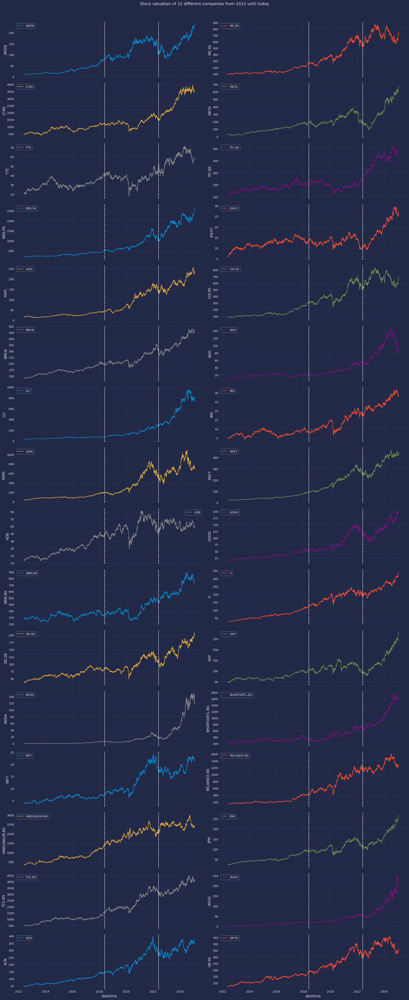

In [13]:
n_rows=math.ceil(len(targets)/2)
fig, axes = plt.subplots(n_rows,2, figsize=(20,3*n_rows), sharex=True)
axes = axes.flat 
fig.suptitle(f"Stock valuation of {len(targets)} different companies from {data.index.min().year} until today", fontsize=14, y=1.01)

color_cycle = cycle(plt.rcParams['axes.prop_cycle'].by_key()['color'])

for column, ax in zip(data, axes):
    sns.lineplot(data=data,
                 x=data.index,
                 y=data[column], 
                 ax=ax,
                 color=next(color_cycle),
                 label=column)    
    ax.axvline(pd.to_datetime(end_train) , color='white', linestyle='--', linewidth=1.5)
    ax.axvline(pd.to_datetime(end_val) , color='white', linestyle='--', linewidth=1.5)

plt.tight_layout()

El número de filas es 3315 y el número de columnas es 32

----------

No hay duplicados

----------

No hay valores nulos

----------

Estadísticas de las variables numéricas:


,count,mean,std,min,25%,50%,75%,max
AMZN,3315.0,84.199124,60.552418,10.411000,24.129749,83.276497,138.040001,238.149994
MC.PA,3315.0,348.055636,240.937701,89.011795,126.864471,260.400940,599.447937,871.436707
LT.NS,3315.0,1378.637457,867.211240,391.848175,840.891052,1101.060059,1632.771240,3947.300049
META,3315.0,187.742708,134.346073,17.662533,88.539282,165.368301,249.506905,689.150024
TTE,3315.0,38.036082,12.023010,17.951597,29.024285,35.555805,42.257851,71.560463
ITC.NS,3315.0,229.503061,98.604086,105.825653,164.942314,195.017746,237.853249,522.750000
RMS.PA,3315.0,788.595255,638.189022,190.023178,295.383713,511.822296,1202.270081,2702.000000
IDEXY,3315.0,13.810635,4.106047,5.836170,11.376913,12.951007,14.742994,29.520000
AAPL,3315.0,79.412356,67.302581,11.985509,24.616930,43.976475,142.286201,255.589996
CDI.PA,3315.0,345.774981,227.884719,75.738579,129.332979,301.841339,577.774719,834.536377


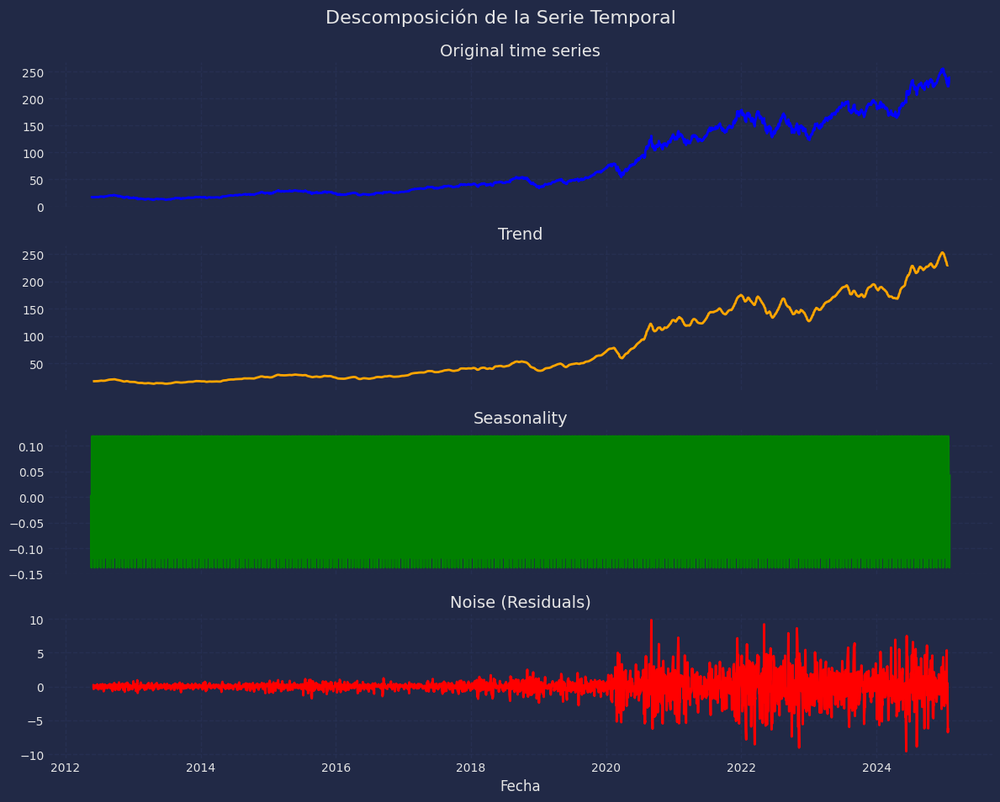

In [14]:
ts_analizer = TimeSeriesAnalysis(data, value_column="AAPL")

ts_analizer.exploracion_datos()

ts_analizer.detectar_estacionalidad()

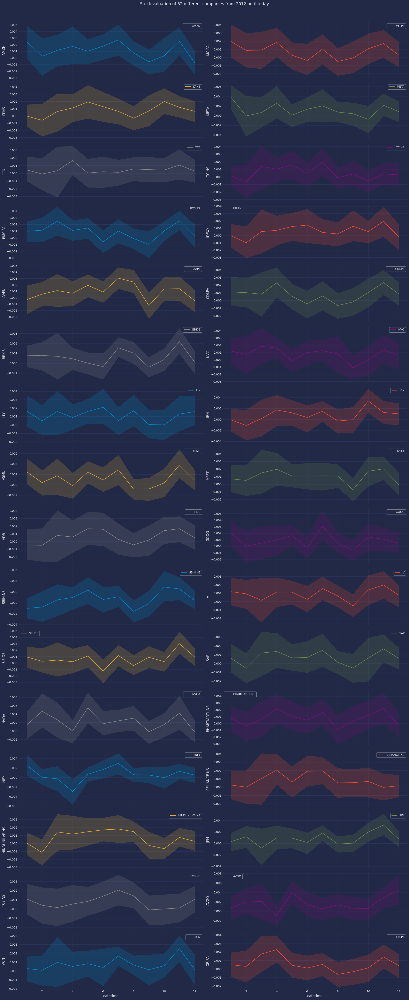

In [15]:
data_pct = data.pct_change().dropna()
n_rows=math.ceil(len(targets)/2)
fig, axes = plt.subplots(n_rows,2, figsize=(20,3*n_rows), sharex=True)
axes = axes.flat 
fig.suptitle(f"Stock valuation of {len(targets)} different companies from {data_pct.index.min().year} until today", fontsize=14, y=1.01)

color_cycle = cycle(plt.rcParams['axes.prop_cycle'].by_key()['color'])

for column, ax in zip(data, axes):
    sns.lineplot(data=data_pct,
                 x=data_pct.index.month,
                 y=data_pct[column], 
                 ax=ax,
                 color=next(color_cycle),
                 label=column)    

plt.tight_layout()

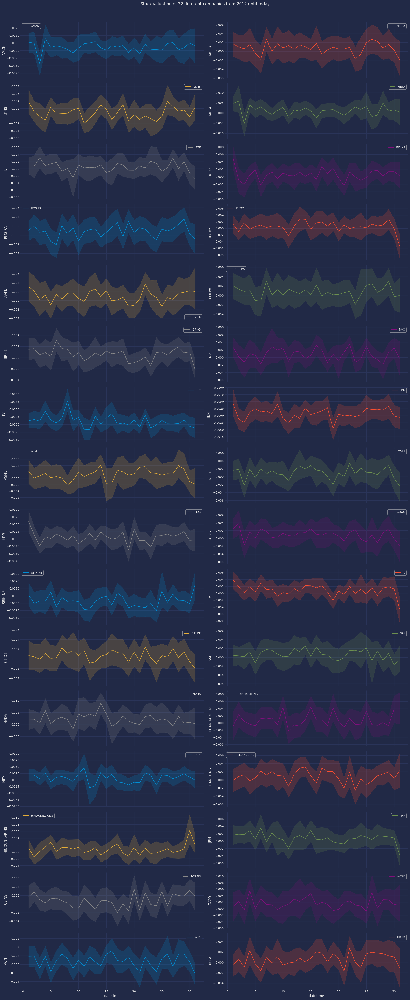

In [16]:
data_pct = data.pct_change().dropna()
n_rows=math.ceil(len(targets)/2)
fig, axes = plt.subplots(n_rows,2, figsize=(20,3*n_rows), sharex=True)
axes = axes.flat 
fig.suptitle(f"Stock valuation of {len(targets)} different companies from {data_pct.index.min().year} until today", fontsize=14, y=1.01)

color_cycle = cycle(plt.rcParams['axes.prop_cycle'].by_key()['color'])

for column, ax in zip(data, axes):
    sns.lineplot(data=data_pct,
                 x=data_pct.index.day,
                 y=data_pct[column], 
                 ax=ax,
                 color=next(color_cycle),
                 label=column)    

plt.tight_layout()

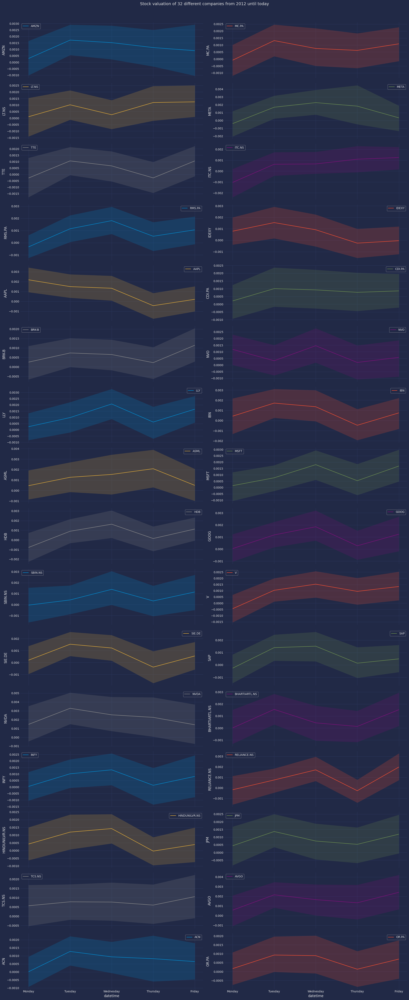

In [17]:
data_pct = data.pct_change().dropna()
n_rows=math.ceil(len(targets)/2)
fig, axes = plt.subplots(n_rows,2, figsize=(20,3*n_rows), sharex=True)
axes = axes.flat 
fig.suptitle(f"Stock valuation of {len(targets)} different companies from {data_pct.index.min().year} until today", fontsize=14, y=1.01)

color_cycle = cycle(plt.rcParams['axes.prop_cycle'].by_key()['color'])

for column, ax in zip(data, axes):
    sns.lineplot(data=data_pct,
                 x=data_pct.index.day_name(),
                 y=data_pct[column], 
                 ax=ax,
                 color=next(color_cycle),
                 label=column)    

plt.tight_layout()

Stationarity Augmented Dickey Fuller test - original series:
Test estacionariedad
-------------------------------------
ADF Statistic: 0.9385065205764145, p-value: 0.9935728221765411
ARCH test p-value: 0.0
Number of volatility lags: 253987.41953650658


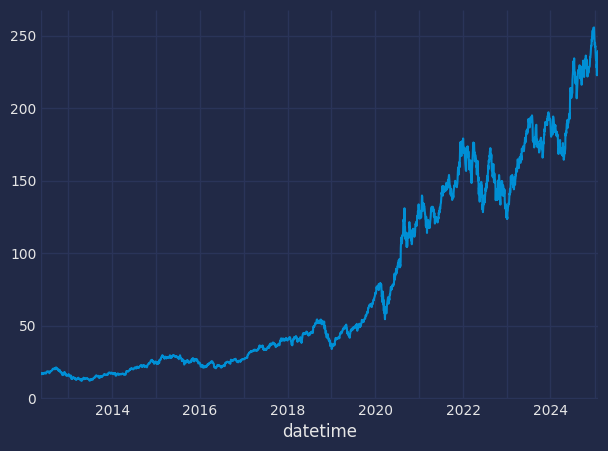


Stationarity Augmented Dickey Fuller test - differentiated series:
Test estacionariedad
-------------------------------------
ADF Statistic: -17.982081089041717, p-value: 2.772607209676129e-30
ARCH test p-value: 2.8778235482750334e-72
Number of volatility lags: 40.870661389876865


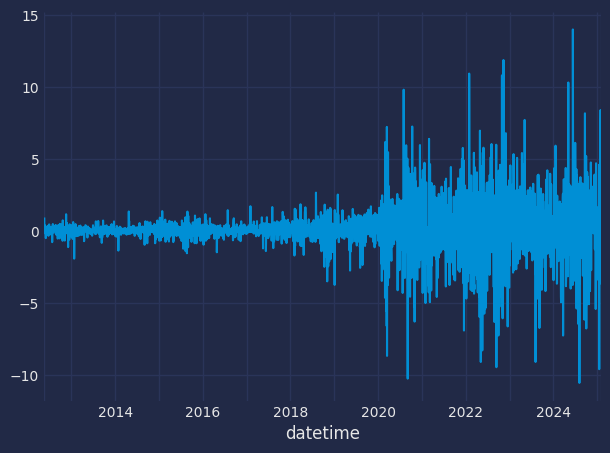


Stationarity Augmented Dickey Fuller test - growth rate series:
Test estacionariedad
-------------------------------------
ADF Statistic: -17.807632232311164, p-value: 3.198890928276941e-30
ARCH test p-value: 2.8602338426714e-69
Number of volatility lags: 39.10120455320114


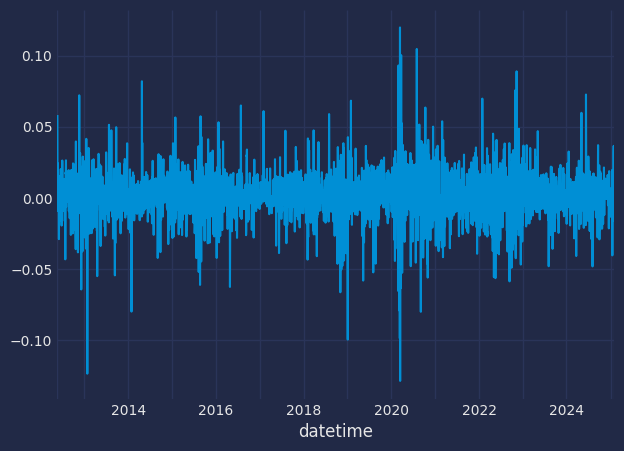

In [18]:
print("Stationarity Augmented Dickey Fuller test - original series:")
data["AAPL"].plot.line()
ts_analizer.prueba_estacionariedad(data["AAPL"])
test_statistic, p_value, lags, critical_values = het_arch(data["AAPL"])
print(f'ARCH test p-value: {p_value}')
print(f'Number of volatility lags: {lags}')
plt.show()


print("\nStationarity Augmented Dickey Fuller test - differentiated series:")
data["AAPL"].diff(1).plot.line()
ts_analizer.prueba_estacionariedad(data["AAPL"].diff(1))
test_statistic, p_value, lags, critical_values = het_arch(data["AAPL"].diff(1).dropna())
print(f'ARCH test p-value: {p_value}')
print(f'Number of volatility lags: {lags}')
plt.show()

print("\nStationarity Augmented Dickey Fuller test - growth rate series:")
data["AAPL"].pct_change(1).plot.line()
ts_analizer.prueba_estacionariedad(data["AAPL"].pct_change(1))
test_statistic, p_value, lags, critical_values = het_arch(data["AAPL"].pct_change(1).dropna())
print(f'ARCH test p-value: {p_value}')
print(f'Number of volatility lags: {lags}')
plt.show()

As we can observe, both 1st order differentiation and 1lag pct_change achieve stationarity according to the ADF test. However, the differentiation is severly impacted by a change in variance. Stock values tend to increase over time, therefore, although differentiation accounts for trend, it does not completely account for variance.

In this case, differencing through the pct_change or growth rate, although not a complete solution to variance changes accross the time series, do mitigate the problem better than differentiation. Besides, returns from stock investments come from the growth rate since the time of investment, and therefore these values make sense. 

After this differentiation, the next step is chosing the best moving average rolling window size and the number of lags to account for. If we do not differentiate the series, we can see that the trend covers most lagged effects.

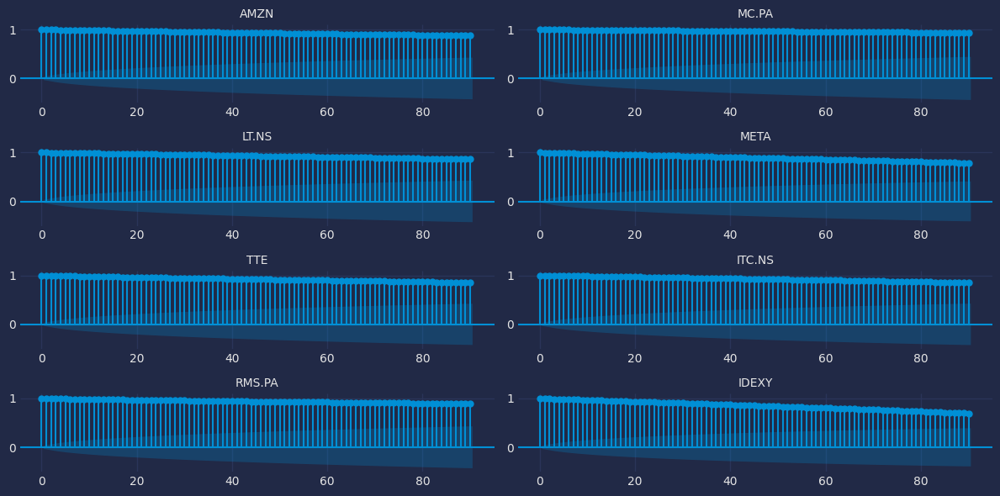

In [19]:
# Autocorrelation plots
# ==============================================================================
n_rows=math.ceil(len(targets)/2)
n_lags = 30 * 3
cols_to_plot = dataframe_simple_pivot.columns[:8]
fig, axs = plt.subplots(4, 2, figsize=(12, 6))
axs = axs.flat
for i, col in enumerate(cols_to_plot):
    plot_acf(data[col], lags=n_lags, ax=axs[i])
    axs[i].set_title(col, fontsize=10)
    axs[i].set_ylim(-0.5, 1.1)
plt.tight_layout()

However, when differentiating with the pct_change, we can see that dependences from past values are not that strong, indicating that past price values depend on other factors, rather than past values.

Showing all possible lags:
AMZN: [8, 56, 18, 26, 9]
MC.PA: [7, 3, 14, 24, 26]
LT.NS: [1, 37, 60, 50, 32]
META: [30, 9, 42, 8, 52]
TTE: [2, 10, 36, 35, 45]
ITC.NS: [28, 34, 5, 37, 6]
RMS.PA: [38, 3, 33, 45, 35]
IDEXY: [6, 14, 45, 49, 2]
AAPL: [9, 8, 14, 7, 6]
CDI.PA: [6, 7, 3, 50, 13]
BRK-B: [7, 6, 1, 8, 2]
NVO: [59, 10, 13, 35, 16]
LLY: [10, 32, 27, 6, 44]
IBN: [9, 60, 49, 1, 6]
ASML: [8, 7, 25, 41, 10]
MSFT: [9, 1, 6, 8, 25]
HDB: [6, 29, 58, 27, 45]
GOOG: [9, 8, 6, 50, 7]
SBIN.NS: [54, 60, 6, 48, 9]
V: [6, 9, 15, 1, 13]
SIE.DE: [38, 53, 9, 2, 55]
SAP: [2, 6, 4, 46, 7]
NVDA: [17, 55, 50, 9, 7]
BHARTIARTL.NS: [47, 17, 41, 3, 55]
INFY: [34, 44, 45, 23, 9]
RELIANCE.NS: [6, 44, 34, 37, 1]
HINDUNILVR.NS: [56, 34, 7, 5, 48]
JPM: [7, 2, 9, 8, 4]
TCS.NS: [33, 19, 11, 1, 26]
AVGO: [8, 3, 51, 6, 9]
ACN: [9, 6, 7, 8, 10]
OR.PA: [3, 1, 14, 38, 42]


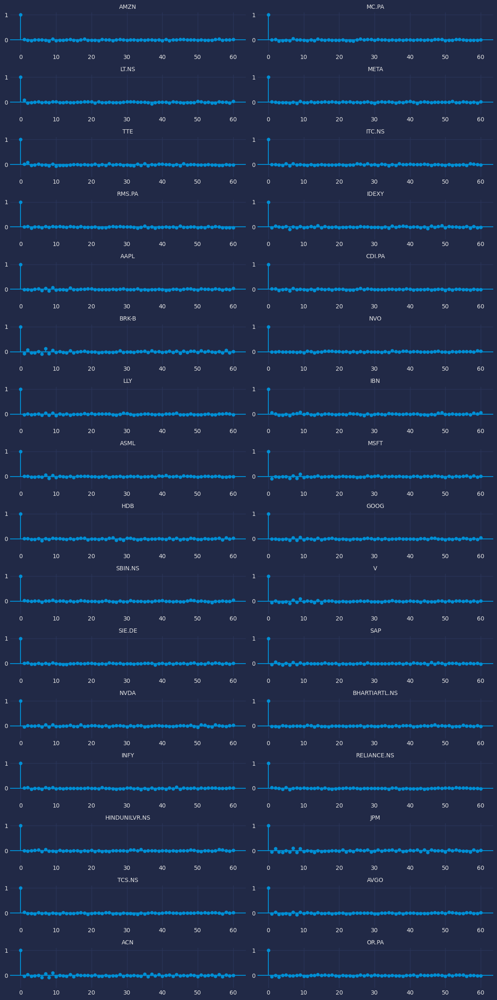

In [20]:
top_lags_acf, top_lags_acf_dict  = calculate_top_acf_pacf_df(data, data.columns, n_lags=60, method='acf')

Inspect partial autocorrelation values for lags:

Showing all possible lags:
AMZN: [56, 8, 9, 42, 26]
MC.PA: [7, 3, 24, 14, 26]
LT.NS: [1, 37, 60, 22, 50]
META: [30, 9, 8, 42, 52]
TTE: [2, 10, 36, 32, 35]
ITC.NS: [28, 5, 34, 57, 6]
RMS.PA: [38, 3, 45, 33, 35]
IDEXY: [6, 2, 45, 14, 49]
AAPL: [9, 8, 7, 14, 6]
CDI.PA: [6, 7, 3, 50, 1]
BRK-B: [7, 1, 6, 2, 45]
NVO: [59, 10, 13, 23, 35]
LLY: [10, 32, 27, 14, 6]
IBN: [9, 60, 6, 1, 49]
ASML: [8, 7, 41, 25, 39]
MSFT: [1, 6, 9, 8, 25]
HDB: [6, 58, 27, 29, 57]
GOOG: [9, 8, 6, 50, 23]
SBIN.NS: [54, 60, 6, 31, 9]
V: [6, 9, 1, 4, 15]
SIE.DE: [38, 9, 2, 50, 53]
SAP: [2, 4, 6, 50, 20]
NVDA: [17, 50, 55, 7, 9]
BHARTIARTL.NS: [47, 17, 41, 3, 52]
INFY: [34, 23, 44, 45, 6]
RELIANCE.NS: [6, 44, 37, 34, 1]
HINDUNILVR.NS: [56, 34, 7, 57, 5]
JPM: [7, 2, 4, 9, 1]
TCS.NS: [19, 33, 1, 32, 26]
AVGO: [8, 3, 36, 6, 23]
ACN: [9, 6, 7, 8, 10]
OR.PA: [3, 1, 42, 14, 11]


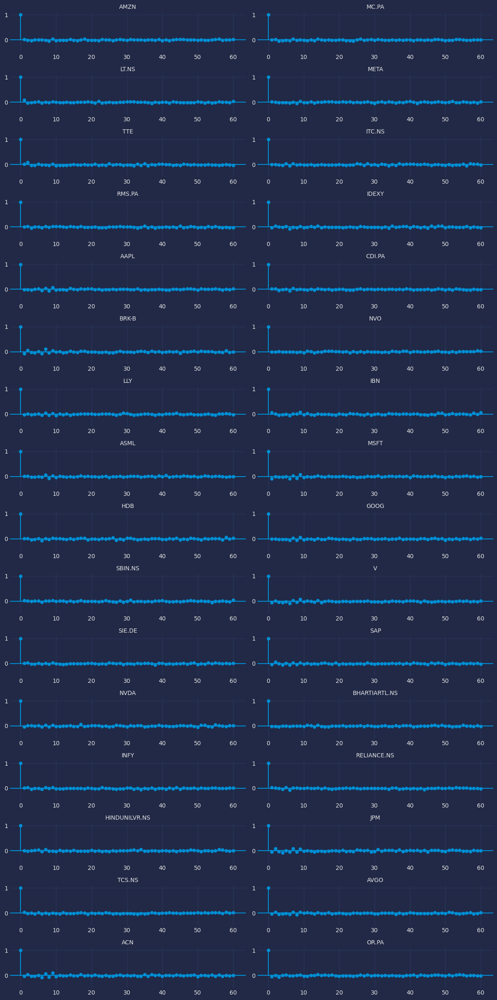

In [21]:
top_lags_pacf, top_lags_pacf_dict = calculate_top_acf_pacf_df(data, data.columns, n_lags=60, method='pacf')

For comparison, 3 models will be fitted: 
- A 1_lag model, without any window funtions, and just 2 features
- A second model with all 8 features
- A third model with all 8 features + the multitude of functions showed earlier.

## 2.1 Compare approaches for multiseries modelling - recursive models

### 2.2.1 Approach 1: Single model for every ticker

In [21]:
# Entrenar y realizar backtesting de un modelo para cada item
# ======================================================================================
items = []
mape_values = []
predictions = {}
forecasters = {}

for i, item in enumerate(tqdm(data[targets].columns)):
    # Definir el forecaster
    window_features = RollingFeatures(stats=['mean']*len(top_lags_acf_dict[item]), window_sizes=top_lags_acf_dict[item])
    forecasters[item] = ForecasterRecursive(
                     regressor       = HistGradientBoostingRegressor(random_state=8523, loss="absolute_error"),
                     lags            = top_lags_pacf_dict[item],
                     window_features = window_features,
                     differentiation = 1
                 )
    forecasters[item].fit(y=data.loc[start_train:end_val,item])
    # Backtesting forecaster
    cv = TimeSeriesFold(
            steps              = forecast_horizon, # =7
            initial_train_size = len(data.loc[start_train:end_val,item]),
            refit              = 8,
            fixed_train_size   = True,
            differentiation = 1
         )
    metric, preds = backtesting_forecaster(
                        forecaster    = forecasters[item],
                        y             = data.loc[start_train:end_test,item],
                        cv            = cv,
                        metric        = 'mean_absolute_percentage_error', 
                        verbose       = False,
                        show_progress = False
                    )
    items.append(item)
    mape_values.append(metric.at[0, 'mean_absolute_percentage_error'])
    predictions[item] = preds

# Resultados
uni_series_mape = pd.DataFrame({
                    "levels": items,
                    "mean_absolute_percentage_error": mape_values
                    })
uni_series_mape
print(f"The mean MAPE for uniseries is {uni_series_mape['mean_absolute_percentage_error'].mean():.4f}")

  0%|          | 0/32 [00:04<?, ?it/s]


KeyboardInterrupt: 

### 2.1.2 Approach 2: Multiseries model

In [101]:
# # Define the forecaster. 
# window_features = RollingFeatures(stats=['mean']*len(top_lags_acf), window_sizes=top_lags_acf) # window features de prueba. Esto me puede servir para soportes y resistencias. 
# forecaster_ms_1 = ForecasterRecursiveMultiSeries(
#                     regressor       = HistGradientBoostingRegressor(random_state=8523, loss="absolute_error"),
#                     lags            = top_lags_pacf, # lags de prueba
#                     transformer_series = StandardScaler(),
#                     window_features=window_features,
#                     differentiation=1
#                 )

# forecaster_ms_1.fit(series=data.loc[start_train:end_val,], exog=None, suppress_warnings=True)
# display(forecaster_ms_1)

# # Backtesitng 
# cv = TimeSeriesFold(
#             steps              = forecast_horizon,
#             initial_train_size = len(data.loc[start_train:end_val,],),
#             refit              = 8,
#             fixed_train_size   = True,
#             differentiation=1
#          )

# multi_series_mae_1, predictions_1 = backtesting_forecaster_multiseries(
#                                        forecaster            = forecaster_ms_1,
#                                        series                = data.loc[start_train:end_test,], 
#                                        levels                = targets,
#                                        cv                    = cv,
#                                        metric                = 'mean_absolute_percentage_error',
#                                        add_aggregated_metric = False,
#                                        verbose               = False,
#                                        show_progress         = True  
#                                    )   
# # Resultados
# display(multi_series_mae_1)
# print(f"Mean MAPE error accross series is {multi_series_mae_1['mean_absolute_percentage_error'].mean():.4f}")

# print('')
# display(predictions_1)

============================== 
ForecasterRecursiveMultiSeries 
============================== 
Regressor: HistGradientBoostingRegressor 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 19 20 21 23 25 26 27 28
 29 30 31 33 34 35 36 38 41 42 43 48 49 50 52 53 54 56 57 58] 
Window features: ['roll_mean_1', 'roll_mean_2', 'roll_mean_3', 'roll_mean_4', 'roll_mean_5', 'roll_mean_6', 'roll_mean_7', 'roll_mean_8', 'roll_mean_9', 'roll_mean_10', 'roll_mean_11', 'roll_mean_12', 'roll_mean_13', 'roll_mean_14', 'roll_mean_15', 'roll_mean_16', 'roll_mean_17', 'roll_mean_19', 'roll_mean_20', 'roll_mean_21', 'roll_mean_23', 'roll_mean_25', 'roll_mean_26', 'roll_mean_27', 'roll_mean_28', 'roll_mean_29', 'roll_mean_30', 'roll_mean_31', 'roll_mean_32', 'roll_mean_33', 'roll_mean_34', 'roll_mean_35', 'roll_mean_36', 'roll_mean_38', 'roll_mean_39', 'roll_mean_41', 'roll_mean_42', 'roll_mean_43', 'roll_mean_44', 'roll_mean_48', 'roll_mean_49', 'roll_mean_52', 'roll_mean_53', 'roll_mean_54', 'roll_mean_56', 'roll_mean_57', 'roll_mean_58'] 
Window size: 59 
Series encoding: ordinal 
Series names (levels): 
    RMS.PA, ACN, OR.PA, SIE.DE, SBIN.NS, HDB, NVO, RELIANCE.NS, INFY, TCS.NS,
    HINDUNILVR.NS, BRK-B, GOOG, V, CDI.PA, TTE, JPM, IBN, ITC.NS, IDEXY, SAP,
    AMZN, NVDA, AVGO, META, LLY, MC.PA, ASML, BHARTIARTL.NS, MSFT, AAPL, LT.NS 
Exogenous included: False 
Exogenous names: None 
Transformer for series: StandardScaler() 
Transformer for exog: None 
Weight function included: False 
Series weights: None 
Differentiation order: 1 
Training range: 
    'RMS.PA': ['2012-05-18', '2022-05-31'], 'ACN': ['2012-05-18', '2022-05-31'],
    'OR.PA': ['2012-05-18', '2022-05-31'], 'SIE.DE': ['2012-05-18',
    '2022-05-31'], 'SBIN.NS': ['2012-05-18', '2022-05-31'], ..., 'ASML':
    ['2012-05-18', '2022-05-31'], 'BHARTIARTL.NS': ['2012-05-18', '2022-05-31'],
    'MSFT': ['2012-05-18', '2022-05-31'], 'AAPL': ['2012-05-18', '2022-05-31'],
    'LT.NS': ['2012-05-18', '2022-05-31'] 
Training index type: DatetimeIndex 
Training index frequency: D 
Regressor parameters: 
    {'categorical_features': 'warn', 'early_stopping': 'auto', 'interaction_cst':
    None, 'l2_regularization': 0.0, 'learning_rate': 0.1, 'loss':
    'absolute_error', 'max_bins': 255, 'max_depth': None, 'max_features': 1.0,
    'max_iter': 100, 'max_leaf_nodes': 31, 'min_samples_leaf': 20,
    'monotonic_cst': None, 'n_iter_no_change': 10, 'quantile': None,
    'random_state': 8523, 'scoring': 'loss', 'tol': 1e-07,
    'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False} 
fit_kwargs: {} 
Creation date: 2025-02-01 16:38:46 
Last fit date: 2025-02-01 16:38:53 
Skforecast version: 0.14.0 
Python version: 3.10.12 
Forecaster id: None

  0%|          | 0/139 [00:00<?, ?it/s]

,levels,mean_absolute_percentage_error
0,RMS.PA,0.021806
1,ACN,0.022551
2,OR.PA,0.018352
3,SIE.DE,0.022354
4,SBIN.NS,0.019372
...,...,...
27,ASML,0.035259
28,BHARTIARTL.NS,0.016380
29,MSFT,0.021706
30,AAPL,0.021022


Mean MAPE error accross series is 0.0220



,RMS.PA,ACN,OR.PA,SIE.DE,SBIN.NS,HDB,NVO,RELIANCE.NS,INFY,TCS.NS,...,NVDA,AVGO,META,LLY,MC.PA,ASML,BHARTIARTL.NS,MSFT,AAPL,LT.NS
2022-06-01,1100.095976,285.657406,315.480500,116.038686,451.638820,56.684930,53.833174,1205.821399,17.608896,3155.931811,...,18.643675,54.547394,192.766075,305.716966,574.132503,562.650728,692.425748,265.946691,147.114222,1611.718281
2022-06-02,1102.899741,285.010335,316.312549,116.300886,452.300245,56.545944,53.965591,1209.959395,17.607355,3162.780314,...,18.638797,54.549243,192.829164,305.437472,575.081040,562.833382,693.095262,265.815862,147.380433,1616.703213
2022-06-03,1105.542812,284.438881,317.097502,116.465538,452.358987,56.429428,54.059396,1212.613516,17.611487,3168.990217,...,18.642261,54.546972,192.913402,305.043620,576.079166,563.017915,693.177570,265.674916,147.607245,1619.918224
2022-06-04,1107.413816,284.009955,317.919776,116.558844,452.417894,56.344495,54.130016,1214.542157,17.616134,3175.221699,...,18.642961,54.546839,192.994672,304.852810,576.886379,563.249434,693.258310,265.565164,147.816719,1622.582577
2022-06-05,1109.340346,283.458617,318.627870,116.701700,452.507279,56.248190,54.212300,1216.624957,17.622376,3182.732326,...,18.641722,54.547087,193.074172,304.610362,577.910853,563.517268,693.305270,265.462024,148.058586,1625.562764
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-01-20,2367.900478,348.896944,325.005582,195.010037,750.243468,59.187300,81.815840,1237.774161,22.505212,4163.593441,...,129.536284,222.553281,592.705301,739.273382,657.555059,745.157475,1610.214907,415.440693,232.327877,3453.290667
2025-01-21,2366.464821,348.892847,325.061156,195.098439,750.811170,59.246437,81.904236,1237.676867,22.508153,4164.028495,...,129.389261,222.185885,592.581348,739.161144,657.203760,745.775713,1611.156897,415.458904,232.242482,3455.379123
2025-01-22,2569.821414,357.302934,341.060196,201.984165,758.329551,58.939165,81.278797,1270.565717,21.148596,4026.832838,...,141.286310,240.937194,617.379534,745.300891,703.396920,764.179653,1625.720252,428.576023,221.747909,3535.473721
2025-01-23,2578.503697,357.791619,340.979823,202.090842,757.862740,58.990946,81.276085,1269.207943,21.147285,4024.362526,...,141.666527,241.554087,617.991967,747.556200,705.051175,765.064499,1625.253168,428.652983,221.308620,3531.703596


This approach is similar in terms of MAPE, but a lot easier to train. However, it has a big drawback and it is that features all need to have the same dates, where actually some stocks had their first IPO at very different times. 

As an additional issue, although multiseries tends to have much faster times of training, the huge amount of rolling windows and lags it has received from the prior selection has slowed down its training. Therefore, this method can be greatly improved through either clustering similar stocks or stocks with the highest amount of correlation/interaction.

Let's try another approach that works as long as there is data for all train, test and validation.

### 2.1.3 Approach 3: Multivariate independant

In [23]:
targets = dataframe_simple["symbol"].unique().to_list()
data_vertical = dataframe_simple
forecast_horizon = 7 # timesteps, days in this case

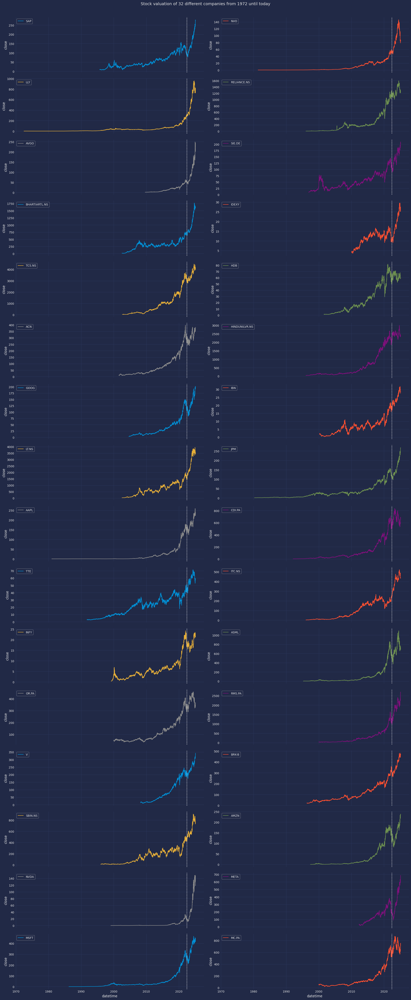

In [75]:
n_rows=math.ceil(len(targets)/2)
fig, axes = plt.subplots(n_rows,2, figsize=(20,3*n_rows), sharex=True)
axes = axes.flat 
fig.suptitle(f"Stock valuation of {len(targets)} different companies from {data_vertical['datetime'].dt.year().min()} until today", fontsize=14, y=1.005)

color_cycle = cycle(plt.rcParams['axes.prop_cycle'].by_key()['color'])

for ticker, ax in zip(targets, axes):
    sns.lineplot(data=data_vertical.filter(pl.col("symbol")==ticker),
                 x="datetime",
                 y="close", 
                 ax=ax,
                 color=next(color_cycle),
                 label=ticker)
    ax.axvline(pd.to_datetime(end_val), color='white', linestyle='--', linewidth=1)

plt.tight_layout()

In [24]:
data_symbol_global = pd.DataFrame()
for symbol in data_vertical["symbol"].unique().to_list():
    data_symbol = data_vertical.filter(pl.col("symbol")==symbol, pl.col("datetime")>datetime(2012,5,18)).select("datetime","close").to_pandas().set_index("datetime").asfreq("B").interpolate()
    data_symbol["symbol"] = symbol
    data_symbol_global = pd.concat([data_symbol_global,data_symbol])

data_symbol_global

,close,symbol
datetime,,
2012-05-21,2.238280,AVGO
2012-05-22,2.264349,AVGO
2012-05-23,2.427277,AVGO
2012-05-24,2.354140,AVGO
2012-05-25,2.400485,AVGO
...,...,...
2025-01-24,2368.100098,HINDUNILVR.NS
2025-01-27,2392.850098,HINDUNILVR.NS
2025-01-28,2388.850098,HINDUNILVR.NS


In [27]:
data_symbol_global.reset_index()

,datetime,close,symbol
0,2012-05-21,2.238280,AVGO
1,2012-05-22,2.264349,AVGO
2,2012-05-23,2.427277,AVGO
3,2012-05-24,2.354140,AVGO
4,2012-05-25,2.400485,AVGO
...,...,...,...
106043,2025-01-24,2368.100098,HINDUNILVR.NS
106044,2025-01-27,2392.850098,HINDUNILVR.NS
106045,2025-01-28,2388.850098,HINDUNILVR.NS
106046,2025-01-29,2383.949951,HINDUNILVR.NS


In [30]:
# Transform series and exog to dictionaries
# ==============================================================================
series_dict = series_long_to_dict(
                data      = data_symbol_global.reset_index(),
                series_id = 'symbol',
                index     = 'datetime',
                values    = 'close',
                freq      = 'B'
              )

# exog_dict = exog_long_to_dict(
#                 data      = exog,
#                 series_id = 'series_id',
#                 index     = 'timestamp',
#                 freq      = 'D'
#             )

In [78]:
# Particiones de entrenamiento y test
# ==============================================================================
series_dict_train = {k: v.loc[start_train: end_val,] for k, v in series_dict.items()}
# exog_dict_train   = {k: v.loc[: end_train,] for k, v in exog_dict.items()}
series_dict_test  = {k: v.loc[end_val:end_test,] for k, v in series_dict.items()}
# exog_dict_test    = {k: v.loc[end_train:,] for k, v in exog_dict.items()}

# Descripción de cada serie
# ==============================================================================
for k in series_dict.keys():
    print(f"{k}:")
    try:
        print(
            f"\tTrain: len={len(series_dict_train[k])}, {series_dict_train[k].index[0]}"
            f" --- {series_dict_train[k].index[-1]} "
            f" (missing={series_dict_train[k].isnull().sum()})"
        )
    except:
        print(f"\tTrain: len=0")
    try:
        print(
            f"\tTest : len={len(series_dict_test[k])}, {series_dict_test[k].index[0]}"
            f" --- {series_dict_test[k].index[-1]} "
            f" (missing={series_dict_test[k].isnull().sum()})"
        )
    except:
        print(f"\tTest : len=0")

AAPL:
	Train: len=3652, 2012-05-28 00:00:00 --- 2022-05-27 00:00:00  (missing=0)
	Test : len=967, 2022-05-27 00:00:00 --- 2025-01-17 00:00:00  (missing=0)
ACN:
	Train: len=3652, 2012-05-28 00:00:00 --- 2022-05-27 00:00:00  (missing=0)
	Test : len=967, 2022-05-27 00:00:00 --- 2025-01-17 00:00:00  (missing=0)
AMZN:
	Train: len=3652, 2012-05-28 00:00:00 --- 2022-05-27 00:00:00  (missing=0)
	Test : len=967, 2022-05-27 00:00:00 --- 2025-01-17 00:00:00  (missing=0)
ASML:
	Train: len=3652, 2012-05-28 00:00:00 --- 2022-05-27 00:00:00  (missing=0)
	Test : len=967, 2022-05-27 00:00:00 --- 2025-01-17 00:00:00  (missing=0)
AVGO:
	Train: len=3652, 2012-05-28 00:00:00 --- 2022-05-27 00:00:00  (missing=0)
	Test : len=967, 2022-05-27 00:00:00 --- 2025-01-17 00:00:00  (missing=0)
BHARTIARTL.NS:
	Train: len=3652, 2012-05-28 00:00:00 --- 2022-05-27 00:00:00  (missing=0)
	Test : len=967, 2022-05-27 00:00:00 --- 2025-01-17 00:00:00  (missing=0)
BRK-B:
	Train: len=3652, 2012-05-28 00:00:00 --- 2022-05-27 00

In [27]:
# # Fit forecaster
# # ==============================================================================
# regressor = HistGradientBoostingRegressor(random_state=8523, loss="quantile", quantile=0.5)
# # Define the forecaster. 
# window_features = RollingFeatures(stats=['mean']*len(top_lags_acf), window_sizes=top_lags_acf) # window features de prueba. Esto me puede servir para soportes y resistencias. 
# forecaster_3 = ForecasterRecursiveMultiSeries(
#                     regressor       = regressor,
#                     lags            = top_lags_pacf, # lags de prueba
#                     transformer_series = StandardScaler(),
#                     window_features=window_features,
#                     differentiation=1,
#                 )
# forecaster_3.fit(series=series_dict_train, exog=None, suppress_warnings=False)
# forecaster_3

In [28]:
# # Backtesting
# # ==============================================================================
# cv = TimeSeriesFold(
#         steps              = forecast_horizon,
#         initial_train_size = len(series_dict_train["AAPL"]),
#         refit              = 8,
#         fixed_train_size   = True,
#         differentiation=1
#      )

# metrics_levels, backtest_predictions = backtesting_forecaster_multiseries(
#     forecaster            = forecaster_3,
#     series                = series_dict,
#     exog                  = None,
#     cv                    = cv,
#     metric                = "mean_absolute_percentage_error",
#     add_aggregated_metric = False,
#     n_jobs                = "auto",
#     verbose               = False,
#     show_progress         = True,
#     suppress_warnings     = True
# )

# display(metrics_levels)
# print(f"The mean MAPE is {metrics_levels['mean_absolute_percentage_error'].mean()}")
# display(backtest_predictions)

In [29]:
metrics_levels.tail(20)

NameError: name 'metrics_levels' is not defined

In [ ]:
backtest_predictions.tail(5)

,AAPL,ACN,AMZN,ASML,AVGO,BHARTIARTL.NS,BRK-B,CDI.PA,GOOG,HDB,...,NVO,OR.PA,RELIANCE.NS,RMS.PA,SAP,SBIN.NS,SIE.DE,TCS.NS,TTE,V
2025-01-26,222.948622,358.031363,232.563824,767.346828,241.752971,1627.414323,469.322924,654.199541,200.662967,59.246103,...,81.458858,342.371748,1274.541635,2567.055695,269.553781,759.040623,201.940838,4045.230278,59.068820,324.453243
2025-01-27,222.892785,358.272079,232.825116,767.923223,241.823351,1627.928461,469.357880,654.891870,200.774269,59.316255,...,81.460075,342.574480,1275.483557,2567.643201,269.543437,759.019663,201.978154,4046.435871,59.068585,324.526334
2025-01-28,222.979500,358.504594,232.975358,768.265495,241.704251,1628.096729,469.381039,655.285232,200.863285,59.347385,...,81.456897,342.729676,1276.190082,2568.497356,269.703846,759.152400,202.013934,4048.491780,59.079987,324.616259
2025-01-29,238.268750,378.915493,237.557554,680.967883,207.077156,1619.350646,469.149082,693.575452,196.646013,60.325244,...,85.004469,367.691701,1236.488560,2665.807847,273.468429,753.825967,199.577903,4028.126000,58.141962,334.271442
2025-01-30,238.496468,379.345105,237.648975,679.273328,207.281400,1620.083651,468.591301,694.341234,196.605087,60.275285,...,84.882426,367.851712,1237.613908,2666.396980,273.405247,754.968117,199.272845,4025.800524,58.166019,334.276275


In [ ]:
methods_comparison = uni_series_mape.merge(multi_series_mae_1, on="levels").merge(metrics_levels, on="levels")
methods_comparison.columns = ["levels","separate_series","multiseries","asynchronous_series"]

methods_comparison[["separate_series","multiseries","asynchronous_series"]].mean()

### 2.1.4 Approach 4: Multivariate direct - one model per ticker

In [110]:
data = dataframe_simple_pivot.asfreq("D").interpolate()
start_train = "2012-06-04"
end_train = '2018-05-28'
end_val = '2022-05-27'
end_test = '2025-01-17'

data = data.loc[start_train:end_test]
targets = data.columns.to_list()
data

,AMZN,MC.PA,LT.NS,META,TTE,ITC.NS,RMS.PA,IDEXY,AAPL,CDI.PA,...,NVDA,BHARTIARTL.NS,INFY,RELIANCE.NS,HINDUNILVR.NS,JPM,TCS.NS,AVGO,ACN,OR.PA
datetime,,,,,,,,,,,,,,,,,,,,,
2012-06-04,10.728500,89.011795,429.666351,26.797632,20.149734,107.793190,230.209900,5.912484,17.000183,75.738579,...,0.268935,248.075684,3.916655,136.129669,330.602570,21.817818,475.021759,2.210762,44.765900,71.648102
2012-06-05,10.660500,90.446182,443.451630,25.771557,20.286913,105.825653,228.936996,5.894315,16.956202,76.808548,...,0.276731,241.885376,3.971704,138.055435,326.514069,22.514584,480.209381,2.274486,45.260468,71.835083
2012-06-06,10.882000,94.231384,463.955566,26.707975,20.750452,109.877869,233.710342,6.076012,17.216188,79.598129,...,0.284067,250.391785,4.124002,140.678787,336.735260,23.274691,489.860474,2.387450,46.600574,72.973282
2012-06-07,10.940000,96.422806,466.829712,26.209879,20.641651,110.721046,239.301926,6.163229,17.224031,81.661613,...,0.272604,253.929123,4.025835,141.730087,339.701385,23.091696,488.698029,2.386002,46.951557,73.704964
2012-06-08,10.924000,95.107956,479.443237,26.996874,20.599087,112.056206,235.165024,6.112353,17.483120,81.279503,...,0.277877,256.245270,4.001979,143.390579,344.150574,23.703999,485.033295,2.450450,46.688313,74.249657
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-01-13,218.460007,646.400024,3464.300049,608.330017,56.810001,439.049988,2353.000000,25.080000,234.399994,605.000000,...,133.229996,1597.199951,22.690001,1239.849976,2451.000000,244.210007,4223.769531,225.289993,349.140015,328.399994
2025-01-14,217.759995,651.000000,3462.600098,594.250000,57.560001,436.600006,2359.000000,25.360001,233.279999,608.000000,...,131.759995,1600.099976,22.510000,1238.750000,2367.949951,247.470001,4166.629883,224.699997,348.989990,326.649994
2025-01-15,223.350006,637.200012,3501.399902,617.119995,57.680000,437.350006,2364.000000,25.799999,237.869995,594.000000,...,136.240005,1607.449951,22.889999,1252.199951,2373.000000,252.350006,4182.920898,228.000000,349.730011,329.500000


In [30]:
data_train = data.loc[start_train:end_train]
data_val = data.loc[end_train:end_val]
data_train_val = data.loc[start_train:end_val]
data_test = data.loc[end_val:end_test]
targets = targets
forecast_horizon = 7

In [31]:
regressor = HistGradientBoostingRegressor(random_state=8523, loss="quantile", quantile=0.5)

In [32]:
# # Entrenar y realizar backtesting de un modelo para cada item - direct
# # ======================================================================================
# items = []
# mape_values = []
# predictions = {}
# forecasters_direct = {}

# for i, item in enumerate(tqdm(data[targets].columns)):
#     # Definir el forecaster
#     window_features = RollingFeatures(stats=['mean']*len(top_lags_acf_dict[item]), window_sizes=top_lags_acf_dict[item])

#     forecasters_direct[item] = ForecasterDirectMultiVariate(
#                                     level                   = item,
#                                     regressor               = regressor,
#                                     steps                   = forecast_horizon,
#                                     lags                    = top_lags_pacf_dict[item],
#                                     window_features         = window_features,
#                                     differentiation=        1,
#                                     n_jobs="auto"
#                                     )
    
#     # Backtesitng 
#     cv = TimeSeriesFold(
#                 steps              = forecast_horizon,
#                 initial_train_size =  len(data_train_val),
#                 refit              = 8,
#                 fixed_train_size   = True,
#                 differentiation=1
#             )

#     metric, preds = backtesting_forecaster_multiseries(
#                                         forecaster            = forecasters_direct[item],
#                                         series                = data[[item]], 
#                                         levels                = [item],
#                                         exog                  = None,
#                                         cv                    = cv,
#                                         metric                = 'mean_absolute_percentage_error',
#                                         add_aggregated_metric = False,
#                                         verbose               = False,
#                                         suppress_warnings     = True,
#                                         show_progress         = False ,
#                                         n_jobs=6
#                                     )   

    
#     items.append(item)
#     mape_values.append(metric.at[0, 'mean_absolute_percentage_error'])
#     predictions[item] = preds

# # Resultados
# direct_series_mape = pd.DataFrame({
#                     "levels": items,
#                     "mean_absolute_percentage_error": mape_values
#                     })
# direct_series_mape
# print(f"The mean MAPE for uniseries is {direct_series_mape['mean_absolute_percentage_error'].mean():.4f}")

In [33]:
# pd.set_option("display.max_rows",None)
# display(direct_series_mape)
# pd.set_option("display.max_rows",20)


In [34]:
methods_comparison = uni_series_mape.merge(multi_series_mae_1, on="levels").merge(metrics_levels, on="levels")
methods_comparison.columns = ["levels","separate_series","multiseries","asynchronous_series"]

methods_comparison[["separate_series","multiseries","asynchronous_series"]].mean()

NameError: name 'uni_series_mape' is not defined

The best overall is the Multiseries model. It is a faster model structure and works in providing more samples for the algorithm to learn certain patterns. However, the comparison is not fair given that no exogenous features have been introduced. Therefore it might be wise to continue exploring both the direct and the multiseries option.

## 2.2 Improve multi dependent series

There are several approaches to improving the model:
1. Subdivide in multiple multiseries models grouped by correlated stocks, by sectors, countries, etc. or grouped by clusters
    - [X] Correlated
    - Cross-correlated (?)
    - Optional: Try clustering 
2. [X] Refine the transformations applied to the series features in terms of lagged and rolling window features. RFE, permutation importance, etc.
3. Add exogenous features: Technical indicators, macroeconomical indicators
3. [X] Handle market close days (missing days of stock information) with weights 
5. Select the best combination of features
6. Select models and tune hyperparameters
7. Compare refitting approaches; whole or sliding window retraining. Window size if fixed


We'll go with approach 4 first.

### 2.2.1 Subdivide into correlated stocks models.

This approach can be applied by grouping stocks according to:
- Their correlation coefficients
- Their lead-lag effect though cross-correlation modelling
- Clustering.

We'll start by the simplest, their correlation coefficients.

Given that the overall trend can be highly correlated given that most stocks have seen their values increased throughout the years for common reasons: global economic growth, inflation, etc, the correlation coefficient can be inflated. Therefore, it makes more sense to measure the correlation coefficient for their differentiated values.

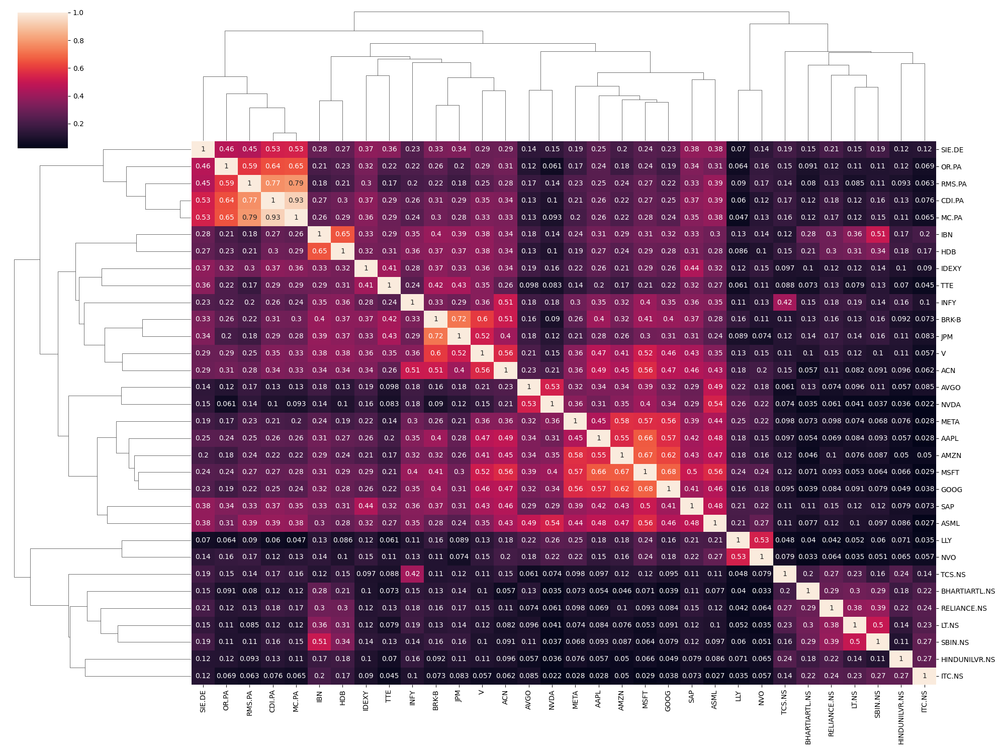

In [20]:
plt.style.use('default')
corr_matrix = dataframe_simple_pivot.loc[start_train:end_test].ffill().diff(1).corr()
clustered_corr = sns.clustermap(corr_matrix, annot=True, figsize=(20, 15), method='average')

plt.show()

Obtain the stocks stored data to replace the indices with the names of the stocks by their information:

In [21]:

data_dict = {
    'symbol': [],
    'industry': [],
    'sector': [],
    'country': [],
    'region': []
}

for file in file_handler.list_all_files("../../data/extracted/OHLCV/"):
    if "parquet" in str(file):
        stock_first_row = file_handler.read_parquet_file(file)[0]
        data_dict['symbol'].append(stock_first_row['symbol'][0])
        data_dict['industry'].append(stock_first_row['industry'][0])
        data_dict['sector'].append(stock_first_row['sector'][0])
        data_dict['country'].append(stock_first_row['country'][0])
        data_dict['region'].append(stock_first_row['region'][0])

stocks_info = pl.DataFrame(data_dict)

/home/miguel/data_science/algorithmic_trading/notebooks/../src/support/../../data/extracted/OHLCV/


In [22]:
stocks_info

symbol,industry,sector,country,region
str,str,str,str,str
"""AVGO""","""semiconductors""","""technology""","""united_states""","""US_AMERICA"""
"""V""","""credit-services""","""financial-services""","""united_states""","""US_AMERICA"""
"""AMZN""","""internet-retail""","""consumer-cyclical""","""united_states""","""US_AMERICA"""
"""META""","""internet-content-information""","""communication-services""","""united_states""","""US_AMERICA"""
"""LLY""","""drug-manufacturers-general""","""healthcare""","""united_states""","""US_AMERICA"""
…,…,…,…,…
"""ASML""","""semiconductor-equipment-materi…","""technology""","""netherlands""","""EU"""
"""SAP""","""software-application""","""technology""","""germany""","""EU"""
"""SIE.DE""","""specialty-industrial-machinery""","""industrials""","""germany""","""EU"""


First let's compare by region:

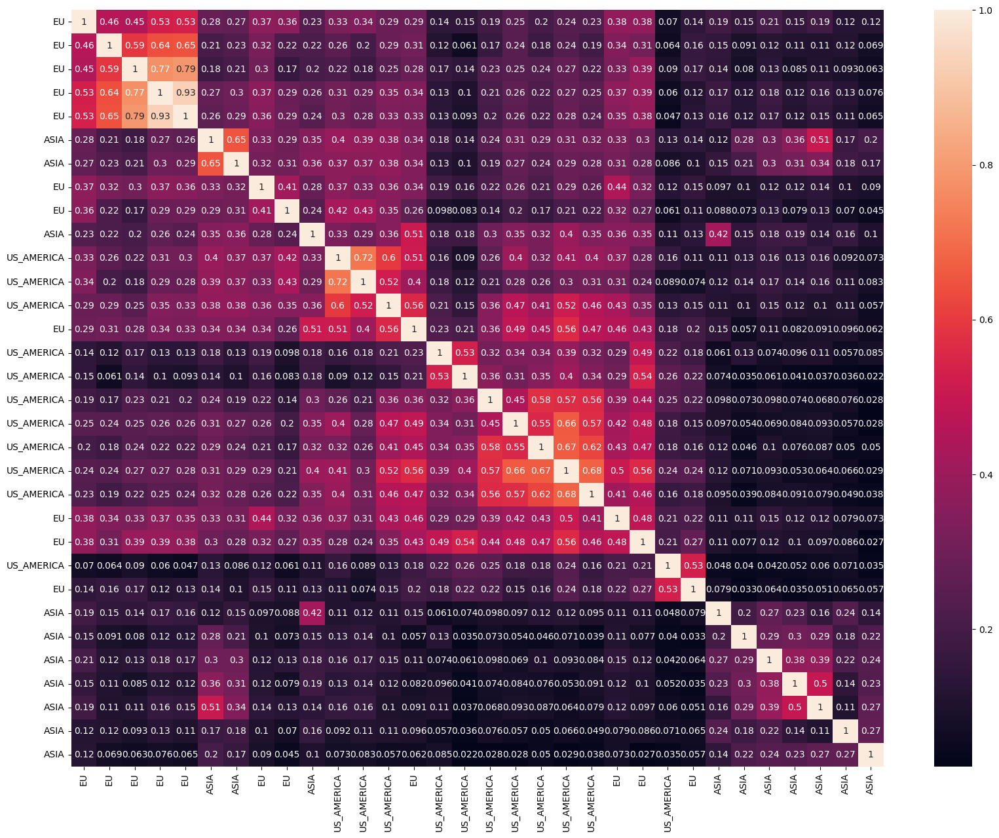

In [23]:
clustered_corr_regions = clustered_corr.data2d.copy()
clustered_corr_regions.index = [stocks_info.filter(pl.col("symbol")==stock).select("region").item() for stock in clustered_corr.data2d.index]
clustered_corr_regions.columns = [stocks_info.filter(pl.col("symbol")==stock).select("region").item() for stock in clustered_corr.data2d.columns]
plt.figure(figsize=(20,15))
sns.heatmap(clustered_corr_regions,annot=True)
plt.show()

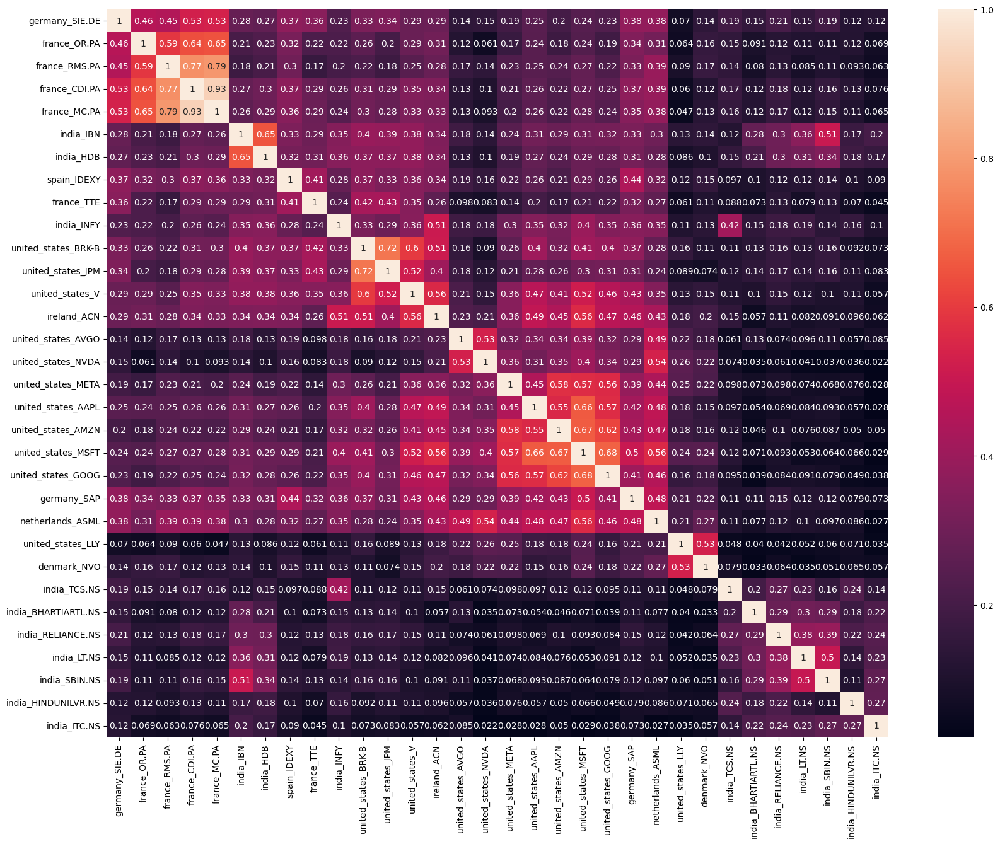

In [24]:
clustered_corr_countries = clustered_corr.data2d.copy()
clustered_corr_countries.index = [stocks_info.filter(pl.col("symbol")==stock).select("country").item() + "_" + stock for stock in clustered_corr.data2d.index]
clustered_corr_countries.columns = [stocks_info.filter(pl.col("symbol")==stock).select("country").item() + "_" + stock for stock in clustered_corr.data2d.columns]
plt.figure(figsize=(20,15))
sns.heatmap(clustered_corr_countries,annot=True)
plt.show()

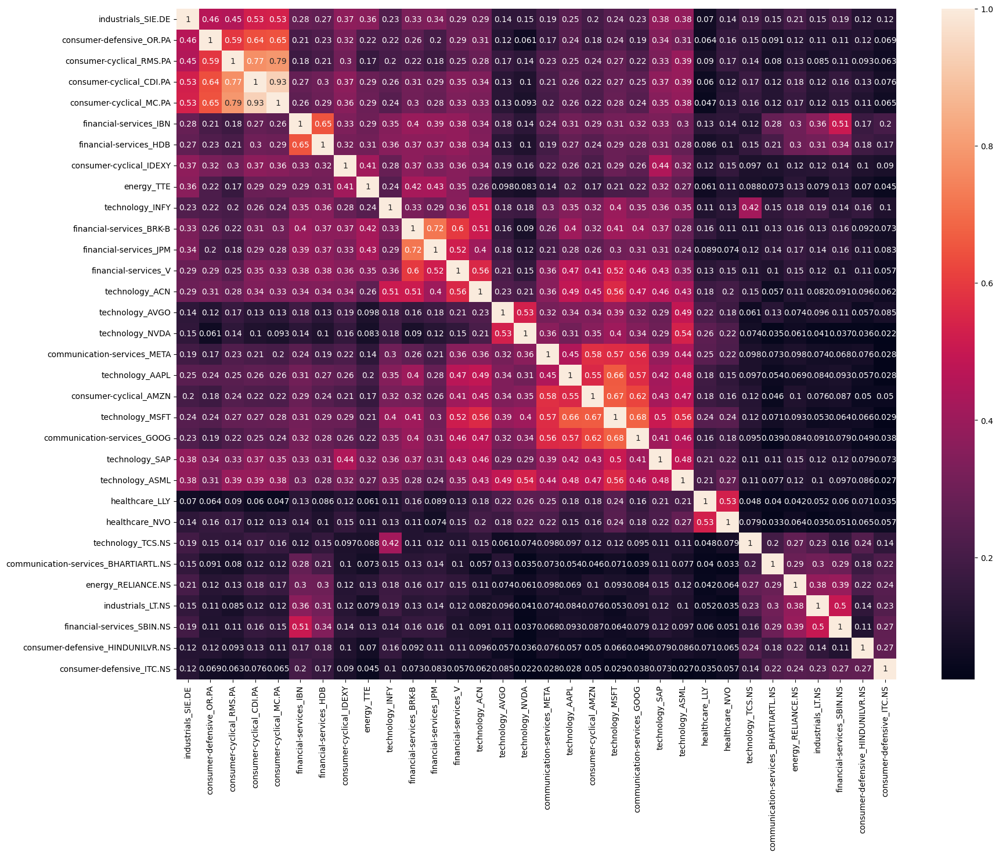

In [25]:
clustered_corr_sector = clustered_corr.data2d.copy()
clustered_corr_sector.index = [stocks_info.filter(pl.col("symbol")==stock).select("sector").item() + "_" + stock for stock in clustered_corr.data2d.index]
clustered_corr_sector.columns = [stocks_info.filter(pl.col("symbol")==stock).select("sector").item() + "_" + stock for stock in clustered_corr.data2d.columns]
plt.figure(figsize=(20,15))
sns.heatmap(clustered_corr_sector,annot=True)
plt.show()

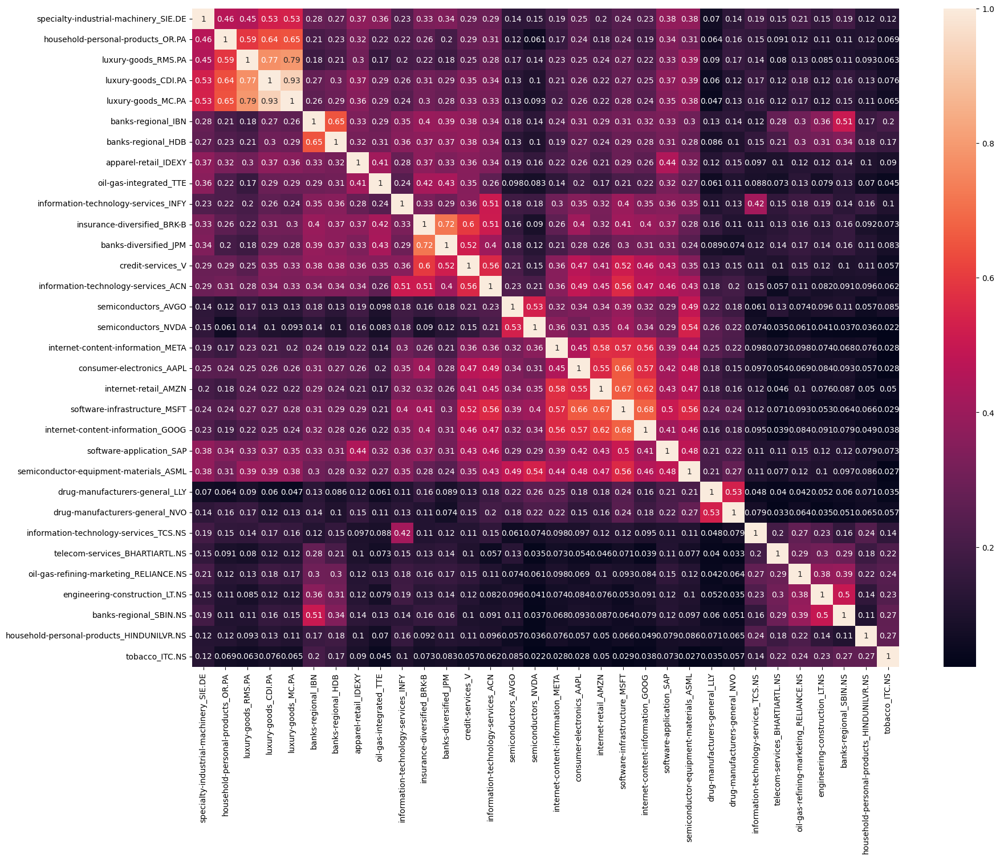

In [26]:
clustered_corr_industry = clustered_corr.data2d.copy()
clustered_corr_industry.index = [stocks_info.filter(pl.col("symbol")==stock).select("industry").item() + "_" + stock for stock in clustered_corr.data2d.index]
clustered_corr_industry.columns = [stocks_info.filter(pl.col("symbol")==stock).select("industry").item() + "_" + stock for stock in clustered_corr.data2d.columns]
plt.figure(figsize=(20,15))
sns.heatmap(clustered_corr_industry,annot=True)
plt.show()

As we can see by the heatmaps, grouped by regions, countries, sectors and industries, there is a high correlation among these categories. Stocks from the same countries are correlated, but the whole effect of this high correlations is not due to just that. Neighbor countries also bear association effects. The same is true for stocks from the same sector and industry. Therefore can extract that:
- Macroeconomical country speficic indicators can add valuable information to a stocks' prediction model. These can include indices like the SNP500 for the US, or EURONEXT for the whole EU or DAX as a country specific one representing the EU, or both for that matter. Additionally, political and economical indicators like the EuroYield can bring information into the table.
- Sector and industry specific information like sector specific indices can also add value about a more specific (and complementary to the region) context of the stock. 

News, and sentimentent that talk about these contexts would have the same role as the above mentioned indicators, although it demands more challenging integrations.

Finally, there are correlations that these industries, sectors or regions do not account for. Let's fuse the heatmap into one to illustrate the example:

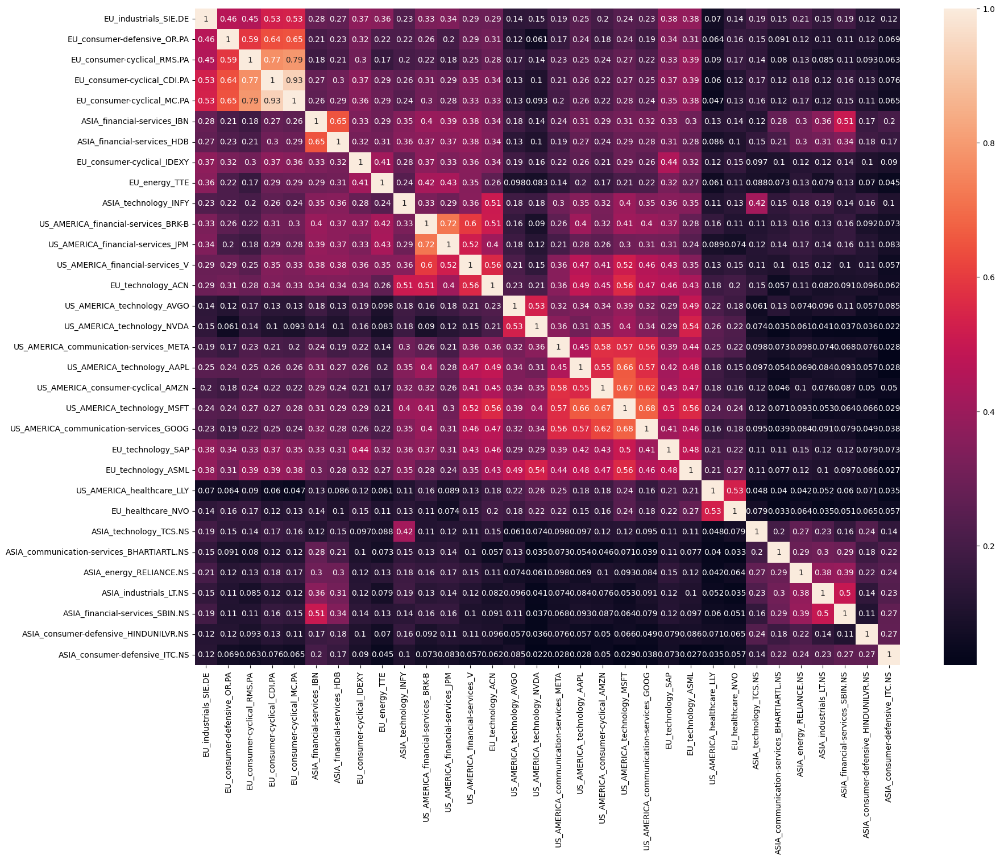

In [27]:
clustered_corr_sector_region = clustered_corr.data2d.copy()
clustered_corr_sector_region.index = [stocks_info.filter(pl.col("symbol")==stock).select("region").item() + "_" + 
                                        stocks_info.filter(pl.col("symbol")==stock).select("sector").item() + "_" + stock for stock in clustered_corr.data2d.index]
clustered_corr_sector_region.columns = [stocks_info.filter(pl.col("symbol")==stock).select("region").item() + "_" +
                                        stocks_info.filter(pl.col("symbol")==stock).select("sector").item() + "_" + stock for stock in clustered_corr.data2d.columns]
plt.figure(figsize=(20,15))
sns.heatmap(clustered_corr_sector_region ,annot=True)
plt.show()

To highlight an example; BRK-B, Berkshire Hathaway, has a considerable correlation with ACN, Accenture. Berkshire Hathaway comes from the US and Accenture supposedly comes from Ireland, but it was in reality originated in the US too. Their sectors are respectively Financial Services and Technology. This raises 2 points:
- The country of origin seems to create more association that they country of headquarter operation. However, the country headquarter operation bears an effect.
- Two seemingly unrelated sectors can be connected through partnerships by the services two companies lend to each other.
- Sector and industry categories can be helpful but restraining, as two categories or sectors can be related just not mathematically, but semantically. This link can be difficult to make straight away programatically for many stocks. 

This interplay between sectors, countries and especially partnerships, begs question to the fact that there is a very interconnected graph of lead-lag cause-effects between stocks that can be difficult to model through tabular data. Also, there might be significant effects in "events" that isn't captured here like X sued Y, product of Z is groundbreaking, etc, which typical impact can be more easily understandable by humans and cannot easily be modelled through a tabular data either. It is true that these events can be modeled through sentiment data, but sentiment itself is a reaction to the event, and modelling through it can be a loss of opportunities.

Anyhow, for now, the suggested approach is to:
- Group by correlated stocks. This way we can extract the implicit correlation accounted for regions, industries and partnerships.
- Add market, economical and political context information: Region, country, sector/industry.
- Later add news and sentiment about both the stock and their context.

Let's create groups of correlated stocks:

In [28]:
# threshold for the grouping
threshold = 0.3
adj_matrix = (clustered_corr.data2d >= threshold).astype(int)
np.fill_diagonal(adj_matrix.values, 0)  # Remove self-loops

# Create a graph from the adjacency matrix
G = nx.from_pandas_adjacency(adj_matrix)

# Find communities with overlapping allowed
communities = list(nx.algorithms.community.greedy_modularity_communities(G))

group_dict = {}
for i, community in enumerate(communities):
    print(f"Group {i+1}: {list(community)}")
    group_dict[f"group_{i+1}"] = [comm for comm in community]

Group 1: ['V', 'ASML', 'META', 'GOOG', 'AVGO', 'MSFT', 'NVDA', 'ACN', 'TCS.NS', 'AMZN', 'AAPL', 'INFY']
Group 2: ['BRK-B', 'IDEXY', 'CDI.PA', 'TTE', 'RMS.PA', 'JPM', 'SAP', 'OR.PA', 'SIE.DE', 'MC.PA']
Group 3: ['SBIN.NS', 'IBN', 'RELIANCE.NS', 'LT.NS', 'BHARTIARTL.NS', 'HDB']
Group 4: ['NVO', 'LLY']
Group 5: ['HINDUNILVR.NS']
Group 6: ['ITC.NS']


Groups 5 and 6 lack other stocks to group, so we can leave them out. Group 4 is made of just 2 stocks, but that is due to being the only ones from the healthcare sector. We can use them and see how well they behave together. Groups 1 to 3 have numerous connections to be modeled together.

### 2.2.2 Model subdivided groups

Hypothesis: Correlated stocks might share a common denominator for price movement, therefore modelling them together can:
- In the case of the recursive method, retain specificity of the model improving score while maintaining speed.
- In the case of the direct method, improve speed, remove useless columns and while allowing to introduce other exogenous series as another dependent series.

Get groups lags

In [29]:
group_lags_acf_dict = {}
group_lags_pacf_dict = {}
for group, tickers_list in group_dict.items():
    group_lags_acf_dict[group] = set()
    group_lags_pacf_dict[group] = set()
    for ticker in tickers_list:
        group_lags_acf_dict[group].update(top_lags_acf_dict[ticker])
        group_lags_pacf_dict[group].update(top_lags_pacf_dict[ticker])

    group_lags_acf_dict[group] = list(group_lags_acf_dict[group])
    group_lags_pacf_dict[group] = list(group_lags_pacf_dict[group])


group_lags_pacf_dict

NameError: name 'top_lags_acf_dict' is not defined

Empecemos modelando el grupo 1, 

In [30]:
xgb = XGBRegressor(random_state=8523, objective="reg:absoluteerror")
histb = HistGradientBoostingRegressor(random_state=8523, loss="absolute_error")

Trying with the direct approach:

In [43]:
data = dataframe_simple_pivot.asfreq("B").interpolate()

targets = data.columns.to_list()
data

,AMZN,MC.PA,LT.NS,META,TTE,ITC.NS,RMS.PA,IDEXY,AAPL,CDI.PA,...,NVDA,BHARTIARTL.NS,INFY,RELIANCE.NS,HINDUNILVR.NS,JPM,TCS.NS,AVGO,ACN,OR.PA
datetime,,,,,,,,,,,,,,,,,,,,,
1972-06-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1972-06-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1972-06-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1972-06-06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1972-06-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-01-24,234.850006,734.099976,3458.199951,647.489990,58.730000,441.600006,2662.0,25.559999,222.779999,674.0,...,142.619995,1644.800049,21.680000,1246.300049,2368.100098,264.839996,4152.350098,244.699997,362.410004,358.450012
2025-01-27,235.419998,754.799988,3457.649902,659.880005,58.919998,440.100006,2662.0,25.559999,229.860001,691.5,...,118.419998,1602.599976,21.540001,1229.349976,2392.850098,265.850006,4065.149902,202.130005,373.149994,363.149994
2025-01-28,238.149994,750.599976,3413.899902,674.330017,58.130001,435.450012,2662.0,26.200001,238.259995,691.5,...,128.990005,1618.349976,21.530001,1234.400024,2388.850098,267.140015,4040.300049,207.360001,378.390015,367.600006


In [ ]:
direct_multiseries_args = {
    'dataframe': data,
    "start_train": "2012-06-04",
    "end_val": "2022-05-27",
    "end_test": "2025-01-17",
    "model": histb,
    "forecast_horizon": 5,
    "target_list": targets,
    "predictors_list": targets,
    # "exog_features": None,
    "window_stats": ['mean'],
    "window_sizes": [3,5,7,14],
    "lags": [1,2,4,5,6,7,10,14],
    "differentiation": 1
    
}

direct_series_results, forecasters_direct = evaluate_direct_multiseries(**direct_multiseries_args)

Initial train size starts on 2012-05-28 (Monday) and ends on 2022-05-27 (Friday).


  0%|          | 0/32 [00:00<?, ?it/s]/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/model_selection/_validation.py:644: LongTrainingWarning: The forecaster will be fit 85 times (17 folds * 5 regressors). This can take substantial amounts of time. If not feasible, try with `refit = False`.
 
 You can suppress this warning using: warnings.simplefilter('ignore', category=LongTrainingWarning)
  warnings.warn(
  0%|          | 0/32 [00:17<?, ?it/s]


KeyboardInterrupt: 

Checking the direct approach's results:

The mean MAPE for uniseries is 0.023776

In [126]:
print(f"The mean MAPE for uniseries is {direct_series_mape['mean_absolute_percentage_error'].mean():.6f}")
direct_series_mape

The mean MAPE for uniseries is 0.038834


,levels,mean_absolute_percentage_error
0,NVDA,0.038834


Now let's try out with the independent recursive approach:

In [142]:
forecast_horizon = 5
initial_train_size = len(data.loc[start_train:end_val])
# Define the forecaster. 
window_features = RollingFeatures(stats=['mean']*len([3,5,7,14]), window_sizes=[3,5,7,14])
forecaster_ms_1 = ForecasterRecursiveMultiSeries(
                    regressor       = histb,
                    lags            = [1,2,4,5,6,7,10,14], 
                    transformer_series = StandardScaler(),
                    window_features=window_features,
                    differentiation=1
                )

forecaster_ms_1.fit(series=data.loc[start_train:end_val,], exog=None, suppress_warnings=True)
display(forecaster_ms_1)

# Backtesitng 
cv = TimeSeriesFold(
            steps              = forecast_horizon,
            initial_train_size = initial_train_size,
            refit              = 8,
            fixed_train_size   = True,
            differentiation=1
         )

multi_series_mape_subdivided, predictions_subdivided = backtesting_forecaster_multiseries(
                                       forecaster            = forecaster_ms_1,
                                       series                = data.loc[start_train:end_test,group_dict["group_1"]], 
                                       levels                = group_dict["group_1"],
                                       cv                    = cv,
                                       metric                = 'mean_absolute_percentage_error',
                                       add_aggregated_metric = False,
                                       verbose               = False,
                                       show_progress         = True,
                                       n_jobs=6
                                   )   
# Resultados
display(multi_series_mape_subdivided)
print(f"Mean MAPE error accross series is {multi_series_mape_subdivided['mean_absolute_percentage_error'].mean():.4f}")

print('')
display(predictions_subdivided)

============================== 
ForecasterRecursiveMultiSeries 
============================== 
Regressor: HistGradientBoostingRegressor 
Lags: [ 1  2  4  5  6  7 10 14] 
Window features: ['roll_mean_3', 'roll_mean_5', 'roll_mean_7', 'roll_mean_14'] 
Window size: 15 
Series encoding: ordinal 
Series names (levels): 
    AMZN, NVDA, NVO, OR.PA, SIE.DE, LLY, BHARTIARTL.NS, MSFT, IDEXY, HINDUNILVR.NS,
    V, ACN, IBN, META, CDI.PA, ASML, GOOG, RELIANCE.NS, HDB, MC.PA, TTE, AVGO,
    SAP, INFY, RMS.PA, TCS.NS, BRK-B, ITC.NS, AAPL, SBIN.NS, LT.NS, JPM 
Exogenous included: False 
Exogenous names: None 
Transformer for series: StandardScaler() 
Transformer for exog: None 
Weight function included: False 
Series weights: None 
Differentiation order: 1 
Training range: 
    'AMZN': ['2012-05-28', '2022-05-27'], 'NVDA': ['2012-05-28', '2022-05-27'],
    'NVO': ['2012-05-28', '2022-05-27'], 'OR.PA': ['2012-05-28', '2022-05-27'],
    'SIE.DE': ['2012-05-28', '2022-05-27'], ..., 'ITC.NS': ['2012-05-28',
    '2022-05-27'], 'AAPL': ['2012-05-28', '2022-05-27'], 'SBIN.NS':
    ['2012-05-28', '2022-05-27'], 'LT.NS': ['2012-05-28', '2022-05-27'], 'JPM':
    ['2012-05-28', '2022-05-27'] 
Training index type: DatetimeIndex 
Training index frequency: B 
Regressor parameters: 
    {'categorical_features': 'warn', 'early_stopping': 'auto', 'interaction_cst':
    None, 'l2_regularization': 0.0, 'learning_rate': 0.1, 'loss':
    'absolute_error', 'max_bins': 255, 'max_depth': None, 'max_features': 1.0,
    'max_iter': 100, 'max_leaf_nodes': 31, 'min_samples_leaf': 20,
    'monotonic_cst': None, 'n_iter_no_change': 10, 'quantile': None,
    'random_state': 8523, 'scoring': 'loss', 'tol': 1e-07,
    'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False} 
fit_kwargs: {} 
Creation date: 2025-02-02 15:48:05 
Last fit date: 2025-02-02 15:48:05 
Skforecast version: 0.14.0 
Python version: 3.10.12 
Forecaster id: None

/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/model_selection/_validation.py:577: IgnoredArgumentWarning: If `refit` is an integer other than 1 (intermittent refit). `n_jobs` is set to 1 to avoid unexpected results during parallelization. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=IgnoredArgumentWarning)
  warnings.warn(


  0%|          | 0/138 [00:00<?, ?it/s]

,levels,mean_absolute_percentage_error
0,NVDA,0.038924
1,ASML,0.031363
2,AVGO,0.029019
3,META,0.029177
4,GOOG,0.024902
5,INFY,0.017812
6,TCS.NS,0.015489
7,V,0.015149
8,MSFT,0.019262
9,AAPL,0.018868


Mean MAPE error accross series is 0.0237



,NVDA,ASML,AVGO,META,GOOG,INFY,TCS.NS,V,MSFT,AAPL,AMZN,ACN
2022-05-30,18.709247,569.532014,54.701868,193.703695,111.673174,17.593217,3030.039325,207.974744,267.545405,147.102501,115.018459,292.148541
2022-05-31,18.619240,569.154219,54.603710,192.585784,111.509382,17.477486,3030.285469,208.090679,266.909508,146.363572,114.550780,292.482757
2022-06-01,18.775343,571.625898,54.741229,193.808171,113.779527,17.518181,3033.610077,210.384481,269.321057,148.296088,115.217996,293.880238
2022-06-02,18.835717,572.869528,54.968213,194.003847,114.076068,17.570561,3050.910758,210.582044,270.367396,148.210996,115.226597,292.840996
2022-06-03,18.918175,573.118994,55.036023,194.217716,114.230261,17.544612,3048.966540,210.714974,270.310929,148.080115,115.419783,292.406117
...,...,...,...,...,...,...,...,...,...,...,...,...
2025-01-13,135.712833,738.654135,224.306340,615.278877,193.272507,22.718781,4204.095740,308.029655,419.555833,237.563059,219.068107,350.003478
2025-01-14,135.809412,741.089631,224.893058,615.404377,193.702231,22.723527,4217.505045,308.404162,420.804746,238.059707,219.415040,349.502421
2025-01-15,135.891610,742.107906,225.080468,615.829054,193.876656,22.731956,4220.224396,308.785953,421.319400,238.672656,219.625116,349.723045
2025-01-16,136.014266,742.245904,225.446205,616.063939,193.958974,22.745195,4221.609014,309.334215,421.576915,239.000028,219.714399,349.904359


In [96]:
comparison = direct_series_mape.merge(multi_series_mape_subdivided, on="levels", suffixes=("_direct_dependent",f"_multiseries"), how="left")
comparison.columns = ["levels","direct","recursive"]
comparison["diff_direct_recursive"] = comparison["direct"] - comparison["recursive"] 
comparison.agg({"direct":"mean","recursive":"mean","diff_direct_recursive":"sum"})

direct                   0.026403
recursive                0.026875
diff_direct_recursive   -0.005663
dtype: float64

Analyzing the results, we can see that the direct method and the recursive are still comparable, being the recursive much faster. What is different between the two is probably the fact that the direct method adds each lagged series as a column, while the recursive simply adds more rows to the dataset, bringing in more examples to the model at the cost of more generalization and losing specific details. For this particular case, the recursive method is prerrable, given its maintainability and speed.

Nevertheless, the are still a few approaches to test to decide for a type of model:
- Adding exogenous features and observing effects for both models
- Choosing based on a different grouping method (different corr threshold, cross-correlation matrix, clustering)

Let us proceed with them.

### 2.2.2 Refine choice of lags and window stats

In [11]:
data = dataframe_simple_pivot.asfreq("B").ffill()
start_train = "2012-06-04"
end_train = '2018-05-25'
end_val = '2022-05-27'
end_test = '2025-01-17'

data = data.loc[start_train:end_test]
targets = data.columns.to_list()
data

,RELIANCE.NS,OR.PA,BHARTIARTL.NS,SAP,MSFT,LT.NS,INFY,ASML,AMZN,LLY,...,NVO,IBN,META,RMS.PA,IDEXY,MC.PA,AAPL,TTE,GOOG,HDB
datetime,,,,,,,,,,,,,,,,,,,,,
2012-06-04,136.129669,71.648102,248.075684,45.565060,22.821466,429.666351,3.916655,31.231913,10.728500,30.300695,...,10.449979,4.627400,26.797632,230.209900,5.912484,89.011795,17.000183,20.149734,14.359140,12.947585
2012-06-05,138.055435,71.835083,241.885376,45.795307,22.789501,443.451630,3.971704,32.055866,10.660500,30.655392,...,10.477151,4.655266,25.771557,228.936996,5.894315,90.446182,16.956202,20.286913,14.156135,12.947585
2012-06-06,140.678787,72.973282,250.391785,47.308395,23.460953,463.955566,4.124002,33.625641,10.882000,30.949724,...,10.828815,4.929010,26.707975,233.710342,6.076012,94.231384,17.216188,20.750452,14.408279,13.718439
2012-06-07,141.730087,73.704964,253.929123,46.708088,23.365038,466.829712,4.025835,33.583015,10.940000,31.145927,...,10.823222,4.935565,26.209879,239.301926,6.163229,96.422806,17.224031,20.641651,14.350207,14.175412
2012-06-08,143.390579,74.249657,256.245270,47.127480,23.700762,479.443237,4.001979,34.016304,10.924000,31.342155,...,10.633802,4.947040,26.996874,235.165024,6.112353,95.107956,17.483120,20.599087,14.405301,13.958466
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-01-13,1239.849976,328.399994,1597.199951,249.529999,417.190002,3464.300049,22.690001,727.409973,218.460007,797.479980,...,84.620003,28.309999,608.330017,2353.000000,25.080000,646.400024,234.399994,56.810001,192.289993,58.060001
2025-01-14,1238.750000,326.649994,1600.099976,253.500000,415.670013,3462.600098,22.510000,736.289978,217.759995,744.909973,...,81.180000,28.440001,594.250000,2359.000000,25.360001,651.000000,233.279999,57.560001,191.050003,58.529999
2025-01-15,1252.199951,329.500000,1607.449951,261.790009,426.309998,3501.399902,22.889999,726.299988,223.350006,746.739990,...,82.919998,28.680000,617.119995,2364.000000,25.799999,637.200012,237.869995,57.680000,196.979996,59.160000


In [12]:
from itertools import chain

window_stats = ["mean","std","min","max","ratio_min_max","coef_variation"]
window_sizes = [2,3,4,5,6,7,8,9,10,13,15,22]


repeated_window_sizes = list(chain.from_iterable([[size] * len(window_stats) for size in window_sizes]))
repeated_window_stats = window_stats * len(window_sizes)

In [13]:
from sklearn.model_selection import TimeSeriesSplit

# Define a time-aware cross-validation strategy
cv = TimeSeriesSplit(n_splits=5)

In [14]:
histb = HistGradientBoostingRegressor(random_state=8523, loss="absolute_error")

In [20]:
from sklearn.feature_selection import SequentialFeatureSelector
from sklearn.model_selection import ShuffleSplit
from skforecast.feature_selection import select_features
from skforecast.feature_selection import select_features_multiseries

# Create forecaster
# ==============================================================================
# Define the forecaster. 

window_features = RollingFeatures(stats=repeated_window_stats, window_sizes=repeated_window_sizes)
forecaster_select = ForecasterRecursiveMultiSeries(
                    regressor       = histb,
                    lags            = [1,2,3,4,5,6,7,8,9,10,13,15,22,66,126,252], 
                    window_features=window_features,
                    differentiation=1,
                    differentiator="pct"
                )

forecaster_select.dropna_from_series = True

cv = TimeSeriesSplit(n_splits=5)
selector = SequentialFeatureSelector(
               estimator            = forecaster_select.regressor,
               n_features_to_select = 10,
               direction            = "forward",
               cv                   = cv,
               scoring              = "neg_mean_absolute_percentage_error",
               n_jobs               = 6,
           )

selected_lags, selected_window_features, selected_exog = select_features_multiseries(
    forecaster   = forecaster_select,
    selector     = selector,
    series       = data,
    exog         = None,
    select_only  = 'autoreg',
    subsample    = 0.5,
    random_state = 123,
    verbose      = True,
)



Using pct differentiator
Centered around 1
[       nan 0.98763318 1.03130398 ... 1.00213267 0.98820059 1.00383795]
[       nan 0.99741288 1.01533285 ... 1.01967591 0.95959978 1.00753527]
[       nan 0.99447068 1.02085004 ... 1.00211954 1.04906937 1.00403226]
[       nan 1.00260021 1.03356481 ... 1.02143382 1.00180899 0.94727342]
[       nan 0.98174711 1.03829143 ... 1.00171782 0.98971076 1.01698049]
[       nan 1.         1.05953651 ... 1.01076373 0.99121027 0.99590727]
[       nan 0.99366167 1.02077768 ... 1.02567052 0.98795611 1.02392821]
[       nan 1.01414656 1.01900216 ... 1.01085768 1.01137997 1.02834697]
[       nan 1.01611457 1.04185032 ... 0.97880186 1.09149402 0.99223577]
[       nan 1.01104787 1.02960877 ... 1.00212046 1.00237322 1.00579073]
[       nan 0.9750467  1.03516711 ... 1.00459345 1.01415285 0.99834379]
[       nan 1.00505316 1.03304025 ... 1.0327022  0.99919775 1.00477865]
[       nan 1.01170588 1.00960133 ... 1.0024567  1.0145432  0.95791974]
[       nan 1.0180364

Number of features selected: 10
- Lags            (n=6) : [1, 3, 6, 9, 10, 13]
- Window features (n=4) : ['roll_ratio_min_max_2', 'roll_mean_5', 'roll_mean_15', 'roll_std_15']
- Exog            (n=0) : []

In [95]:
from sklearn.feature_selection import SequentialFeatureSelector
from sklearn.model_selection import ShuffleSplit
from skforecast.feature_selection import select_features
from skforecast.feature_selection import select_features_multiseries

# Create forecaster
# ==============================================================================
# Define the forecaster. 

window_features = RollingFeatures(stats=repeated_window_stats, window_sizes=repeated_window_sizes)
forecaster_select = ForecasterRecursiveMultiSeries(
                    regressor       = histb,
                    lags            = [1,2,3,4,5,6,7,8,9,10,13,15,22,66,126,252], 
                    window_features=window_features,
                    differentiation=1,
                    differentiator="pct"
                )

forecaster_select.dropna_from_series = True

cv = TimeSeriesSplit(n_splits=5)
selector = SequentialFeatureSelector(
               estimator            = forecaster_select.regressor,
               n_features_to_select = 30,
               direction            = "forward",
               cv                   = cv,
               scoring              = "neg_mean_absolute_percentage_error",
               n_jobs               = 6,
           )

selected_lags, selected_window_features, selected_exog = select_features_multiseries(
    forecaster   = forecaster_select,
    selector     = selector,
    series       = data,
    exog         = None,
    select_only  = 'autoreg',
    subsample    = 0.5,
    random_state = 123,
    verbose      = True,
)



Recursive feature elimination (SequentialFeatureSelector)
---------------------------------------------------------
Total number of records available: 97344
Total number of records used for feature selection: 48672
Number of features available: 88
    Lags            (n=16)
    Window features (n=72)
    Exog            (n=0)
Number of features selected: 30
    Lags            (n=10) : [1, 3, 5, 6, 7, 8, 13, 15, 22, 126]
    Window features (n=20) : ['roll_mean_2', 'roll_coef_variation_2', 'roll_min_3', 'roll_mean_4', 'roll_coef_variation_4', 'roll_mean_5', 'roll_coef_variation_5', 'roll_std_6', 'roll_mean_7', 'roll_std_7', 'roll_mean_8', 'roll_std_9', 'roll_min_9', 'roll_std_10', 'roll_mean_13', 'roll_max_13', 'roll_mean_15', 'roll_std_15', 'roll_ratio_min_max_15', 'roll_ratio_min_max_22']
    Exog            (n=0) : []


    Lags            (n=10) : [1, 3, 5, 6, 7, 8, 13, 15, 22, 126]
    Window features (n=20) : ['roll_mean_2', 'roll_coef_variation_2', 'roll_min_3', 'roll_mean_4', 'roll_coef_variation_4', 'roll_mean_5', 'roll_coef_variation_5', 'roll_std_6', 'roll_mean_7', 'roll_std_7', 'roll_mean_8', 'roll_std_9', 'roll_min_9', 'roll_std_10', 'roll_mean_13', 'roll_max_13', 'roll_mean_15', 'roll_std_15', 'roll_ratio_min_max_15', 'roll_ratio_min_max_22'

window_features = RollingFeatures(stats=["mean","coef_variation","min","mean","coef_variation","mean","coef_variation","std","mean","std",'mean', 
                                         'std', 'min', 'std', 'mean', 'max', 'mean', 'std',  'ratio_min_max', 'ratio_min_max'],
                                   window_sizes=[2,2,3,4,4,5,5,6,7,7,8,9,9,10,13,13,15,15,15,22])

lags = [1, 3, 5, 6, 7, 8, 13, 15, 22, 126]

In [97]:
forecast_horizon = 5
initial_train_size = len(data.loc[start_train:end_val])
print(f"Initial train size: {initial_train_size}")

targets = dataframe_simple_pivot.columns.to_list()
# Define the forecaster. 
window_features = RollingFeatures(stats=["ratio_min_max","mean","mean","std"],
                                   window_sizes=[2,5,15,15])

lags = [1, 3, 6, 9, 10, 13]
forecaster_ms_1 = ForecasterRecursiveMultiSeries(
                    regressor       = histb,
                    lags            = lags, 
                    transformer_series = StandardScaler(),
                    window_features=window_features,
                    differentiation=1,
                    differentiator="pct"
                )

forecaster_ms_1.dropna_from_series=True
forecaster_ms_1.fit(series=data.loc[start_train:end_val,targets], exog=None, suppress_warnings=True)
display(forecaster_ms_1)

# Backtesitng 
cv = TimeSeriesFold(
            steps              = forecast_horizon,
            initial_train_size = initial_train_size,
            refit              = 8,
            fixed_train_size   = True,
            differentiation=1
         )

multi_series_mape_subdivided, predictions_subdivided = backtesting_forecaster_multiseries(
                                       forecaster            = forecaster_ms_1,
                                       series                = data.loc[start_train:end_test,targets], 
                                       levels                = targets,
                                       cv                    = cv,
                                       exog                  = None,
                                       metric                = 'mean_absolute_percentage_error',
                                       add_aggregated_metric = False,
                                       verbose               = False,
                                       show_progress         = True,
                                       n_jobs=6
                                   )   
# Resultados
display(multi_series_mape_subdivided)
print(f"Mean MAPE error accross series is {multi_series_mape_subdivided['mean_absolute_percentage_error'].mean():.4f}")

print('')
display(predictions_subdivided)

Initial train size: 2605


============================== 
ForecasterRecursiveMultiSeries 
============================== 
Regressor: HistGradientBoostingRegressor 
Lags: [ 1  3  6  9 10 13] 
Window features: ['roll_ratio_min_max_2', 'roll_mean_5', 'roll_mean_15', 'roll_std_15'] 
Window size: 16 
Series encoding: ordinal 
Series names (levels): 
    RELIANCE.NS, OR.PA, BHARTIARTL.NS, SAP, MSFT, LT.NS, INFY, ASML, AMZN, LLY,
    BRK-B, HINDUNILVR.NS, SBIN.NS, AVGO, V, ACN, CDI.PA, SIE.DE, ITC.NS, NVDA,
    TCS.NS, JPM, NVO, IBN, META, RMS.PA, IDEXY, MC.PA, AAPL, TTE, GOOG, HDB 
Exogenous included: False 
Exogenous names: None 
Transformer for series: StandardScaler() 
Transformer for exog: None 
Weight function included: False 
Series weights: None 
Differentiation order: 1 
Training range: 
    'RELIANCE.NS': ['2012-06-04', '2022-05-27'], 'OR.PA': ['2012-06-04',
    '2022-05-27'], 'BHARTIARTL.NS': ['2012-06-04', '2022-05-27'], 'SAP':
    ['2012-06-04', '2022-05-27'], 'MSFT': ['2012-06-04', '2022-05-27'], ...,
    'MC.PA': ['2012-06-04', '2022-05-27'], 'AAPL': ['2012-06-04', '2022-05-27'],
    'TTE': ['2012-06-04', '2022-05-27'], 'GOOG': ['2012-06-04', '2022-05-27'],
    'HDB': ['2012-06-04', '2022-05-27'] 
Training index type: DatetimeIndex 
Training index frequency: B 
Regressor parameters: 
    {'categorical_features': 'warn', 'early_stopping': 'auto', 'interaction_cst':
    None, 'l2_regularization': 0.0, 'learning_rate': 0.1, 'loss':
    'absolute_error', 'max_bins': 255, 'max_depth': None, 'max_features': 1.0,
    'max_iter': 100, 'max_leaf_nodes': 31, 'min_samples_leaf': 20,
    'monotonic_cst': None, 'n_iter_no_change': 10, 'quantile': None,
    'random_state': 8523, 'scoring': 'loss', 'tol': 1e-07,
    'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False} 
fit_kwargs: {} 
Creation date: 2025-02-03 16:46:55 
Last fit date: 2025-02-03 16:46:55 
Skforecast version: 0.14.0 
Python version: 3.10.12 
Forecaster id: None

/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/model_selection/_validation.py:577: IgnoredArgumentWarning: If `refit` is an integer other than 1 (intermittent refit). `n_jobs` is set to 1 to avoid unexpected results during parallelization. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=IgnoredArgumentWarning)
  warnings.warn(


  0%|          | 0/138 [00:00<?, ?it/s]

,levels,mean_absolute_percentage_error
0,RELIANCE.NS,0.015672
1,OR.PA,0.015932
2,BHARTIARTL.NS,0.015363
3,SAP,0.020753
4,MSFT,0.019016
5,LT.NS,0.017390
6,INFY,0.017240
7,ASML,0.030173
8,AMZN,0.023883
9,LLY,0.021685


Mean MAPE error accross series is 0.0202



,RELIANCE.NS,OR.PA,BHARTIARTL.NS,SAP,MSFT,LT.NS,INFY,ASML,AMZN,LLY,...,NVO,IBN,META,RMS.PA,IDEXY,MC.PA,AAPL,TTE,GOOG,HDB
2022-05-30,1173.439910,310.611409,674.337183,98.385746,267.610091,1551.907273,17.553171,569.910190,115.224046,316.230925,...,52.340985,18.917833,194.449260,1078.082822,10.914008,569.266215,147.702292,50.162025,112.400297,58.267269
2022-05-31,1173.453407,310.629883,674.316693,98.385938,267.745546,1553.269222,17.548648,569.268281,115.242811,315.979414,...,52.297433,18.915997,194.453824,1078.809440,10.920484,569.566775,147.800547,50.125079,112.436148,58.238941
2022-06-01,1172.850814,310.712925,674.071344,98.398887,267.703040,1553.425832,17.541633,568.975197,115.417323,315.798679,...,52.275390,18.915720,194.522424,1077.795449,10.929173,570.136660,147.753958,50.099440,112.397675,58.224788
2022-06-02,1172.519932,310.680490,673.862230,98.349426,267.646383,1554.424435,17.531213,568.712468,115.543534,315.715353,...,52.271033,18.916489,194.570885,1077.461388,10.938226,569.857505,147.659852,50.070017,112.340567,58.224631
2022-06-03,1171.234408,310.623593,673.599676,98.303300,267.530669,1554.601900,17.524783,568.577445,115.607365,315.527132,...,52.255171,18.915235,194.619395,1077.147495,10.945508,569.454547,147.585602,50.048166,112.301012,58.244731
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-01-13,1241.588510,327.711576,1615.099732,251.417158,418.776155,3538.005830,22.681726,738.830236,218.853616,799.658366,...,86.308176,28.507111,615.656641,2364.615316,25.631939,644.759280,236.745366,56.718633,193.063811,58.692487
2025-01-14,1240.729069,327.740225,1614.445268,251.293583,418.625140,3538.603123,22.679975,737.810114,218.765829,799.115401,...,86.303720,28.490773,615.275342,2363.031173,25.621707,645.025932,236.627001,56.712659,192.985888,58.767360
2025-01-15,1241.041251,327.922473,1613.756606,251.164322,418.420103,3539.900536,22.666039,737.311772,218.783886,798.609452,...,86.269775,28.476582,614.857911,2361.543479,25.610894,645.203640,236.582199,56.693907,192.905723,58.844747
2025-01-16,1241.048678,327.822107,1613.256983,251.048513,418.228746,3540.410633,22.654168,737.681658,218.813458,798.103956,...,86.199182,28.466934,614.511454,2358.427212,25.606167,645.028238,236.515744,56.675177,192.849754,58.960933


### 2.2.3 Add exogenous features

Continuouing with group_1 to maintain a small group to compare scores from, we can proceed to add additional characteristics. 

Exogenous features can be added in a variety of ways. Let's start simple to compare results step by step.

In [31]:
data = dataframe_simple_pivot.asfreq("B").interpolate()
start_train = "2012-06-04"
end_train = '2018-05-25'
end_val = '2022-05-27'
end_test = '2025-01-17'

data = data.loc[start_train:end_test]
targets = data.columns.to_list()
data

,RELIANCE.NS,OR.PA,BHARTIARTL.NS,SAP,MSFT,LT.NS,INFY,ASML,AMZN,LLY,...,NVO,IBN,META,RMS.PA,IDEXY,MC.PA,AAPL,TTE,GOOG,HDB
datetime,,,,,,,,,,,,,,,,,,,,,
2012-06-04,136.129669,71.648102,248.075684,45.565060,22.821466,429.666351,3.916655,31.231913,10.728500,30.300695,...,10.449979,4.627400,26.797632,230.209900,5.912484,89.011795,17.000183,20.149734,14.359140,12.947585
2012-06-05,138.055435,71.835083,241.885376,45.795307,22.789501,443.451630,3.971704,32.055866,10.660500,30.655392,...,10.477151,4.655266,25.771557,228.936996,5.894315,90.446182,16.956202,20.286913,14.156135,12.947585
2012-06-06,140.678787,72.973282,250.391785,47.308395,23.460953,463.955566,4.124002,33.625641,10.882000,30.949724,...,10.828815,4.929010,26.707975,233.710342,6.076012,94.231384,17.216188,20.750452,14.408279,13.718439
2012-06-07,141.730087,73.704964,253.929123,46.708088,23.365038,466.829712,4.025835,33.583015,10.940000,31.145927,...,10.823222,4.935565,26.209879,239.301926,6.163229,96.422806,17.224031,20.641651,14.350207,14.175412
2012-06-08,143.390579,74.249657,256.245270,47.127480,23.700762,479.443237,4.001979,34.016304,10.924000,31.342155,...,10.633802,4.947040,26.996874,235.165024,6.112353,95.107956,17.483120,20.599087,14.405301,13.958466
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-01-13,1239.849976,328.399994,1597.199951,249.529999,417.190002,3464.300049,22.690001,727.409973,218.460007,797.479980,...,84.620003,28.309999,608.330017,2353.000000,25.080000,646.400024,234.399994,56.810001,192.289993,58.060001
2025-01-14,1238.750000,326.649994,1600.099976,253.500000,415.670013,3462.600098,22.510000,736.289978,217.759995,744.909973,...,81.180000,28.440001,594.250000,2359.000000,25.360001,651.000000,233.279999,57.560001,191.050003,58.529999
2025-01-15,1252.199951,329.500000,1607.449951,261.790009,426.309998,3501.399902,22.889999,726.299988,223.350006,746.739990,...,82.919998,28.680000,617.119995,2364.000000,25.799999,637.200012,237.869995,57.680000,196.979996,59.160000


#### Calendar features

First, let's add exogenous featrues extracted from the datetime index. That is day of the week, month, year and also the cyclical ones.

In [32]:
data_calendar_cyclical = data.copy()
original_columns = data_calendar_cyclical.columns
data_calendar_cyclical = get_calendar_cyclical_features(data_calendar_cyclical)
exog_features = data_calendar_cyclical.columns.difference(original_columns).to_list()

Recursive:

In [47]:
group_dict["group_1"]

['V',
 'ASML',
 'META',
 'GOOG',
 'AVGO',
 'MSFT',
 'NVDA',
 'ACN',
 'TCS.NS',
 'AMZN',
 'AAPL',
 'INFY']

In [51]:
forecast_horizon = 5
initial_train_size = len(data.loc[start_train:end_val])
targets = group_dict["group_1"]
print(f"Initial train size: {initial_train_size}")

# Define the forecaster. 
window_features = RollingFeatures(stats=["ratio_min_max","mean","mean","std"],
                                   window_sizes=[2,5,15,15])

lags = [1, 3, 6, 9, 10, 13]
forecaster_ms_1 = ForecasterRecursiveMultiSeries(
                    regressor       = histb,
                    lags            = lags, 
                    transformer_series = StandardScaler(),
                    window_features=window_features,
                    differentiation=1,
                    differentiator="pct"
                )

forecaster_ms_1.dropna_from_series=True
forecaster_ms_1.fit(series=data_calendar_cyclical.loc[start_train:end_val,targets], exog=data_calendar_cyclical.loc[start_train:end_val,exog_features], suppress_warnings=True)
display(forecaster_ms_1)

# Backtesitng 
cv = TimeSeriesFold(
            steps              = forecast_horizon,
            initial_train_size = initial_train_size,
            refit              = 8,
            fixed_train_size   = True,
            differentiation=1
         )

multi_series_mape_subdivided, predictions_subdivided = backtesting_forecaster_multiseries(
                                       forecaster            = forecaster_ms_1,
                                       series                = data_calendar_cyclical.loc[start_train:end_test,targets], 
                                       levels                = targets,
                                       cv                    = cv,
                                       exog                  = data_calendar_cyclical.loc[start_train:end_test,exog_features],
                                       metric                = 'mean_absolute_percentage_error',
                                       add_aggregated_metric = False,
                                       verbose               = False,
                                       show_progress         = True,
                                       n_jobs=6
                                   )   
# Resultados
display(multi_series_mape_subdivided)
print(f"Mean MAPE error accross series is {multi_series_mape_subdivided['mean_absolute_percentage_error'].mean():.4f}")

print('')
display(predictions_subdivided)

Initial train size: 2605


============================== 
ForecasterRecursiveMultiSeries 
============================== 
Regressor: HistGradientBoostingRegressor 
Lags: [ 1  3  6  9 10 13] 
Window features: ['roll_ratio_min_max_2', 'roll_mean_5', 'roll_mean_15', 'roll_std_15'] 
Window size: 16 
Series encoding: ordinal 
Series names (levels): 
    V, ASML, META, GOOG, AVGO, MSFT, NVDA, ACN, TCS.NS, AMZN, AAPL, INFY 
Exogenous included: True 
Exogenous names: 
    day_of_month_cos, day_of_month_sin, day_of_week_cos, day_of_week_sin, month_cos,
    month_sin, week_cos, week_sin, year 
Transformer for series: StandardScaler() 
Transformer for exog: None 
Weight function included: False 
Series weights: None 
Differentiation order: 1 
Training range: 
    'V': ['2012-06-04', '2022-05-27'], 'ASML': ['2012-06-04', '2022-05-27'], 'META':
    ['2012-06-04', '2022-05-27'], 'GOOG': ['2012-06-04', '2022-05-27'], 'AVGO':
    ['2012-06-04', '2022-05-27'], ..., 'ACN': ['2012-06-04', '2022-05-27'],
    'TCS.NS': ['2012-06-04', '2022-05-27'], 'AMZN': ['2012-06-04',
    '2022-05-27'], 'AAPL': ['2012-06-04', '2022-05-27'], 'INFY': ['2012-06-04',
    '2022-05-27'] 
Training index type: DatetimeIndex 
Training index frequency: B 
Regressor parameters: 
    {'categorical_features': 'warn', 'early_stopping': 'auto', 'interaction_cst':
    None, 'l2_regularization': 0.0, 'learning_rate': 0.1, 'loss':
    'absolute_error', 'max_bins': 255, 'max_depth': None, 'max_features': 1.0,
    'max_iter': 100, 'max_leaf_nodes': 31, 'min_samples_leaf': 20,
    'monotonic_cst': None, 'n_iter_no_change': 10, 'quantile': None,
    'random_state': 8523, 'scoring': 'loss', 'tol': 1e-07,
    'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False} 
fit_kwargs: {} 
Creation date: 2025-02-03 12:54:26 
Last fit date: 2025-02-03 12:54:27 
Skforecast version: 0.14.0 
Python version: 3.10.12 
Forecaster id: None

/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/model_selection/_validation.py:577: IgnoredArgumentWarning: If `refit` is an integer other than 1 (intermittent refit). `n_jobs` is set to 1 to avoid unexpected results during parallelization. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=IgnoredArgumentWarning)
  warnings.warn(


  0%|          | 0/138 [00:00<?, ?it/s]

,levels,mean_absolute_percentage_error
0,V,0.014917
1,ASML,0.030929
2,META,0.029418
3,GOOG,0.025089
4,AVGO,0.030195
5,MSFT,0.020042
6,NVDA,0.039594
7,ACN,0.019131
8,TCS.NS,0.017044
9,AMZN,0.024798


Mean MAPE error accross series is 0.0241



,V,ASML,META,GOOG,AVGO,MSFT,NVDA,ACN,TCS.NS,AMZN,AAPL,INFY
2022-05-30,209.205389,570.798301,195.085771,112.536633,55.198084,269.314802,18.978952,293.273854,3054.869496,116.337450,149.068843,17.673625
2022-05-31,209.433622,570.688199,195.327271,112.743045,55.206904,269.795681,18.962842,293.178287,3053.354697,116.021827,149.377482,17.665029
2022-06-01,209.580229,572.626978,196.569289,114.110414,55.115451,270.741335,19.201322,293.923130,3051.128144,117.178587,149.387612,17.787803
2022-06-02,209.258100,575.998944,195.650169,114.143079,54.969941,271.135733,19.250223,294.326804,3083.242183,117.539470,149.140446,17.917468
2022-06-03,209.435787,577.274925,195.727915,113.911203,54.745795,271.428957,19.221077,294.711083,3083.928160,117.546575,149.321670,17.935833
...,...,...,...,...,...,...,...,...,...,...,...,...
2025-01-13,308.521265,738.481795,617.279898,193.417668,224.828310,419.547004,136.228706,350.250417,4208.145438,219.236637,237.489805,22.733590
2025-01-14,309.437416,740.175331,619.154159,194.017017,226.120523,421.154047,137.010672,351.129044,4215.863163,220.035147,238.318233,22.782559
2025-01-15,309.602077,739.801407,618.711427,194.191322,225.795008,420.701887,136.922243,351.312679,4224.559419,219.788843,238.339676,22.799868
2025-01-16,309.774016,740.702586,618.970641,194.536907,226.036104,421.615114,138.030822,351.877832,4216.707932,220.155378,238.276275,22.806747


Direct dependent series:

In [ ]:
direct_multiseries_args = {
    'dataframe': data_calendar_cyclical,
    "start_train": "2012-05-28",
    "end_val": "2022-05-27",
    "start_test": "2022-05-27",
    "end_test": "2025-01-17",
    "model": histb,
    "forecast_horizon": 5,
    "target_list": group_dict["group_1"],
    "predictors_list": group_dict["group_1"],
    "exog_features": exog_features,
    "window_stats": ['mean'],
    "window_sizes": [3,5,7,14],
    "lags": [1,2,4,5,6,7,10,14],
    "differentiation": 1,
    "n_jobs": 4
    
}

direct_series_results, forecasters_direct = evaluate_direct_multiseries(**direct_multiseries_args)

Initial train size starts on 2012-05-28 (Monday) and ends on 2022-05-27 (Friday).


  0%|          | 0/12 [00:10<?, ?it/s]


KeyboardInterrupt: 

### Add market opening calendar

Adding the opening days calendar for each market can allow the model to infer different weights for those days, potentially reducing error. Given that we've seen that both the direct (dependent series) and recursive (independent series) behave similarly, with the difference that depndent series can not be modelled on the latter, we will use the recursive to iterate faster over combinations of exogenous features thanks to its inherent speed.

Let's use the separate model through dict input. First, it is necessary to obtain the data in long format and "business day" frequency.

In [57]:
# Create dataset
# NOTE: create a more efficient method to put at as freq B in long format
data_long = pd.DataFrame()
dataframe_simple_pd = dataframe_simple.to_pandas().set_index("datetime")
for i, symbol in enumerate(group_dict["group_1"]):
    df_symbol = dataframe_simple_pd.loc[(dataframe_simple_pd["symbol"]==symbol)]
    data_long = pd.concat([data_long, df_symbol.loc[start_train:,].asfreq("B").ffill()],axis=0)

data_long

,close,symbol
datetime,,
2012-06-04,26.101410,V
2012-06-05,26.021381,V
2012-06-06,26.599838,V
2012-06-07,26.707304,V
2012-06-08,26.654718,V
...,...,...
2025-01-24,21.680000,INFY
2025-01-27,21.540001,INFY
2025-01-28,21.530001,INFY


Get calendar features. Then, add the days the stock market are open for their exchanges to mitigate the disruption of (interpolated) missing values. That will cover weekends and holidays for each ticker.

In [70]:
# Create exog
# locate original columns before transformation 
original_columns = data_long.columns

# Get calendar features
data_long_calendar_cyclical = data_long.copy()
data_long_calendar_cyclical = get_calendar_cyclical_features(data_long_calendar_cyclical)

# Get open market days
data_long_calendar_cyclical = get_opening_days_market_exog(data_long_calendar_cyclical, "symbol")


exog_columns = data_long_calendar_cyclical.columns.difference(original_columns).tolist()

Now let's observe both the series dataframe,

In [71]:
series_dataframe_long = data_long_calendar_cyclical[original_columns]
series_dataframe_long

,close,symbol
datetime,,
2012-06-04,26.101410,V
2012-06-05,26.021381,V
2012-06-06,26.599838,V
2012-06-07,26.707304,V
2012-06-08,26.654718,V
...,...,...
2025-01-24,21.680000,INFY
2025-01-27,21.540001,INFY
2025-01-28,21.530001,INFY


and the exogenous features dataframe.

In [72]:
exog_dataframe_long = data_long_calendar_cyclical[exog_columns + ["symbol"]]
exog_dataframe_long

,market_open,symbol
datetime,,
2012-06-04,1.0,V
2012-06-05,1.0,V
2012-06-06,1.0,V
2012-06-07,1.0,V
2012-06-08,1.0,V
...,...,...
2025-01-24,1.0,INFY
2025-01-27,1.0,INFY
2025-01-28,1.0,INFY


In [94]:
start_train = "2012-06-04" # Monday
end_train = '2018-05-28' # Friday
end_val = '2022-05-27' # Friday
start_test = "2022-05-30" # Monday
end_test = '2025-01-17' # Friday

recursive_multiseries_separate_args = {
    "dataframe": series_dataframe_long.reset_index(),
    "exog_dataframe": None,
    "series_id_column": "symbol",
    "start_train": start_train,
    "start_test": start_test,
    "end_val": end_val,
    "end_test": end_test,
    "model": histb,
    "forecast_horizon": 5,
    "window_stats": ["ratio_min_max","mean","mean","std"],
    "window_sizes": [2,5,15,15],
    "lags": [1, 3, 6, 9, 10, 13],
    "differentiation": 1,
    "n_jobs": 4,
    "index_freq": "B",
    "refit": 8,
    "fixed_train_size": True,
    "suppress_warnings": False,
    "show_progress": True,
    "verbose": False
}


metrics_levels, backtest_predictions = evaluate_recursive_multiseries_separate(**recursive_multiseries_separate_args)

============================== 
ForecasterRecursiveMultiSeries 
============================== 
Regressor: HistGradientBoostingRegressor 
Lags: [ 1  3  6  9 10 13] 
Window features: ['roll_ratio_min_max_2', 'roll_mean_5', 'roll_mean_15', 'roll_std_15'] 
Window size: 16 
Series encoding: ordinal 
Series names (levels): 
    AAPL, ACN, AMZN, ASML, AVGO, GOOG, INFY, META, MSFT, NVDA, TCS.NS, V 
Exogenous included: False 
Exogenous names: None 
Transformer for series: None 
Transformer for exog: None 
Weight function included: False 
Series weights: None 
Differentiation order: 1 
Training range: 
    'AAPL': ['2012-06-04', '2022-05-27'], 'ACN': ['2012-06-04', '2022-05-27'],
    'AMZN': ['2012-06-04', '2022-05-27'], 'ASML': ['2012-06-04', '2022-05-27'],
    'AVGO': ['2012-06-04', '2022-05-27'], ..., 'META': ['2012-06-04',
    '2022-05-27'], 'MSFT': ['2012-06-04', '2022-05-27'], 'NVDA': ['2012-06-04',
    '2022-05-27'], 'TCS.NS': ['2012-06-04', '2022-05-27'], 'V': ['2012-06-04',
    '2022-05-27'] 
Training index type: DatetimeIndex 
Training index frequency: B 
Regressor parameters: 
    {'categorical_features': 'warn', 'early_stopping': 'auto', 'interaction_cst':
    None, 'l2_regularization': 0.0, 'learning_rate': 0.1, 'loss':
    'absolute_error', 'max_bins': 255, 'max_depth': None, 'max_features': 1.0,
    'max_iter': 100, 'max_leaf_nodes': 31, 'min_samples_leaf': 20,
    'monotonic_cst': None, 'n_iter_no_change': 10, 'quantile': None,
    'random_state': 8523, 'scoring': 'loss', 'tol': 1e-07,
    'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False} 
fit_kwargs: {} 
Creation date: 2025-02-03 13:36:32 
Last fit date: 2025-02-03 13:36:32 
Skforecast version: 0.14.0 
Python version: 3.10.12 
Forecaster id: None

/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/model_selection/_validation.py:577: IgnoredArgumentWarning: If `refit` is an integer other than 1 (intermittent refit). `n_jobs` is set to 1 to avoid unexpected results during parallelization. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=IgnoredArgumentWarning)
  warnings.warn(


  0%|          | 0/140 [00:00<?, ?it/s]

The mean MAPE is 0.023388664469236806


In [77]:
data_calendar_cyclical = dataframe_simple_pivot.copy().asfreq("B").ffill()
original_columns = data_calendar_cyclical[group_dict["group_1"]].columns.to_list()
data_calendar_cyclical = get_calendar_cyclical_features(data_calendar_cyclical)
exog_features = data_calendar_cyclical.columns.difference(original_columns).to_list()

In [85]:
data = dataframe_simple_pivot.asfreq("B").interpolate()
start_train = "2012-06-04"
end_train = '2018-05-25'
end_val = '2022-05-27'
end_test = '2025-01-17'

data = data.loc[start_train:end_test]
targets = data.columns.to_list()
data

,RELIANCE.NS,OR.PA,BHARTIARTL.NS,SAP,MSFT,LT.NS,INFY,ASML,AMZN,LLY,...,NVO,IBN,META,RMS.PA,IDEXY,MC.PA,AAPL,TTE,GOOG,HDB
datetime,,,,,,,,,,,,,,,,,,,,,
2012-06-04,136.129669,71.648102,248.075684,45.565060,22.821466,429.666351,3.916655,31.231913,10.728500,30.300695,...,10.449979,4.627400,26.797632,230.209900,5.912484,89.011795,17.000183,20.149734,14.359140,12.947585
2012-06-05,138.055435,71.835083,241.885376,45.795307,22.789501,443.451630,3.971704,32.055866,10.660500,30.655392,...,10.477151,4.655266,25.771557,228.936996,5.894315,90.446182,16.956202,20.286913,14.156135,12.947585
2012-06-06,140.678787,72.973282,250.391785,47.308395,23.460953,463.955566,4.124002,33.625641,10.882000,30.949724,...,10.828815,4.929010,26.707975,233.710342,6.076012,94.231384,17.216188,20.750452,14.408279,13.718439
2012-06-07,141.730087,73.704964,253.929123,46.708088,23.365038,466.829712,4.025835,33.583015,10.940000,31.145927,...,10.823222,4.935565,26.209879,239.301926,6.163229,96.422806,17.224031,20.641651,14.350207,14.175412
2012-06-08,143.390579,74.249657,256.245270,47.127480,23.700762,479.443237,4.001979,34.016304,10.924000,31.342155,...,10.633802,4.947040,26.996874,235.165024,6.112353,95.107956,17.483120,20.599087,14.405301,13.958466
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-01-13,1239.849976,328.399994,1597.199951,249.529999,417.190002,3464.300049,22.690001,727.409973,218.460007,797.479980,...,84.620003,28.309999,608.330017,2353.000000,25.080000,646.400024,234.399994,56.810001,192.289993,58.060001
2025-01-14,1238.750000,326.649994,1600.099976,253.500000,415.670013,3462.600098,22.510000,736.289978,217.759995,744.909973,...,81.180000,28.440001,594.250000,2359.000000,25.360001,651.000000,233.279999,57.560001,191.050003,58.529999
2025-01-15,1252.199951,329.500000,1607.449951,261.790009,426.309998,3501.399902,22.889999,726.299988,223.350006,746.739990,...,82.919998,28.680000,617.119995,2364.000000,25.799999,637.200012,237.869995,57.680000,196.979996,59.160000


In [87]:
# Create exog
# locate original columns before transformation 
original_columns = data.columns

# Get calendar features
data_long_calendar_cyclical = data.copy()
data_long_calendar_cyclical = get_calendar_cyclical_features(data)

# Get open market days
# data_long_calendar_cyclical = get_opening_days_market_exog(data, "symbol")


exog_columns = data_long_calendar_cyclical.columns.difference(original_columns).tolist()

In [93]:
recursive_multiseries_args = {
    "dataframe": data_calendar_cyclical,
    "start_train": start_train,
    "end_val": end_val,
    "end_test": end_test,
    "model": histb,
    "forecast_horizon": 5,
    "target_list": group_dict["group_1"],
    "predictors_list": group_dict["group_1"],
    # "exog_features": None,
    "window_stats": ["ratio_min_max","mean","mean","std"],
    "window_sizes": [2,5,15,15],
    "lags": [1, 3, 6, 9, 10, 13],
    "differentiation": 1,
    "n_jobs": 4,
    "refit": 8,
    "fixed_train_size": True,
    "suppress_warnings": False,
    "show_progress": True,
    "verbose": False
}


metrics_levels, backtest_predictions = evaluate_recursive_multiseries(**recursive_multiseries_args)

/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/model_selection/_validation.py:577: IgnoredArgumentWarning: If `refit` is an integer other than 1 (intermittent refit). `n_jobs` is set to 1 to avoid unexpected results during parallelization. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=IgnoredArgumentWarning)
  warnings.warn(


  0%|          | 0/138 [00:00<?, ?it/s]

The mean MAPE is 0.023234749405380017


#### Exogenous features - feature engineering from the ticker

It is said that within stocks charts most of the necessary information for trading is already contained. This effect is denominated the "Efficient market effect". If this is true, we can at least extract the features that could help distill that information the most.

Taking again the example from AAPL, we can use the candlestick chart to observe some patterns:

In [ ]:
aapl = merged_df_with_tech_ind.filter(pl.col("symbol")=="AAPL").select(["datetime",	"close", "high",	"low",	"open",	"volume"])

dv.ticker_candlestick_plot(aapl.to_pandas().set_index("datetime"), ticker_name="Reddit")

- Support and resistance: Support makes reference to the lows in the chart that create a psycological floor in the mind of investors for the price to not pierce through, acting as a pillar for it. Resistance is the opposite principle, it is a previous high for the price, that creates a n effect in the mind of investors that that price is a limit could not previously be surpassed. The lower the support and the higher the resistance, the bigger its supposed effect. The more times those levels have been tested without overcoming them, the stronger. Once these frontiers are broken, support and resistances can be modeled through rolling and expanding min and max.
- Distance to ATH (All Time High): Similar to the previous, it can give information about wether the ticker is creating ATH or is below it, informing about its speculative state.
- Intraday spread: Here, we are focusing on daily close prices. However, there is information hidden inside the daily activity of each ticker, such as the High vs Low, the difference between Open and Close, difference between current Open and previous Close.
- Technical indicators: Besides these previous ideas, there are advanced patterns that can be recognized in prices and that experienced technical analysis investors use to inform their trading decisions.



**Handcrafted indicators**

Let's start by adding first the manually created indicators:

In [122]:
print("Enriching ticker dataframes.")
ticker_df_list = ticker_extender.transform_daily_tickers_parallel_experiment("../../data/extracted/OHLCV",forecast_horizon=5)
print("Merging into one collection.")
merged_df_with_tech_ind = ticker_extender.merge_tickers(ticker_df_list)
del ticker_df_list

Enriching ticker dataframes.
/home/miguel/data_science/algorithmic_trading/notebooks/../src/support/../../data/extracted/OHLCV
Merging into one collection.


In [150]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import make_column_transformer
from sklearn.compose import make_column_selector

one_hot_encoder = make_column_transformer(
                      (
                          OneHotEncoder(sparse_output=False, drop='if_binary'),
                          make_column_selector(dtype_exclude=np.number)
                      ),
                      remainder="passthrough",
                      verbose_feature_names_out=False,
                  ).set_output(transform="pandas")

In [182]:
data_long_indicators = merged_df_with_tech_ind.select(pl.exclude(["high","low","open","volume","currency","industry","sector","region"])).filter(pl.col("datetime") > datetime(2012,6,4)).filter(pl.col("symbol") != "LICI.NS") #.filter(pl.col("symbol").is_in(group_dict["group_1"]))

data_long_indicators_series = data_long_indicators.select(["datetime","close","symbol"])
data_long_indicators_exog = data_long_indicators.select(pl.exclude("close"))


In [183]:
data_long_indicators_exog.to_pandas().set_index("datetime")

,symbol,country,growth_adj_1dlagged_5,growth_adj_3dlagged_5,growth_adj_7dlagged_5,growth_adj_14dlagged_5,growth_adj_21dlagged_5,growth_adj_30dlagged_5,growth_adj_90dlagged_5,growth_adj_365dlagged_5,...,rolling_5_quantile_0.05lagged_5,rolling_10_quantile_0.05lagged_5,rolling_15_quantile_0.05lagged_5,rolling_5_quantile_0.95lagged_5,rolling_10_quantile_0.95lagged_5,rolling_15_quantile_0.95lagged_5,rolling_skew_5lagged_5,rolling_skew_10lagged_5,rolling_skew_15lagged_5,SMAlagged_5
datetime,,,,,,,,,,,,,,,,,,,,,
2012-06-05,AVGO,united_states,1.039215,1.027744,1.114526,1.106649,1.100639,0.982601,0.929580,0.997223,...,2.264349,2.173832,2.173832,2.494621,2.494621,2.494621,-0.295744,0.490917,1.005615,0.987405
2012-06-06,AVGO,united_states,0.959652,1.016918,1.057243,1.064734,1.047860,0.955491,0.913442,0.991539,...,2.354140,2.173832,2.173832,2.494621,2.494621,2.494621,0.590477,0.133977,0.752152,0.995818
2012-06-07,AVGO,united_states,1.001210,0.998491,0.987470,1.075723,1.065336,0.959977,0.898225,0.993328,...,2.354140,2.173832,2.173832,2.494621,2.494621,2.494621,0.975974,-0.240655,0.475129,1.005038
2012-06-08,AVGO,united_states,0.935952,0.899275,0.952938,1.030263,1.003238,0.899014,0.840014,0.936640,...,2.243349,2.173832,2.173832,2.494621,2.494621,2.494621,-0.610493,-0.183411,0.471062,1.012878
2012-06-11,AVGO,united_states,0.985474,0.923472,0.920965,1.016988,0.986748,0.877803,0.814605,0.912957,...,2.210762,2.210762,2.173832,2.494621,2.494621,2.494621,-0.059477,-0.029393,0.471550,1.020661
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-01-24,TTE,france,1.023058,1.038726,1.039091,1.082752,1.104387,1.070646,0.875315,0.965006,...,56.680000,55.080002,53.491440,59.009998,59.009998,59.009998,0.721809,0.211894,0.000020,1.032301
2025-01-27,TTE,france,1.008134,1.033530,1.049577,1.080065,1.112141,1.079933,0.884761,0.992873,...,56.810001,55.480000,53.550526,59.490002,59.490002,59.490002,0.188939,0.581653,0.023229,1.036541
2025-01-28,TTE,france,0.993612,1.024792,1.040486,1.065429,1.103817,1.107892,0.881304,0.974348,...,57.560001,56.520000,53.648998,59.490002,59.490002,59.490002,-0.286390,0.609250,-0.104123,1.038193


In [196]:
start_train = "2012-06-04" # Monday
end_train = '2018-05-28' # Friday
end_val = '2022-05-27' # Friday
start_test = "2022-05-30" # Monday
end_test = '2025-01-17' # Friday

recursive_multiseries_separate_args = {
    "dataframe": data_long_indicators_series.to_pandas(),
    "exog_dataframe": data_long_indicators_exog.to_pandas(),
    "series_id_column": "symbol",
    "start_train": start_train,
    "start_test": start_test,
    "end_val": end_val,
    "end_test": end_test,
    "model": histb,
    "fill_nan": "ffill",
    "forecast_horizon": 5,
    "window_stats": ["ratio_min_max","mean","mean","std"],
    "window_sizes": [2,5,15,15],
    "lags": [1, 3, 6, 9, 10, 13],
    "differentiation": 1,
    "transformer_exog": one_hot_encoder,
    "n_jobs": 4,
    "index_freq": "B",
    "refit": 8,
    "fixed_train_size": True,
    "suppress_warnings": False,
    "show_progress": True,
    "verbose": False
}



metrics_levels, backtest_predictions, forecaster, series_dict, exog_dict = evaluate_recursive_multiseries_separate(**recursive_multiseries_separate_args)

/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/preprocessing/preprocessing.py:737: MissingValuesWarning: Series 'AAPL' is incomplete. NaNs have been introduced after setting the frequency. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/preprocessing/preprocessing.py:737: MissingValuesWarning: Series 'ACN' is incomplete. NaNs have been introduced after setting the frequency. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/preprocessing/preprocessing.py:737: MissingValuesWarning: Series 'AMZN' is incomplete. NaNs have been introduced after setting the frequency. 
 You can suppress this warning using: warnings.simplefilter(

Series values filled forward


/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/preprocessing/preprocessing.py:807: MissingValuesWarning: Exogenous variables for series 'AAPL' are incomplete. NaNs have been introduced after setting the frequency. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/preprocessing/preprocessing.py:807: MissingValuesWarning: Exogenous variables for series 'ACN' are incomplete. NaNs have been introduced after setting the frequency. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/preprocessing/preprocessing.py:807: MissingValuesWarning: Exogenous variables for series 'AMZN' are incomplete. NaNs have been introduced after setting t

Exog values filled forward


/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/recursive/_forecaster_recursive_multiseries.py:1090: MissingValuesWarning: NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


============================== 
ForecasterRecursiveMultiSeries 
============================== 
Regressor: HistGradientBoostingRegressor 
Lags: [ 1  3  6  9 10 13] 
Window features: ['roll_ratio_min_max_2', 'roll_mean_5', 'roll_mean_15', 'roll_std_15'] 
Window size: 16 
Series encoding: onehot 
Series names (levels): 
    AAPL, ACN, AMZN, ASML, AVGO, BHARTIARTL.NS, BRK-B, CDI.PA, GOOG, HDB,
    HINDUNILVR.NS, IBN, IDEXY, INFY, ITC.NS, JPM, LLY, LT.NS, MC.PA, META, MSFT,
    NVDA, NVO, OR.PA, RELIANCE.NS, RMS.PA, SAP, SBIN.NS, SIE.DE, TCS.NS, TTE, V 
Exogenous included: True 
Exogenous names: 
    country, growth_adj_1dlagged_5, growth_adj_3dlagged_5, growth_adj_7dlagged_5,
    growth_adj_14dlagged_5, growth_adj_21dlagged_5, growth_adj_30dlagged_5,
    growth_adj_90dlagged_5, growth_adj_365dlagged_5, SMA10lagged_5,
    SMA22lagged_5, SMA33lagged_5, 30d_volatilitylagged_5,
    high_minus_low_relativelagged_5, _close_relative_high_lowlagged_5,
    volume_last_5lagged_5, volume_last_10lagged_5, volume_last_15lagged_5,
    pct_ATHlagged_5, pct_ATLlagged_5, pct_1_month_highlagged_5,
    pct_3_month_highlagged_5, pct_6_month_highlagged_5, pct_1_year_highlagged_5,
    pct_5_year_highlagged_5, ..., pct_5_year_lowlagged_5,
    10_day_rolling_returnlagged_5, 22_day_rolling_returnlagged_5,
    66_day_rolling_returnlagged_5, 126_day_rolling_returnlagged_5,
    10_day_rolling_sharpelagged_5, 22_day_rolling_sharpelagged_5,
    66_day_rolling_sharpelagged_5, 126_day_rolling_sharpelagged_5,
    autocorrelation_lag_1lagged_5, autocorrelation_lag_3lagged_5,
    autocorrelation_lag_6lagged_5, autocorrelation_lag_9lagged_5,
    autocorrelation_lag_10lagged_5, autocorrelation_lag_13lagged_5,
    rolling_5_quantile_0.05lagged_5, rolling_10_quantile_0.05lagged_5,
    rolling_15_quantile_0.05lagged_5, rolling_5_quantile_0.95lagged_5,
    rolling_10_quantile_0.95lagged_5, rolling_15_quantile_0.95lagged_5,
    rolling_skew_5lagged_5, rolling_skew_10lagged_5, rolling_skew_15lagged_5,
    SMAlagged_5 
Transformer for series: None 
Transformer for exog: ColumnTransformer(remainder='passthrough',
                  transformers=[('onehotencoder',
                                 OneHotEncoder(drop='if_binary',
                                               sparse_output=False),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x7f69bd1261d0>)],
                  verbose_feature_names_out=False) 
Weight function included: False 
Series weights: None 
Differentiation order: 1 
Training range: 
    'AAPL': ['2012-06-05', '2022-05-27'], 'ACN': ['2012-06-05', '2022-05-27'],
    'AMZN': ['2012-06-05', '2022-05-27'], 'ASML': ['2012-06-05', '2022-05-27'],
    'AVGO': ['2012-06-05', '2022-05-27'], ..., 'SBIN.NS': ['2012-06-05',
    '2022-05-27'], 'SIE.DE': ['2012-06-05', '2022-05-27'], 'TCS.NS':
    ['2012-06-05', '2022-05-27'], 'TTE': ['2012-06-05', '2022-05-27'], 'V':
    ['2012-06-05', '2022-05-27'] 
Training index type: DatetimeIndex 
Training index frequency: B 
Regressor parameters: 
    {'categorical_features': 'warn', 'early_stopping': 'auto', 'interaction_cst':
    None, 'l2_regularization': 0.0, 'learning_rate': 0.1, 'loss':
    'absolute_error', 'max_bins': 255, 'max_depth': None, 'max_features': 1.0,
    'max_iter': 100, 'max_leaf_nodes': 31, 'min_samples_leaf': 20,
    'monotonic_cst': None, 'n_iter_no_change': 10, 'quantile': None,
    'random_state': 8523, 'scoring': 'loss', 'tol': 1e-07,
    'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False} 
fit_kwargs: {} 
Creation date: 2025-02-03 19:32:21 
Last fit date: 2025-02-03 19:32:26 
Skforecast version: 0.14.0 
Python version: 3.10.12 
Forecaster id: None

/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/model_selection/_validation.py:577: IgnoredArgumentWarning: If `refit` is an integer other than 1 (intermittent refit). `n_jobs` is set to 1 to avoid unexpected results during parallelization. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=IgnoredArgumentWarning)
  warnings.warn(
/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/recursive/_forecaster_recursive_multiseries.py:1090: MissingValuesWarning: NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


  0%|          | 0/140 [00:00<?, ?it/s]

/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/recursive/_forecaster_recursive_multiseries.py:1090: MissingValuesWarning: NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/recursive/_forecaster_recursive_multiseries.py:1090: MissingValuesWarning: NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/recursive/_forecaster_recu

The mean MAPE is 0.020054448873855133


In [187]:
# Training matrices used by the forecaster to fit the internal regressor
# ==============================================================================
X_train, y_train = forecaster.create_train_X_y(
                       series    = series_dict,
                       exog = exog_dict
                   )

display(X_train.head(3))
display(y_train.head(3))

/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/recursive/_forecaster_recursive_multiseries.py:1090: MissingValuesWarning: NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


,lag_1,lag_3,lag_6,lag_9,lag_10,lag_13,roll_ratio_min_max_2,roll_mean_5,roll_mean_15,roll_std_15,...,rolling_5_quantile_0.05lagged_5,rolling_10_quantile_0.05lagged_5,rolling_15_quantile_0.05lagged_5,rolling_5_quantile_0.95lagged_5,rolling_10_quantile_0.95lagged_5,rolling_15_quantile_0.95lagged_5,rolling_skew_5lagged_5,rolling_skew_10lagged_5,rolling_skew_15lagged_5,SMAlagged_5
2012-06-27,1.002207,1.007669,1.002783,0.998899,0.993057,1.015042,0.978377,0.994758,1.001145,0.011640,...,17.218304,17.207458,16.900768,17.696716,17.696716,17.696716,-0.428692,0.461490,0.103213,1.010030
2012-06-28,1.004318,0.980536,0.997157,1.004549,0.998899,0.984233,0.997898,0.996191,1.000410,0.011011,...,17.296631,17.207458,16.900768,17.696716,17.696716,17.696716,-0.502062,0.334163,0.104507,1.009755
2012-06-29,0.990513,1.002207,0.986223,1.020292,1.004549,1.008737,0.986254,0.997049,0.999748,0.011304,...,17.403284,17.207458,16.956202,17.696716,17.696716,17.696716,-0.757878,0.254115,0.035457,1.008054


2012-06-27    1.004318
2012-06-28    0.990513
2012-06-29    1.026272
Name: y, dtype: float64

In [188]:
import shap
# Create SHAP explainer
# ==============================================================================
shap.initjs()
explainer = shap.TreeExplainer(forecaster.regressor)
shap_values = explainer.shap_values(X_train)

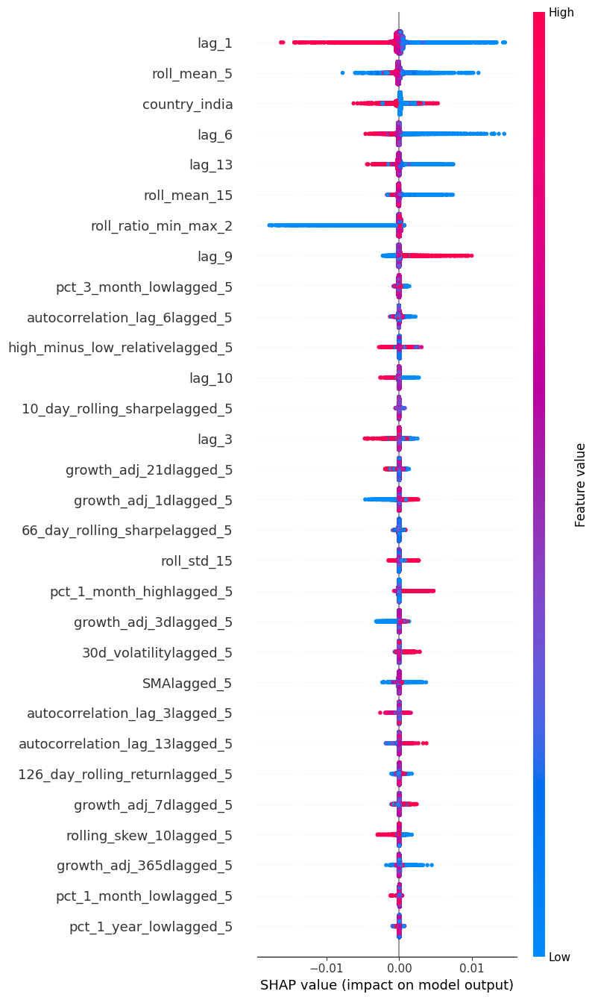

In [190]:
shap.summary_plot(shap_values, X_train, max_display=30)

In [200]:
from sklearn.feature_selection import SequentialFeatureSelector
from sklearn.model_selection import ShuffleSplit
from skforecast.feature_selection import select_features
from skforecast.feature_selection import select_features_multiseries

# Create forecaster
# ==============================================================================
# Define the forecaster. 

forecaster.dropna_from_series = True

cv = TimeSeriesSplit(n_splits=5)
selector = SequentialFeatureSelector(
               estimator            = forecaster.regressor,
               n_features_to_select = 30,
               direction            = "forward",
               cv                   = cv,
               scoring              = "neg_mean_absolute_percentage_error",
               n_jobs               = 6,
           )

selected_lags, selected_window_features, selected_exog = select_features_multiseries(
    forecaster   = forecaster,
    selector     = selector,
    series       = series_dict,
    exog         = exog_dict,
    select_only  = None,
    subsample    = 0.5,
    random_state = 123,
    verbose      = True,
)



/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/recursive/_forecaster_recursive_multiseries.py:1081: MissingValuesWarning: NaNs detected in `X_train`. They have been dropped. If you want to keep them, set `forecaster.dropna_from_series = False`. Same rows have been removed from `y_train` to maintain alignment. This caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


Recursive feature elimination (SequentialFeatureSelector)
---------------------------------------------------------
Total number of records available: 80106
Total number of records used for feature selection: 40053
Number of features available: 71
    Lags            (n=6)
    Window features (n=4)
    Exog            (n=61)
Number of features selected: 30
    Lags            (n=3) : [1, 6, 9]
    Window features (n=3) : ['roll_ratio_min_max_2', 'roll_mean_5', 'roll_mean_15']
    Exog            (n=24) : ['country_denmark', 'country_france', 'country_germany', 'country_india', 'country_ireland', 'country_netherlands', 'country_spain', 'country_united_states', 'growth_adj_365dlagged_5', 'SMA22lagged_5', '30d_volatilitylagged_5', 'volume_last_10lagged_5', 'pct_3_month_highlagged_5', 'pct_1_year_highlagged_5', 'pct_6_month_lowlagged_5', '10_day_rolling_returnlagged_5', '22_day_rolling_returnlagged_5', '126_day_rolling_returnlagged_5', '66_day_rolling_sharpelagged_5', 'autocorrelation_lag_

    Lags            (n=3) : [1, 6, 9]
    Window features (n=3) : ['roll_ratio_min_max_2', 'roll_mean_5', 'roll_mean_15']
    Exog            (n=24) : ['country_denmark', 'country_france', 'country_germany', 'country_india', 'country_ireland', 'country_netherlands', 'country_spain', 'country_united_states', 'growth_adj_365dlagged_5', 'SMA22lagged_5', '30d_volatilitylagged_5', 'volume_last_10lagged_5', 'pct_3_month_highlagged_5', 'pct_1_year_highlagged_5', 'pct_6_month_lowlagged_5', '10_day_rolling_returnlagged_5', '22_day_rolling_returnlagged_5', '126_day_rolling_returnlagged_5', '66_day_rolling_sharpelagged_5', 'autocorrelation_lag_1lagged_5', 'autocorrelation_lag_6lagged_5', 'rolling_skew_5lagged_5', 'rolling_skew_10lagged_5', 'rolling_skew_15lagged_5']

In [203]:
data_long_indicators_exog["datetime","symbol","country", 'growth_adj_365dlagged_5', 'SMA22lagged_5', '30d_volatilitylagged_5', 'volume_last_10lagged_5', 'pct_3_month_highlagged_5', 'pct_1_year_highlagged_5', 'pct_6_month_lowlagged_5', '10_day_rolling_returnlagged_5', '22_day_rolling_returnlagged_5', '126_day_rolling_returnlagged_5', '66_day_rolling_sharpelagged_5', 'autocorrelation_lag_1lagged_5', 'autocorrelation_lag_6lagged_5', 'rolling_skew_5lagged_5', 'rolling_skew_10lagged_5', 'rolling_skew_15lagged_5']

datetime,symbol,country,growth_adj_365dlagged_5,SMA22lagged_5,30d_volatilitylagged_5,volume_last_10lagged_5,pct_3_month_highlagged_5,pct_1_year_highlagged_5,pct_6_month_lowlagged_5,10_day_rolling_returnlagged_5,22_day_rolling_returnlagged_5,126_day_rolling_returnlagged_5,66_day_rolling_sharpelagged_5,autocorrelation_lag_1lagged_5,autocorrelation_lag_6lagged_5,rolling_skew_5lagged_5,rolling_skew_10lagged_5,rolling_skew_15lagged_5
datetime[ns],str,str,f64,f64,f64,i64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
2012-06-05 00:00:00,"""AVGO""","""united_states""",0.997223,2.330047,0.049999,249349000,1.131205,1.131205,0.796909,0.106018,-0.010242,0.23018,-0.507198,-0.17136,0.075404,-0.295744,0.490917,1.005615
2012-06-06 00:00:00,"""AVGO""","""united_states""",0.991539,2.324978,0.047652,254093000,1.178766,1.178766,0.830414,0.06824,-0.03747,0.184909,-0.648759,-0.302114,-0.156575,0.590477,0.133977,0.752152
2012-06-07 00:00:00,"""AVGO""","""united_states""",0.993328,2.320435,0.045389,253798000,1.177342,1.177342,0.829411,0.078468,-0.032792,0.175972,-0.812418,-0.260341,-0.147053,0.975974,-0.240655,0.475129
2012-06-08 00:00:00,"""AVGO""","""united_states""",0.93664,2.308981,0.042834,273818000,1.257908,1.257908,0.886168,0.037169,-0.09626,0.075554,-1.51322,-0.226763,-0.460795,-0.610493,-0.183411,0.471062
2012-06-11 00:00:00,"""AVGO""","""united_states""",0.912957,2.294992,0.03884,290695000,1.27645,1.27645,0.89923,0.024306,-0.120071,0.061362,-1.928255,-0.116752,-0.435223,-0.059477,-0.029393,0.47155
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
2025-01-24 00:00:00,"""TTE""","""france""",0.965006,55.082785,0.033949,22836800,1.139443,1.212684,0.895467,0.080162,0.069653,-0.110791,-0.115197,0.05948,0.188323,0.721809,0.211894,0.00002
2025-01-27 00:00:00,"""TTE""","""france""",0.992873,55.282934,0.037856,23919700,1.127435,1.202899,0.888242,0.077654,0.078323,-0.114632,-0.097855,0.024183,0.0505,0.188939,0.581653,0.023229
2025-01-28 00:00:00,"""TTE""","""france""",0.974348,55.544589,0.03956,25027900,1.083205,1.210632,0.893952,0.064004,0.103398,-0.106011,-0.107025,0.016643,0.114952,-0.28639,0.60925,-0.104123


In [215]:
start_train = "2012-06-04" # Monday
end_train = '2018-05-28' # Friday
end_val = '2022-05-27' # Friday
start_test = "2022-05-30" # Monday
end_test = '2025-01-17' # Friday

recursive_multiseries_separate_args = {
    "dataframe": data_long_indicators_series.to_pandas(),
    "exog_dataframe": data_long_indicators_exog["datetime","symbol","country", 'growth_adj_365dlagged_5', 'SMA22lagged_5', '30d_volatilitylagged_5', 
                                                'volume_last_10lagged_5', 'pct_3_month_highlagged_5', 'pct_1_year_highlagged_5', 'pct_6_month_lowlagged_5', 
                                                '10_day_rolling_returnlagged_5', '22_day_rolling_returnlagged_5', '126_day_rolling_returnlagged_5', '66_day_rolling_sharpelagged_5', 
                                                'autocorrelation_lag_1lagged_5', 'autocorrelation_lag_6lagged_5', 'rolling_skew_5lagged_5', 'rolling_skew_10lagged_5', 'rolling_skew_15lagged_5'].to_pandas(),
    "series_id_column": "symbol",
    "start_train": start_train,
    "start_test": start_test,
    "end_val": end_val,
    "end_test": end_test,
    "model": histb,
    "fill_nan": "ffill",
    "forecast_horizon": 5,
    "window_stats": ["ratio_min_max","mean","mean"],
    "window_sizes": [2,5,15],
    "lags": [1, 6, 9],
    "differentiation": 1,
    "transformer_exog": one_hot_encoder,
    "n_jobs": 4,
    "index_freq": "B",
    "refit": 8,
    "fixed_train_size": True,
    "suppress_warnings": False,
    "show_progress": True,
    "verbose": False,

}



metrics_levels, backtest_predictions, forecaster, series_dict, exog_dict = evaluate_recursive_multiseries_separate(**recursive_multiseries_separate_args)

/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/preprocessing/preprocessing.py:737: MissingValuesWarning: Series 'AAPL' is incomplete. NaNs have been introduced after setting the frequency. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/preprocessing/preprocessing.py:737: MissingValuesWarning: Series 'ACN' is incomplete. NaNs have been introduced after setting the frequency. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/preprocessing/preprocessing.py:737: MissingValuesWarning: Series 'AMZN' is incomplete. NaNs have been introduced after setting the frequency. 
 You can suppress this warning using: warnings.simplefilter(

Series values filled forward


/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/preprocessing/preprocessing.py:807: MissingValuesWarning: Exogenous variables for series 'AAPL' are incomplete. NaNs have been introduced after setting the frequency. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/preprocessing/preprocessing.py:807: MissingValuesWarning: Exogenous variables for series 'ACN' are incomplete. NaNs have been introduced after setting the frequency. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/preprocessing/preprocessing.py:807: MissingValuesWarning: Exogenous variables for series 'AMZN' are incomplete. NaNs have been introduced after setting t

Exog values filled forward


/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/recursive/_forecaster_recursive_multiseries.py:1090: MissingValuesWarning: NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


============================== 
ForecasterRecursiveMultiSeries 
============================== 
Regressor: HistGradientBoostingRegressor 
Lags: [1 6 9] 
Window features: ['roll_ratio_min_max_2', 'roll_mean_5', 'roll_mean_15'] 
Window size: 16 
Series encoding: onehot 
Series names (levels): 
    AAPL, ACN, AMZN, ASML, AVGO, BHARTIARTL.NS, BRK-B, CDI.PA, GOOG, HDB,
    HINDUNILVR.NS, IBN, IDEXY, INFY, ITC.NS, JPM, LLY, LT.NS, MC.PA, META, MSFT,
    NVDA, NVO, OR.PA, RELIANCE.NS, RMS.PA, SAP, SBIN.NS, SIE.DE, TCS.NS, TTE, V 
Exogenous included: True 
Exogenous names: 
    country, growth_adj_365dlagged_5, SMA22lagged_5, 30d_volatilitylagged_5,
    volume_last_10lagged_5, pct_3_month_highlagged_5, pct_1_year_highlagged_5,
    pct_6_month_lowlagged_5, 10_day_rolling_returnlagged_5,
    22_day_rolling_returnlagged_5, 126_day_rolling_returnlagged_5,
    66_day_rolling_sharpelagged_5, autocorrelation_lag_1lagged_5,
    autocorrelation_lag_6lagged_5, rolling_skew_5lagged_5,
    rolling_skew_10lagged_5, rolling_skew_15lagged_5 
Transformer for series: None 
Transformer for exog: ColumnTransformer(remainder='passthrough',
                  transformers=[('onehotencoder',
                                 OneHotEncoder(drop='if_binary',
                                               sparse_output=False),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x7f69bd1261d0>)],
                  verbose_feature_names_out=False) 
Weight function included: False 
Series weights: None 
Differentiation order: 1 
Training range: 
    'AAPL': ['2012-06-05', '2022-05-27'], 'ACN': ['2012-06-05', '2022-05-27'],
    'AMZN': ['2012-06-05', '2022-05-27'], 'ASML': ['2012-06-05', '2022-05-27'],
    'AVGO': ['2012-06-05', '2022-05-27'], ..., 'SBIN.NS': ['2012-06-05',
    '2022-05-27'], 'SIE.DE': ['2012-06-05', '2022-05-27'], 'TCS.NS':
    ['2012-06-05', '2022-05-27'], 'TTE': ['2012-06-05', '2022-05-27'], 'V':
    ['2012-06-05', '2022-05-27'] 
Training index type: DatetimeIndex 
Training index frequency: B 
Regressor parameters: 
    {'categorical_features': 'warn', 'early_stopping': 'auto', 'interaction_cst':
    None, 'l2_regularization': 0.0, 'learning_rate': 0.1, 'loss':
    'absolute_error', 'max_bins': 255, 'max_depth': None, 'max_features': 1.0,
    'max_iter': 100, 'max_leaf_nodes': 31, 'min_samples_leaf': 20,
    'monotonic_cst': None, 'n_iter_no_change': 10, 'quantile': None,
    'random_state': 8523, 'scoring': 'loss', 'tol': 1e-07,
    'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False} 
fit_kwargs: {} 
Creation date: 2025-02-03 22:00:29 
Last fit date: 2025-02-03 22:00:31 
Skforecast version: 0.14.0 
Python version: 3.10.12 
Forecaster id: None

/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/model_selection/_validation.py:577: IgnoredArgumentWarning: If `refit` is an integer other than 1 (intermittent refit). `n_jobs` is set to 1 to avoid unexpected results during parallelization. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=IgnoredArgumentWarning)
  warnings.warn(
/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/recursive/_forecaster_recursive_multiseries.py:1090: MissingValuesWarning: NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


  0%|          | 0/140 [00:00<?, ?it/s]

/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/recursive/_forecaster_recursive_multiseries.py:1090: MissingValuesWarning: NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/recursive/_forecaster_recursive_multiseries.py:1090: MissingValuesWarning: NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/recursive/_forecaster_recu

The mean MAPE is 0.020003768361523122


### Hyperparameter search

# 3. Probabilistic forecasting

On the next notebook

-----------------------

----------------------------------

Now to add other exogenous features, let's follow the previously established guidelines:
- Macroindicators:
    - Country/region:
        - Political (?)
        - Economical: EuroYield, DGS, etc.
        - Stocks: SNP500, EURONEXT, DAX, etc.
    - Sector

Then can follow up with:
- News sentiment
- Fundamentals

In [ ]:
import yfinance as yf
import pandas_datareader.data as pdr

#### Economic indicators

In [112]:
vix = file_handler.read_parquet_file("../data/extracted/macro/^VIX.parquet").select(["datetime","close"])
vix

datetime,close
datetime[ns],f64
1990-01-02 00:00:00,17.24
1990-01-03 00:00:00,18.190001
1990-01-04 00:00:00,19.219999
1990-01-05 00:00:00,20.110001
1990-01-08 00:00:00,20.26
…,…
2025-01-24 00:00:00,14.85
2025-01-27 00:00:00,17.9
2025-01-28 00:00:00,16.41


In [91]:
# US break-even inflation rate
ten_year_inflation_us = pdr.DataReader("T10YIE", "fred", start="2000-01-02") # Needs 1 day lag, daily
ten_year_inflation_us

,T10YIE
DATE,
2003-01-02,1.64
2003-01-03,1.62
2003-01-06,1.63
2003-01-07,1.62
2003-01-08,1.71
...,...
2025-01-23,2.42
2025-01-24,2.43
2025-01-27,2.40


In [ ]:
# US DGS1
dgs = file_handler.read_parquet_file("../data/extracted/macro/DGS1.parquet") # Already lagged, daily
dgs

datetime,dgs1_prev1_d
datetime[ns],f64
1962-01-03 00:00:00,3.22
1962-01-04 00:00:00,3.24
1962-01-05 00:00:00,3.24
1962-01-06 00:00:00,3.26
1962-01-09 00:00:00,3.31
…,…
2025-01-18 00:00:00,4.21
2025-01-21 00:00:00,null
2025-01-22 00:00:00,4.21


In [87]:
# EuroYieldCurve
eur_yld = file_handler.read_parquet_file("../data/extracted/macro/eurostat_euro_yield.parquet") # already lagged, daily
eur_yld = ticker_extender.transform_euro_yield_df(eur_yld)["datetime","eur_yld_Y1_prev_2d"]
eur_yld

datetime,eur_yld_Y1_prev_2d
datetime[μs],f32
2004-09-08 00:00:00,2.29884
2004-09-09 00:00:00,2.32889
2004-09-10 00:00:00,2.34667
2004-09-13 00:00:00,2.30899
2004-09-14 00:00:00,2.27157
…,…
2025-01-20 00:00:00,2.3636
2025-01-21 00:00:00,2.35293
2025-01-22 00:00:00,2.34371


In [88]:
# US Consumer Price Index (CPI)
cpilfesl = file_handler.read_parquet_file("../data/extracted/macro/CPILFESL.parquet") # already lagged, monthly
cpilfesl

datetime,cpilfesl_prev1_mo
datetime[ns],f64
1957-02-01 00:00:00,28.5
1957-03-01 00:00:00,28.6
1957-04-01 00:00:00,28.7
1957-05-01 00:00:00,28.8
1957-06-01 00:00:00,28.8
…,…
2024-09-01 00:00:00,319.768
2024-10-01 00:00:00,320.767
2024-11-01 00:00:00,321.666


In [89]:
# US Consumer Price Index (CPI)
cpi = pdr.get_data_fred("CPIAUCSL") # Needs 1 lag, monthly
cpi.tail()

,CPIAUCSL
DATE,
2024-08-01,314.121
2024-09-01,314.686
2024-10-01,315.454
2024-11-01,316.441
2024-12-01,317.685


In [92]:
# GDPPOT
gdppot = file_handler.read_parquet_file("../data/extracted/macro/GDPPOT.parquet") # quarterly, might need growth features
gdppot


datetime,gdppot
datetime[ns],f64
1955-01-01 00:00:00,2959.7762
1955-04-01 00:00:00,2979.062097
1955-07-01 00:00:00,2998.026312
1955-10-01 00:00:00,3017.709772
1956-01-01 00:00:00,3037.459894
…,…
2024-01-01 00:00:00,22566.61
2024-04-01 00:00:00,22682.66
2024-07-01 00:00:00,22800.63


In [56]:

# FEDFUNDS

# Corporate Bond Spreads (High Yield)
hy_spread = pdr.get_data_fred("BAMLH0A0HYM2")

# SOFR (Secured Overnight Financing Rate)
sofr = pdr.get_data_fred("SOFR")
print(sofr.tail())


[*********************100%***********************]  1 of 1 completed


Commodities & crypto

In [ ]:
# Get Gold, Oil, + Copper


# Copper Prices
copper = yf.download("HG=F", period="5y", interval="1mo")
print(copper.tail())

Employment & inflation

In [ ]:
# CPILFESL
# US Consumer Price Index (CPI)
cpi = pdr.get_data_fred("CPIAUCSL")
print(cpi.tail())

# US Unemployment Rate
unemployment = pdr.get_data_fred("UNRATE")
print(unemployment.tail())

# Nonfarm Payrolls (Employment Growth)
nfp = pdr.get_data_fred("PAYEMS")
print(nfp.tail())

# EU unemp
# Fetch dataset
import eurostat
code = "une_rt_m"
unemployment = eurostat.get_data_df(code, flags=False, verbose=True)

# Filter for the Euro Area aggregate
ea_unemployment = unemployment[unemployment["geo\TIME_PERIOD"] == "EA20"]  # Use "EU27_2020" for all of the EU

# Display the latest values
ea_unemployment.tail()

,LRHUTTTTEZM156S
DATE,
2000-01-01,9.4
2000-02-01,9.3
2000-03-01,9.2
2000-04-01,9.1
2000-05-01,9.0
...,...
2022-09-01,6.7
2022-10-01,6.6
2022-11-01,6.7


Countries stock market indicators:

3. Stock Market Indices
You can fetch these using yfinance:

US:
^GSPC (S&P 500)
^DJI (Dow Jones)
^IXIC (Nasdaq 100)
Europe:
^STOXX50E (EURO STOXX 50)
^GDAXI (DAX - Germany)
^FCHI (CAC 40 - France)
^BFX (Euronext Belgium)
Asia:
^N225 (Nikkei 225 - Japan)
^HSI (Hang Seng - Hong Kong)
^SSEC (Shanghai Composite - China)
Emerging Markets:
EEM (iShares MSCI Emerging Markets ETF)

Sectors

In [61]:
import yfinance as yf

# S&P 500 Sector ETFs (Mostly US-based)
sectors = ["XLF", "XLK", "XLE", "XLV", "XLI", "XLY", "XLP", "XLU", "XLC", "XLRE", "XLB"]

sector_data = yf.download(sectors, period="max", interval="1d")["Close"]
print(sector_data.tail())

# Global Sector ETFs (More internationally diversified)
global_sectors = ["IXJ", "IXG", "IXC", "IXN", "IXP"]  # Healthcare, Financials, Energy, Tech, Telecom

global_sector_data = yf.download(global_sectors, period="max", interval="1d")["Close"]
print(global_sector_data.tail())


[*********************100%***********************]  11 of 11 completed


Ticker            XLB         XLC        XLE        XLF         XLI  \
Date                                                                  
2025-01-24  89.000000  100.410004  91.309998  50.849998  141.070007   
2025-01-27  89.050003  100.930000  90.360001  51.410000  139.179993   
2025-01-28  88.760002  101.419998  89.500000  51.320000  138.259995   
2025-01-29  88.599998  101.870003  89.699997  51.279999  137.789993   
2025-01-30  88.964996  101.760002  89.849998  51.805000  138.399994   

Ticker             XLK        XLP       XLRE        XLU         XLV  \
Date                                                                  
2025-01-24  239.300003  77.900002  41.549999  79.489998  144.309998   
2025-01-27  227.570007  80.010002  41.959999  77.650002  147.550003   
2025-01-28  233.639999  78.760002  41.450001  76.580002  146.520004   
2025-01-29  231.740005  78.949997  40.970001  76.739998  145.660004   
2025-01-30  230.699997  79.449997  41.590000  77.995003  146.899994   

Tick

[*********************100%***********************]  5 of 5 completed

Ticker            IXC         IXG        IXJ        IXN         IXP
Date                                                               
2025-01-24  40.259998  101.180000  90.139999  87.000000  101.120003
2025-01-27  39.990002  102.129997  91.980003  82.190002  101.220001
2025-01-28  39.619999  102.250000  91.250000  84.629997  102.559998
2025-01-29  39.650002  102.029999  90.760002  83.889999  102.860001
2025-01-30  39.904999  103.150002  91.680000  83.834999  103.709999


In [805]:
vix = file_handler.read_parquet_file("../../data/extracted/macro/^VIX.parquet").select(["datetime","close"])
vix

datetime,close
datetime[ns],f64
1990-01-02 00:00:00,17.24
1990-01-03 00:00:00,18.190001
1990-01-04 00:00:00,19.219999
1990-01-05 00:00:00,20.110001
1990-01-08 00:00:00,20.26
…,…
2025-01-24 00:00:00,14.85
2025-01-27 00:00:00,17.9
2025-01-28 00:00:00,16.41


Showing all possible lags:
VIX: [1, 13, 7, 29, 25]
Showing all possible lags:
VIX: [1, 13, 36, 7, 25]


LLY              0
ITC.NS           0
JPM              0
AMZN             0
HDB              0
TCS.NS           0
TTE              0
V                0
INFY             0
AVGO             0
SIE.DE           0
MC.PA            0
LT.NS            0
SBIN.NS          0
GOOG             0
HINDUNILVR.NS    0
MSFT             0
RMS.PA           0
OR.PA            0
BHARTIARTL.NS    0
BRK-B            0
SAP              0
META             0
RELIANCE.NS      0
NVDA             0
ACN              0
IDEXY            0
CDI.PA           0
ASML             0
AAPL             0
NVO              0
IBN              0
VIX              0
VIX_growth_1d    0
dtype: int64

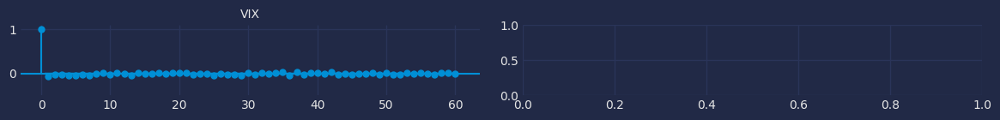

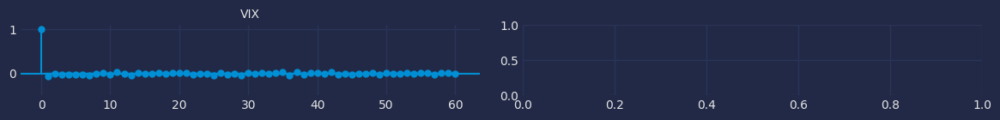

In [432]:
vix_pd = vix.rename({"close":"VIX"}).with_columns(pl.col("VIX").pct_change(1).alias("VIX_growth_1d")).to_pandas().set_index("datetime")
data_calendar_cyclical_exog = dataframe_simple_pivot.copy().dropna().merge(vix_pd, left_index=True, right_index=True, how="inner" )
top_pacf_df_exog = calculate_top_acf_pacf_df(data_calendar_cyclical_exog,cols=["VIX"], method='pacf')
top_acf_df_exog = calculate_top_acf_pacf_df(data_calendar_cyclical_exog,cols=["VIX"], method='acf')
data_calendar_cyclical_exog.isna().sum()

Showing all possible lags:
close: [1, 2, 4, 6, 50]
Showing all possible lags:
close: [1, 2, 4, 50, 6]


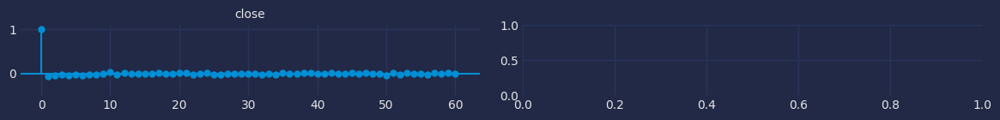

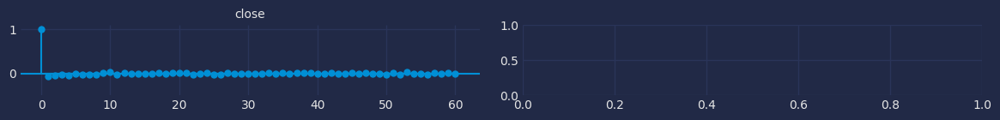

In [15]:
top_pacf_df_exog = calculate_top_acf_pacf_df(vix.to_pandas(),cols=["close"], method='pacf')
top_acf_df_exog = calculate_top_acf_pacf_df(vix.to_pandas(),cols=["close"], method='acf')

In [781]:
ticker_extender.calculate_rolling_features(df = vix , prefix="VIX_", ticker=False).tail(10)

VIX_SMA10,VIX_SMA22,VIX_SMA66,VIX_30d_volatility,VIX_is_growing_moving_average
f64,f64,f64,f64,i8
17.578,17.577273,17.072424,49.865145,1
17.382,17.675455,17.004394,48.421892,0
17.275,17.692273,16.934091,48.163646,0
17.181,17.657273,16.850152,48.581929,0
16.901,17.084546,16.781061,34.146721,0
16.616,16.664546,16.716515,24.298777,0
16.452,16.643637,16.714546,23.961145,0
16.174,16.626818,16.684849,23.968598,0
15.959,16.730909,16.66,22.472912,0


In [6]:
vix = file_handler.read_parquet_file("../../data/extracted/macro/^VIX.parquet").select(["datetime","close"])
vix

datetime,close
datetime[ns],f64
1990-01-02 00:00:00,17.24
1990-01-03 00:00:00,18.190001
1990-01-04 00:00:00,19.219999
1990-01-05 00:00:00,20.110001
1990-01-08 00:00:00,20.26
…,…
2025-01-24 00:00:00,14.85
2025-01-27 00:00:00,17.9
2025-01-28 00:00:00,16.41


In [7]:
vix_extended = ticker_extender.calculate_lag_rolling_features_pipe(df = vix, forecast_horizon=7, rolling_lags= [2, 4, 50, 6], prefix="VIX", growth=False)
vix_extended

datetime,VIX,VIX_2d_window_lagged_7,VIX_4d_window_lagged_7,VIX_50d_window_lagged_7,VIX_6d_window_lagged_7
datetime[ns],f64,f64,f64,f64,f64
1990-01-02 00:00:00,17.24,null,null,null,null
1990-01-03 00:00:00,18.190001,null,null,null,null
1990-01-04 00:00:00,19.219999,null,null,null,null
1990-01-05 00:00:00,20.110001,null,null,null,null
1990-01-08 00:00:00,20.26,null,null,null,null
…,…,…,…,…,…
2025-01-24 00:00:00,14.85,18.95,18.785,16.4366,18.166667
2025-01-27 00:00:00,17.9,17.415,18.39,16.2958,18.18
2025-01-28 00:00:00,16.41,16.360001,17.655,16.1902,17.976667


Temporal train test split

In [8]:
data = dataframe_simple_pivot.asfreq("D").interpolate()
start_train = "2012-05-18"
end_train = '2018-05-28'
end_val = '2022-05-31'
end_test = '2025-01-17'

data = data.loc[start_train:end_test]
targets = data.columns.to_list()
data

,GOOG,NVO,AVGO,TTE,ITC.NS,CDI.PA,NVDA,OR.PA,IDEXY,MC.PA,...,LT.NS,HINDUNILVR.NS,V,MSFT,TCS.NS,BHARTIARTL.NS,INFY,SAP,RELIANCE.NS,JPM
datetime,,,,,,,,,,,,,,,,,,,,,
2012-05-18,14.900410,11.307554,2.173832,20.731527,112.220169,82.081978,0.276960,74.469154,6.163229,95.426720,...,425.144531,346.355072,25.753880,23.397011,474.003540,249.760147,3.876589,46.915314,133.540054,23.570280
2012-05-19,15.013825,11.403196,2.195315,20.841892,111.486244,82.234825,0.278565,74.561295,6.170497,95.546242,...,428.940216,344.791840,26.026721,23.524906,473.814341,249.254796,3.879302,47.391715,133.989360,23.340371
2012-05-20,15.127241,11.498838,2.216797,20.952256,110.752319,82.387672,0.280169,74.653435,6.177765,95.665764,...,432.735901,343.228607,26.299563,23.652800,473.625142,248.749446,3.882015,47.868116,134.438665,23.110463
2012-05-21,15.240657,11.594481,2.238280,21.062620,110.018394,82.540520,0.281774,74.745575,6.185033,95.785286,...,436.531586,341.665375,26.572405,23.780695,473.435944,248.244095,3.884727,48.344517,134.887970,22.880554
2012-05-22,14.910338,11.551320,2.264349,20.996405,109.034615,84.718681,0.278335,74.298439,6.290420,98.415001,...,424.631958,339.781555,27.068548,23.788687,479.250000,248.581009,3.935923,48.262287,134.034607,23.936262
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-01-13,192.289993,84.620003,225.289993,56.810001,439.049988,605.000000,133.229996,328.399994,25.080000,646.400024,...,3464.300049,2451.000000,306.920013,417.190002,4223.769531,1597.199951,22.690001,249.529999,1239.849976,244.210007
2025-01-14,191.050003,81.180000,224.699997,57.560001,436.600006,608.000000,131.759995,326.649994,25.360001,651.000000,...,3462.600098,2367.949951,309.089996,415.670013,4166.629883,1600.099976,22.510000,253.500000,1238.750000,247.470001
2025-01-15,196.979996,82.919998,228.000000,57.680000,437.350006,594.000000,136.240005,329.500000,25.799999,637.200012,...,3501.399902,2373.000000,316.279999,426.309998,4182.920898,1607.449951,22.889999,261.790009,1252.199951,252.350006


Showing all possible lags:
GOOG: [13, 28, 1, 12, 21]
NVO: [25, 14, 49, 33, 56]
AVGO: [2, 9, 8, 5, 58]
TTE: [14, 1, 17, 2, 49]
ITC.NS: [1, 2, 4, 35, 55]
CDI.PA: [8, 26, 1, 11, 2]
NVDA: [58, 2, 49, 23, 31]
OR.PA: [20, 5, 58, 3, 15]
IDEXY: [8, 49, 20, 46, 26]
MC.PA: [34, 26, 5, 20, 33]
HDB: [1, 8, 41, 39, 23]
AAPL: [20, 13, 27, 41, 8]
SBIN.NS: [1, 2, 13, 54, 16]
ACN: [13, 8, 9, 14, 49]
META: [56, 42, 58, 19, 44]
BRK-B: [8, 9, 11, 5, 19]
ASML: [57, 12, 9, 14, 21]
LLY: [14, 41, 42, 5, 9]
AMZN: [20, 58, 36, 56, 14]
IBN: [1, 13, 2, 8, 15]
SIE.DE: [54, 1, 49, 4, 8]
RMS.PA: [5, 8, 50, 49, 2]
LT.NS: [1, 2, 53, 52, 13]
HINDUNILVR.NS: [1, 44, 7, 31, 23]
V: [8, 21, 20, 10, 11]
MSFT: [20, 8, 13, 5, 35]
TCS.NS: [1, 38, 15, 27, 44]
BHARTIARTL.NS: [15, 30, 58, 22, 48]
INFY: [48, 52, 2, 8, 26]
SAP: [2, 28, 57, 40, 6]
RELIANCE.NS: [1, 2, 8, 25, 53]
JPM: [9, 21, 6, 13, 8]
Showing all possible lags:
GOOG: [13, 44, 12, 28, 1]
NVO: [25, 14, 49, 33, 56]
AVGO: [2, 58, 5, 9, 8]
TTE: [1, 14, 2, 17, 49]
ITC.NS: [

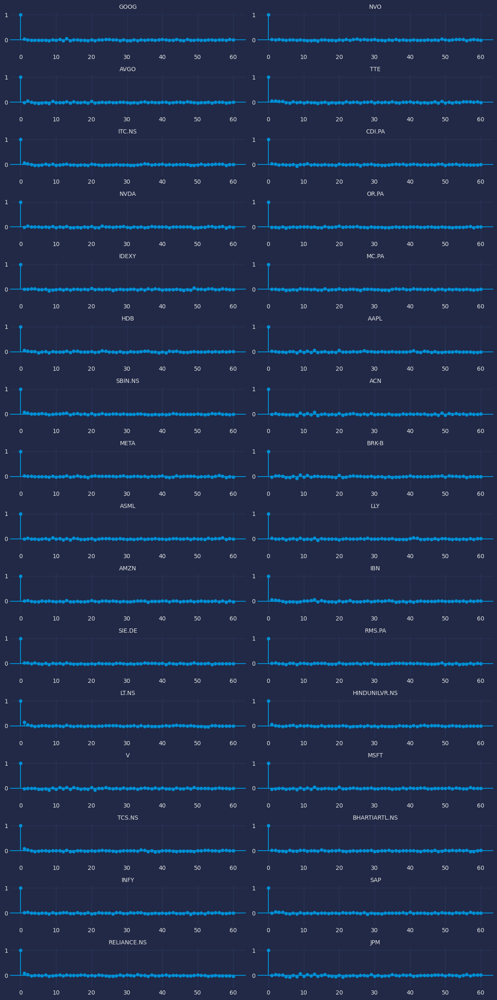

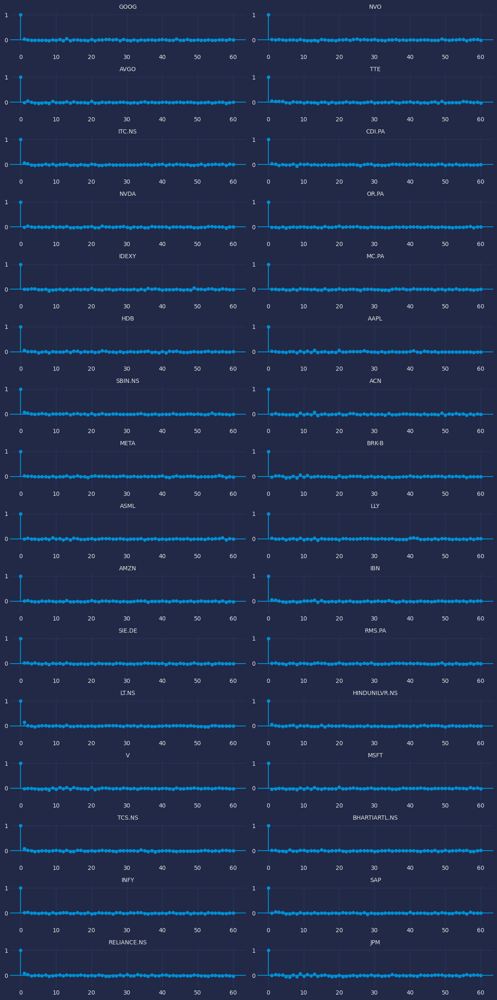

In [9]:
top_lags_acf, top_lags_acf_dict  = calculate_top_acf_pacf_df(data, data.columns, n_lags=60, method='acf')
top_lags_pacf, top_lags_pacf_dict = calculate_top_acf_pacf_df(data, data.columns, n_lags=60, method='pacf')

Exog - Get trading days

In [296]:
import pandas_market_calendars as mcal
nyse = mcal.get_calendar('XMAD')

trading_days = nyse.valid_days(start_date="1995-01-01", end_date="2025-01-01")
trading_days

DatetimeIndex(['1995-01-02 00:00:00+00:00', '1995-01-03 00:00:00+00:00',
               '1995-01-04 00:00:00+00:00', '1995-01-05 00:00:00+00:00',
               '1995-01-09 00:00:00+00:00', '1995-01-10 00:00:00+00:00',
               '1995-01-11 00:00:00+00:00', '1995-01-12 00:00:00+00:00',
               '1995-01-13 00:00:00+00:00', '1995-01-16 00:00:00+00:00',
               ...
               '2024-12-12 00:00:00+00:00', '2024-12-13 00:00:00+00:00',
               '2024-12-16 00:00:00+00:00', '2024-12-17 00:00:00+00:00',
               '2024-12-18 00:00:00+00:00', '2024-12-19 00:00:00+00:00',
               '2024-12-20 00:00:00+00:00', '2024-12-23 00:00:00+00:00',
               '2024-12-27 00:00:00+00:00', '2024-12-30 00:00:00+00:00'],
              dtype='datetime64[ns, UTC]', length=7606, freq='C')

In [10]:
import pandas_market_calendars as mcal

nyse = mcal.get_calendar('NYSE')

trading_days = nyse.valid_days(start_date=start_train, end_date=end_test)

trading_days_df = trading_days.to_frame(index=False, name='datetime')
trading_days_df["market_open"] = 1
trading_days_df = trading_days_df.set_index("datetime").asfreq("d").tz_localize(None).fillna(0)
data = pd.concat([data,trading_days_df],axis=1)
data

,GOOG,NVO,AVGO,TTE,ITC.NS,CDI.PA,NVDA,OR.PA,IDEXY,MC.PA,...,HINDUNILVR.NS,V,MSFT,TCS.NS,BHARTIARTL.NS,INFY,SAP,RELIANCE.NS,JPM,market_open
datetime,,,,,,,,,,,,,,,,,,,,,
2012-05-18,14.900410,11.307554,2.173832,20.731527,112.220169,82.081978,0.276960,74.469154,6.163229,95.426720,...,346.355072,25.753880,23.397011,474.003540,249.760147,3.876589,46.915314,133.540054,23.570280,1.0
2012-05-19,15.013825,11.403196,2.195315,20.841892,111.486244,82.234825,0.278565,74.561295,6.170497,95.546242,...,344.791840,26.026721,23.524906,473.814341,249.254796,3.879302,47.391715,133.989360,23.340371,0.0
2012-05-20,15.127241,11.498838,2.216797,20.952256,110.752319,82.387672,0.280169,74.653435,6.177765,95.665764,...,343.228607,26.299563,23.652800,473.625142,248.749446,3.882015,47.868116,134.438665,23.110463,0.0
2012-05-21,15.240657,11.594481,2.238280,21.062620,110.018394,82.540520,0.281774,74.745575,6.185033,95.785286,...,341.665375,26.572405,23.780695,473.435944,248.244095,3.884727,48.344517,134.887970,22.880554,1.0
2012-05-22,14.910338,11.551320,2.264349,20.996405,109.034615,84.718681,0.278335,74.298439,6.290420,98.415001,...,339.781555,27.068548,23.788687,479.250000,248.581009,3.935923,48.262287,134.034607,23.936262,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-01-13,192.289993,84.620003,225.289993,56.810001,439.049988,605.000000,133.229996,328.399994,25.080000,646.400024,...,2451.000000,306.920013,417.190002,4223.769531,1597.199951,22.690001,249.529999,1239.849976,244.210007,1.0
2025-01-14,191.050003,81.180000,224.699997,57.560001,436.600006,608.000000,131.759995,326.649994,25.360001,651.000000,...,2367.949951,309.089996,415.670013,4166.629883,1600.099976,22.510000,253.500000,1238.750000,247.470001,1.0
2025-01-15,196.979996,82.919998,228.000000,57.680000,437.350006,594.000000,136.240005,329.500000,25.799999,637.200012,...,2373.000000,316.279999,426.309998,4182.920898,1607.449951,22.889999,261.790009,1252.199951,252.350006,1.0


Exog - add Vix

In [11]:
data = data.merge(vix_extended.to_pandas(), right_on="datetime", left_index=True, how="left").set_index("datetime").asfreq("D").interpolate()
data

,GOOG,NVO,AVGO,TTE,ITC.NS,CDI.PA,NVDA,OR.PA,IDEXY,MC.PA,...,INFY,SAP,RELIANCE.NS,JPM,market_open,VIX,VIX_2d_window_lagged_7,VIX_4d_window_lagged_7,VIX_50d_window_lagged_7,VIX_6d_window_lagged_7
datetime,,,,,,,,,,,,,,,,,,,,,
2012-05-18,14.900410,11.307554,2.173832,20.731527,112.220169,82.081978,0.276960,74.469154,6.163229,95.426720,...,3.876589,46.915314,133.540054,23.570280,1.0,25.100000,19.565000,19.3075,17.176800,18.611666
2012-05-19,15.013825,11.403196,2.195315,20.841892,111.486244,82.234825,0.278565,74.561295,6.170497,95.546242,...,3.879302,47.391715,133.989360,23.340371,0.0,24.070000,19.528333,19.2800,17.179467,18.720000
2012-05-20,15.127241,11.498838,2.216797,20.952256,110.752319,82.387672,0.280169,74.653435,6.177765,95.665764,...,3.882015,47.868116,134.438665,23.110463,0.0,23.040000,19.491666,19.2525,17.182133,18.828333
2012-05-21,15.240657,11.594481,2.238280,21.062620,110.018394,82.540520,0.281774,74.745575,6.185033,95.785286,...,3.884727,48.344517,134.887970,22.880554,1.0,22.010000,19.455000,19.2250,17.184800,18.936666
2012-05-22,14.910338,11.551320,2.264349,20.996405,109.034615,84.718681,0.278335,74.298439,6.290420,98.415001,...,3.935923,48.262287,134.034607,23.936262,1.0,22.480000,19.360000,19.4625,17.237400,19.325000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-01-13,192.289993,84.620003,225.289993,56.810001,439.049988,605.000000,133.229996,328.399994,25.080000,646.400024,...,22.690001,249.529999,1239.849976,244.210007,1.0,19.190001,17.375000,16.3575,16.669600,16.080000
2025-01-14,191.050003,81.180000,224.699997,57.560001,436.600006,608.000000,131.759995,326.649994,25.360001,651.000000,...,22.510000,253.500000,1238.750000,247.470001,1.0,18.709999,17.640000,17.1575,16.660800,16.271667
2025-01-15,196.979996,82.919998,228.000000,57.680000,437.350006,594.000000,136.240005,329.500000,25.799999,637.200012,...,22.889999,261.790009,1252.199951,252.350006,1.0,16.120001,17.030000,17.2025,16.619400,16.581666


Add exog white noise

In [12]:
# Example: Create a time series column with daily frequency
date_range = pd.date_range(start=data.index.min(), end=data.index.max(), freq='D')

# Generate white noise (normally distributed random values with mean 0 and standard deviation 1)
data["white_noise"] = np.random.normal(loc=0, scale=1, size=len(date_range))

In [13]:
data_train = data.loc[start_train:end_train]
data_val = data.loc[end_train:end_val]
data_train_val = data.loc[start_train:end_val]
data_test = data.loc[end_val:end_test]
targets = targets
exog = data.columns.difference(targets + ["VIX"])
forecast_horizon = 7

In [14]:
# Custom function to create weights
# ==============================================================================
def custom_weights(index):
    """
    Return 0 if index is closed
    """

    weights = np.where(
                trading_days_df.loc[index, "market_open"] == 0,
                0,
                1
            )

    return weights

In [15]:
from xgboost import XGBRegressor

xgb = XGBRegressor(random_state=8523, objective="reg:absoluteerror")

In [16]:
exog

Index(['VIX_2d_window_lagged_7', 'VIX_4d_window_lagged_7',
       'VIX_50d_window_lagged_7', 'VIX_6d_window_lagged_7', 'market_open',
       'white_noise'],
      dtype='object')

In [17]:
exog

Index(['VIX_2d_window_lagged_7', 'VIX_4d_window_lagged_7',
       'VIX_50d_window_lagged_7', 'VIX_6d_window_lagged_7', 'market_open',
       'white_noise'],
      dtype='object')

In [18]:
data[exog]

,VIX_2d_window_lagged_7,VIX_4d_window_lagged_7,VIX_50d_window_lagged_7,VIX_6d_window_lagged_7,market_open,white_noise
datetime,,,,,,
2012-05-18,19.565000,19.3075,17.176800,18.611666,1.0,-1.225889
2012-05-19,19.528333,19.2800,17.179467,18.720000,0.0,1.108648
2012-05-20,19.491666,19.2525,17.182133,18.828333,0.0,0.713389
2012-05-21,19.455000,19.2250,17.184800,18.936666,1.0,0.139709
2012-05-22,19.360000,19.4625,17.237400,19.325000,1.0,0.041012
...,...,...,...,...,...,...
2025-01-13,17.375000,16.3575,16.669600,16.080000,1.0,-0.049946
2025-01-14,17.640000,17.1575,16.660800,16.271667,1.0,-1.358941
2025-01-15,17.030000,17.2025,16.619400,16.581666,1.0,-0.416710


In [338]:
# Define the forecaster. 
new_targets = ["LLY"]
new_window_sizes = [3]
new_lag_features = [1,2,3,5,7,14]
window_features = RollingFeatures(stats=['mean']*len(new_window_sizes), window_sizes=new_window_sizes) 
forecaster_ms_calendar_cyclical_exog = ForecasterRecursiveMultiSeries(
                    regressor       = xgb,
                    lags            = new_lag_features, 
                    transformer_series = StandardScaler(),
                    window_features=window_features,
                    differentiation=1,
                    encoding="onehot"
                )


forecaster_ms_calendar_cyclical_exog.fit(series=data_train_val[targets], exog=data_train_val[exog], suppress_warnings=False)

display(forecaster_ms_calendar_cyclical_exog)

# Backtesitng 
cv = TimeSeriesFold(
            steps              = forecast_horizon,
            initial_train_size =  len(data_train_val),
            refit              = 8,
            fixed_train_size   = False,
            differentiation=1
         )

multi_series_mape_calendar_cyclical_exog, predictions_calendar_cyclical_exog = backtesting_forecaster_multiseries(
                                       forecaster            = forecaster_ms_calendar_cyclical_exog,
                                       series                = data[targets], 
                                       levels                = targets,
                                       exog = data[exog],
                                       cv                    = cv,
                                       metric                = 'mean_absolute_percentage_error',
                                       add_aggregated_metric = False,
                                       verbose               = True,
                                       suppress_warnings = False,
                                       show_progress         = True ,
                                       n_jobs=6
                                   )   

# Resultados
display(multi_series_mape_calendar_cyclical_exog)
print(f"Mean MAPE error accross series is {multi_series_mape_calendar_cyclical_exog['mean_absolute_percentage_error'].mean():.6f}")

print('')
display(predictions_calendar_cyclical_exog)

============================== 
ForecasterRecursiveMultiSeries 
============================== 
Regressor: XGBRegressor 
Lags: [ 1  2  3  5  7 14] 
Window features: ['roll_mean_3'] 
Window size: 15 
Series encoding: onehot 
Series names (levels): 
    IBN, NVO, CDI.PA, OR.PA, RMS.PA, GOOG, TTE, V, NVDA, TCS.NS, META, SAP,
    RELIANCE.NS, LLY, IDEXY, BHARTIARTL.NS, ITC.NS, ACN, SBIN.NS, JPM, BRK-B,
    INFY, AVGO, AMZN, AAPL, ASML, LT.NS, HINDUNILVR.NS, MC.PA, HDB, MSFT, SIE.DE 
Exogenous included: True 
Exogenous names: 
    VIX_2d_window_lagged_7, VIX_4d_window_lagged_7, VIX_50d_window_lagged_7,
    VIX_6d_window_lagged_7, market_open, white_noise 
Transformer for series: StandardScaler() 
Transformer for exog: None 
Weight function included: False 
Series weights: None 
Differentiation order: 1 
Training range: 
    'IBN': ['2012-05-18', '2022-05-31'], 'NVO': ['2012-05-18', '2022-05-31'],
    'CDI.PA': ['2012-05-18', '2022-05-31'], 'OR.PA': ['2012-05-18',
    '2022-05-31'], 'RMS.PA': ['2012-05-18', '2022-05-31'], ..., 'HINDUNILVR.NS':
    ['2012-05-18', '2022-05-31'], 'MC.PA': ['2012-05-18', '2022-05-31'], 'HDB':
    ['2012-05-18', '2022-05-31'], 'MSFT': ['2012-05-18', '2022-05-31'],
    'SIE.DE': ['2012-05-18', '2022-05-31'] 
Training index type: DatetimeIndex 
Training index frequency: D 
Regressor parameters: 
    {'objective': 'reg:absoluteerror', 'base_score': None, 'booster': None,
    'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None,
    'colsample_bytree': None, 'device': None, 'early_stopping_rounds': None,
    'enable_categorical': False, 'eval_metric': None, 'feature_types': None,
    'gamma': None, 'grow_policy': None, 'importance_type': None,
    'interaction_constraints': None, 'learning_rate': None, 'max_bin': None,
    'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step':
    None, 'max_depth': None, 'max_leaves': None, 'min_child_weight': None,
    'missing': nan, 'monotone_constraints': None, 'multi_strategy': None,
    'n_estimators': None, 'n_jobs': None, 'num_parallel_tree': None,
    'random_state': 8523, 'reg_alpha': None, 'reg_lambda': None,
    'sampling_method': None, 'scale_pos_weight': None, 'subsample': None,
    'tree_method': None, 'validate_parameters': None, 'verbosity': None} 
fit_kwargs: {} 
Creation date: 2025-02-01 14:09:41 
Last fit date: 2025-02-01 14:09:45 
Skforecast version: 0.14.0 
Python version: 3.10.12 
Forecaster id: None

/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/model_selection/_validation.py:577: IgnoredArgumentWarning: If `refit` is an integer other than 1 (intermittent refit). `n_jobs` is set to 1 to avoid unexpected results during parallelization. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=IgnoredArgumentWarning)
  warnings.warn(


Information of folds
--------------------
Number of observations used for initial training: 3665
    First 1 observation/s in training sets are used for differentiation
Number of observations used for backtesting: 962
    Number of folds: 138
    Number skipped folds: 0 
    Number of steps per fold: 7
    Number of steps to exclude between last observed data (last window) and predictions (gap): 0
    Last fold only includes 3 observations.

Fold: 0
    Training:   2012-05-19 00:00:00 -- 2022-05-31 00:00:00  (n=3665)
    Validation: 2022-06-01 00:00:00 -- 2022-06-07 00:00:00  (n=7)
Fold: 1
    Training:   No training in this fold
    Validation: 2022-06-08 00:00:00 -- 2022-06-14 00:00:00  (n=7)
Fold: 2
    Training:   No training in this fold
    Validation: 2022-06-15 00:00:00 -- 2022-06-21 00:00:00  (n=7)
Fold: 3
    Training:   No training in this fold
    Validation: 2022-06-22 00:00:00 -- 2022-06-28 00:00:00  (n=7)
Fold: 4
    Training:   No training in this fold
    Validation: 2

  0%|          | 0/138 [00:00<?, ?it/s]

,levels,mean_absolute_percentage_error
0,IBN,0.017035
1,NVO,0.023407
2,CDI.PA,0.021981
3,OR.PA,0.018068
4,RMS.PA,0.022234
...,...,...
27,HINDUNILVR.NS,0.014837
28,MC.PA,0.022860
29,HDB,0.023003
30,MSFT,0.021715


Mean MAPE error accross series is 0.022270



,IBN,NVO,CDI.PA,OR.PA,RMS.PA,GOOG,TTE,V,NVDA,TCS.NS,...,AVGO,AMZN,AAPL,ASML,LT.NS,HINDUNILVR.NS,MC.PA,HDB,MSFT,SIE.DE
2022-06-01,18.785300,53.849896,552.915068,313.262773,1093.357674,113.698318,50.102844,208.058651,18.476420,3143.774937,...,54.551773,120.759859,146.835350,561.854751,1602.299073,2241.590132,570.553480,56.476599,266.489452,115.481968
2022-06-02,18.804596,53.752223,552.841602,313.844948,1093.447749,113.895974,50.191739,208.388405,18.522343,3174.434953,...,54.883922,120.490490,147.094849,564.099728,1604.271528,2249.207187,570.886212,56.669724,267.463529,114.938848
2022-06-03,18.814319,53.773912,551.481290,312.055474,1089.062700,113.398869,50.201308,208.387248,18.441555,3174.523799,...,54.695060,120.108229,146.585979,561.643199,1602.057680,2246.512912,568.260200,56.557434,266.851287,114.788110
2022-06-04,18.825567,53.797667,550.657648,311.604695,1086.474257,113.369958,50.228000,208.451386,18.445730,3174.395365,...,54.704144,119.824614,146.599524,562.296054,1600.002024,2245.991481,566.917406,56.581994,266.823831,114.743423
2022-06-05,18.834333,53.813468,549.571994,311.199623,1084.720468,113.311420,50.246999,208.494598,18.447773,3174.981243,...,54.746342,119.576910,146.606635,562.636650,1598.230504,2245.151644,565.876182,56.596310,266.820918,114.681427
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-01-13,29.955942,82.885026,615.251657,333.135236,2407.581477,195.452852,57.312222,312.563680,138.813039,3985.753943,...,226.844417,221.636682,244.110105,745.827496,3677.813645,2403.340835,660.845536,61.601320,424.356711,194.594984
2025-01-14,29.981521,82.918739,614.452424,333.042475,2407.654272,195.432882,57.245107,312.190121,138.850899,3978.941328,...,226.846882,221.640525,243.753435,746.004334,3678.923471,2405.606692,660.426724,61.518911,423.789004,194.430048
2025-01-15,28.467046,81.255086,608.146795,325.746338,2360.796750,191.236312,57.465989,309.613510,131.437025,4162.025276,...,224.613986,217.653011,233.034187,735.427280,3465.650629,2366.339497,649.718719,58.619247,415.319293,194.196699
2025-01-16,28.494025,81.353651,608.449160,325.683079,2362.982490,191.283688,57.558622,309.953134,131.318992,4163.758139,...,224.595319,217.674606,233.392180,735.868045,3466.711339,2369.900547,650.142160,58.678746,415.513914,194.318647


In [351]:
pd.set_option("display.max_rows", None)
display(multi_series_mape_calendar_cyclical_exog)
display(forecaster_ms_calendar_cyclical_exog.get_feature_importances().sort_values(by="importance", ascending=False))
pd.set_option("display.max_rows", 20)


,levels,mean_absolute_percentage_error
0,IBN,0.017035
1,NVO,0.023407
2,CDI.PA,0.021981
3,OR.PA,0.018068
4,RMS.PA,0.022234
5,GOOG,0.028095
6,TTE,0.017711
7,V,0.014946
8,NVDA,0.043994
9,TCS.NS,0.016845


,feature,importance
43,market_open,0.121458
0,lag_1,0.112757
6,roll_mean_3,0.075780
3,lag_5,0.058376
1,lag_2,0.045356
2,lag_3,0.035187
4,lag_7,0.034819
40,VIX_4d_window_lagged_7,0.027998
42,VIX_6d_window_lagged_7,0.027813
39,VIX_2d_window_lagged_7,0.025594


### Shap explainer

In [352]:
# Training matrices used by the forecaster to fit the internal regressor
# ==============================================================================
X_train, y_train = forecaster_ms_calendar_cyclical_exog.create_train_X_y(
                       series    = data_train_val[targets],
                       exog = data_train_val[exog]
                   )

display(X_train.head(3))
display(y_train.head(3))

,lag_1,lag_2,lag_3,lag_5,lag_7,lag_14,roll_mean_3,AAPL,ACN,AMZN,...,SIE.DE,TCS.NS,TTE,V,VIX_2d_window_lagged_7,VIX_4d_window_lagged_7,VIX_50d_window_lagged_7,VIX_6d_window_lagged_7,market_open,white_noise
datetime,,,,,,,,,,,,,,,,,,,,,
2012-06-02,-0.006648,-0.004986,-0.051438,0.008647,0.008647,0.011529,-2.102369e-02,0,0,0,...,0,0,0,0,22.298333,23.34,17.9718,23.073333,0.0,-0.477317
2012-06-03,0.003324,-0.006648,-0.004986,0.008647,0.008647,0.011529,-2.769859e-03,0,0,0,...,0,0,0,0,22.351666,23.16,18.0220,23.093333,0.0,1.798244
2012-06-04,0.003324,0.003324,-0.006648,-0.051438,0.008647,0.011529,-1.342949e-08,0,0,0,...,0,0,0,0,22.405000,22.98,18.0722,23.113333,1.0,2.145346


datetime
2012-06-02    0.003324
2012-06-03    0.003324
2012-06-04    0.003324
Name: y, dtype: float64

In [353]:
X_train

,lag_1,lag_2,lag_3,lag_5,lag_7,lag_14,roll_mean_3,AAPL,ACN,AMZN,...,SIE.DE,TCS.NS,TTE,V,VIX_2d_window_lagged_7,VIX_4d_window_lagged_7,VIX_50d_window_lagged_7,VIX_6d_window_lagged_7,market_open,white_noise
datetime,,,,,,,,,,,,,,,,,,,,,
2012-06-02,-0.006648,-0.004986,-0.051438,0.008647,0.008647,0.011529,-2.102369e-02,0,0,0,...,0,0,0,0,22.298333,23.3400,17.9718,23.073333,0.0,-0.477317
2012-06-03,0.003324,-0.006648,-0.004986,0.008647,0.008647,0.011529,-2.769859e-03,0,0,0,...,0,0,0,0,22.351666,23.1600,18.0220,23.093333,0.0,1.798244
2012-06-04,0.003324,0.003324,-0.006648,-0.051438,0.008647,0.011529,-1.342949e-08,0,0,0,...,0,0,0,0,22.405000,22.9800,18.0722,23.113333,1.0,2.145346
2012-06-05,0.003324,0.003324,0.003324,-0.004986,0.008647,-0.021566,3.323960e-03,0,0,0,...,0,0,0,0,21.935000,22.0900,18.1968,22.991667,1.0,-0.160534
2012-06-06,0.007063,0.003324,0.003324,-0.006648,-0.051438,-0.014242,4.570351e-03,0,0,0,...,0,0,0,0,21.650001,22.0275,18.3236,22.536667,1.0,0.252858
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-05-27,0.168732,0.000000,-0.097646,0.021092,0.102333,0.000000,2.369544e-02,0,0,0,...,1,0,0,0,28.530000,28.3500,26.0704,29.621667,1.0,0.069038
2022-05-28,0.000000,0.168732,0.000000,0.021092,0.021092,-0.003906,5.624415e-02,0,0,0,...,1,0,0,0,28.936250,28.3800,26.0549,29.487917,0.0,0.153085
2022-05-29,0.000000,0.000000,0.168732,-0.097646,0.021092,-0.003906,5.624415e-02,0,0,0,...,1,0,0,0,29.342500,28.4100,26.0394,29.354167,0.0,-0.230901


In [354]:
y_train

datetime
2012-06-02    0.003324
2012-06-03    0.003324
2012-06-04    0.003324
2012-06-05    0.007063
2012-06-06    0.069387
                ...   
2022-05-27    0.000000
2022-05-28    0.000000
2022-05-29    0.000000
2022-05-30    0.000000
2022-05-31    0.153109
Name: y, Length: 116832, dtype: float64

In [343]:
import shap
# Create SHAP explainer
# ==============================================================================
shap.initjs()
explainer = shap.TreeExplainer(forecaster_ms_calendar_cyclical_exog.regressor)
shap_values = explainer.shap_values(X_train)

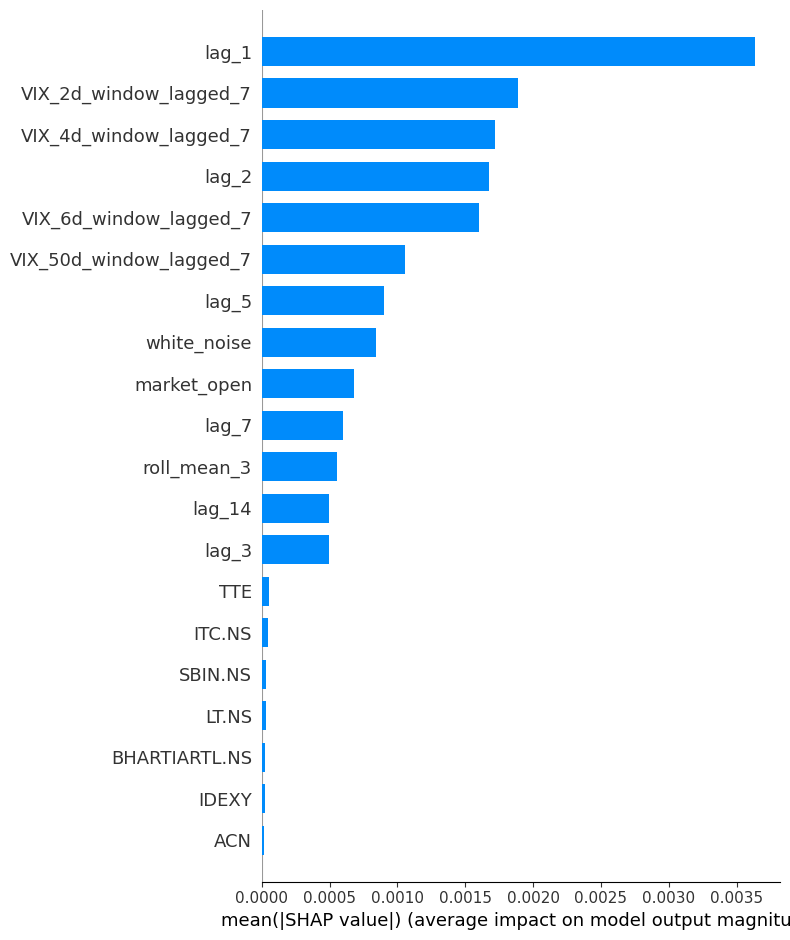

In [344]:
plt.style.use('default')
shap.summary_plot(shap_values, X_train, plot_type="bar")


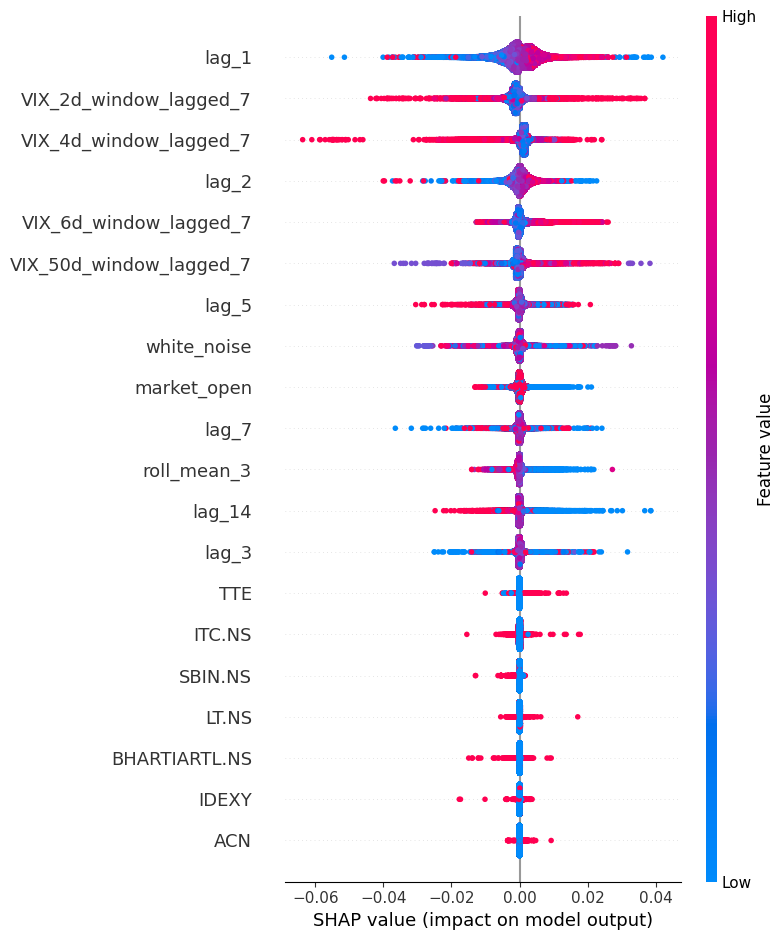

In [345]:
shap.summary_plot(shap_values, X_train)

In [326]:
y_pred = predictions_calendar_cyclical_exog
y_pred
y_true = data_test.loc["2022-06-01":,["LLY"]]
y_true

,LLY
datetime,
2022-06-01,304.199707
2022-06-02,295.741058
2022-06-03,294.978271
2022-06-04,295.535665
2022-06-05,296.093058
...,...
2025-01-13,797.479980
2025-01-14,744.909973
2025-01-15,746.739990


In [350]:
pd.DataFrame(shap_values, columns=X_train.columns)

,lag_1,lag_2,lag_3,lag_5,lag_7,lag_14,roll_mean_3,AAPL,ACN,AMZN,...,SIE.DE,TCS.NS,TTE,V,VIX_2d_window_lagged_7,VIX_4d_window_lagged_7,VIX_50d_window_lagged_7,VIX_6d_window_lagged_7,market_open,white_noise
0,-0.004389,-0.000775,-0.000837,0.000328,-0.000099,-0.000128,0.000076,-2.520215e-06,-3.099373e-06,-2.957348e-07,...,-4.826230e-06,1.180437e-06,-0.000008,0.000006,-0.003869,-0.001052,0.000780,0.004419,-0.002118,0.001490
1,0.001829,-0.000153,-0.000348,0.000219,-0.000368,0.000102,-0.000148,-8.400742e-07,-1.450646e-06,-4.078585e-07,...,-1.132178e-06,-5.689256e-07,-0.000021,0.000006,-0.003110,-0.001670,0.000820,0.006852,0.000490,0.000512
2,0.001086,0.000480,-0.000329,0.000406,-0.000066,-0.000078,0.000196,-1.795129e-07,-1.004800e-06,-2.622654e-07,...,-8.571363e-07,-7.746581e-06,-0.000028,0.000006,-0.004765,-0.001754,0.000752,0.007128,0.000177,-0.000351
3,0.001349,0.000499,-0.000005,-0.000166,-0.000191,-0.000054,-0.000106,-2.062266e-07,-8.312937e-07,2.154459e-07,...,-8.807809e-07,-1.264637e-06,-0.000031,0.000007,-0.006293,-0.000896,0.001181,0.006799,0.000098,0.000179
4,0.002138,0.000205,-0.000103,-0.000188,0.001835,-0.000296,-0.000303,-1.941528e-07,-2.680539e-06,2.358621e-07,...,-8.232746e-07,-4.580189e-06,-0.000031,0.000042,-0.007012,0.005658,0.001156,0.000407,-0.000303,-0.000201
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116827,-0.003542,-0.000546,-0.001723,0.000631,-0.002003,-0.001084,-0.002411,9.031144e-07,8.559398e-05,1.031525e-06,...,2.209574e-05,-7.059971e-06,-0.000031,0.000007,-0.001736,0.002304,0.009282,0.017149,-0.001905,-0.001932
116828,-0.000706,-0.000042,-0.000096,-0.000186,-0.001709,-0.000298,-0.001778,-1.087556e-05,-2.462691e-05,8.860471e-07,...,3.316230e-05,7.111022e-06,-0.000014,0.000008,-0.002059,-0.007530,0.000576,0.012971,0.000193,-0.000050
116829,0.000540,0.000173,0.000417,0.000149,-0.001498,-0.000262,-0.000345,-1.094782e-05,-2.406831e-05,1.286602e-05,...,3.384788e-05,6.892423e-06,-0.000016,0.000006,-0.004244,-0.002710,0.001918,0.004271,-0.000475,0.000167
116830,0.000724,-0.000032,-0.000317,0.000012,-0.000373,-0.000883,0.000024,-1.087556e-05,-2.624923e-05,5.978071e-07,...,3.848807e-05,2.185686e-06,-0.000017,0.000006,-0.009256,-0.000966,0.001493,0.014165,-0.000170,-0.004166


In [317]:
prediction_contribution = shap_values.abs().mean()
prediction_contribution

AttributeError: 'numpy.ndarray' object has no attribute 'abs'

Mean MAPE error accross series is 0.022157 (exog)
- No exog 0.022116

With constant refitting and exog: Mean MAPE error accross series is 0.022190

LLY	0.024129 (all dataset) - by itself 0.026193. Reducing rolling mean features to just 3d, 0.023271. Then keeping its top lag 0.022873. Then restraining to just its top lags: 0.023511. Adding also VIX top lags made it to 0.0.024315.

All series top lags + VIX exclusively exog (intuition lags, ACF window lags) without growth feature: 0.023775

En general parece que los lags pequeños le vienen bien. Se beneficia de tener los de todos, que son más erráticos, cuando utiliza el resto de series? Pues parece que no, que tener menos lags que tengan más sentido ayuda a que el modelo converja mejor. ACTUALIZACIÓN: Añadirle 21, 30, 60, 90 y 365 empeora la mejora anterior. De hecho, para predecir 7 días parece que lo mejor son los lags hasta 7 y luego el VIX. Comprobemos para toda la serie: 0.022412 si metemos todos los top lags, y 0.022163 si dejamos solo los primeros. Aquí el beneficio está en no solo la mejora en predicción sino en la agilidad del modelo.



### Forecaster direct

In [72]:
# Define the forecaster. 
new_targets = ["LLY"]
new_window_sizes = [3]
new_lag_features = [1,2,3,5,7,14]
window_features = RollingFeatures(stats=['mean']*len(new_window_sizes), window_sizes=new_window_sizes) 
forecaster_ms_calendar_cyclical_exog = ForecasterDirectMultiVariate(
                    level="LLY",
                    regressor       = xgb,
                    steps= forecast_horizon,
                    lags            = new_lag_features, 
                    transformer_series = StandardScaler(),
                    window_features=window_features,
                    differentiation=1,
                    n_jobs="auto"
                )


In [83]:
forecaster_ms_calendar_cyclical_exog.fit(series=data_train_val[new_targets], exog=data_train_val[exog], suppress_warnings=False)

display(forecaster_ms_calendar_cyclical_exog)

============================ 
ForecasterDirectMultiVariate 
============================ 
Regressor: XGBRegressor 
Target series (level): LLY 
Lags: [ 1  2  3  5  7 14] 
Window features: ['roll_mean_3'] 
Window size: 15 
Maximum steps to predict: 7 
Multivariate series: LLY 
Exogenous included: True 
Exogenous names: 
    VIX_2d_window_lagged_7, VIX_4d_window_lagged_7, VIX_50d_window_lagged_7,
    VIX_6d_window_lagged_7, market_open, white_noise 
Transformer for series: StandardScaler() 
Transformer for exog: None 
Weight function included: False 
Differentiation order: 1 
Training range: [Timestamp('2012-05-18 00:00:00'), Timestamp('2022-05-31 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: D 
Regressor parameters: 
    {'objective': 'reg:absoluteerror', 'base_score': None, 'booster': None,
    'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None,
    'colsample_bytree': None, 'device': None, 'early_stopping_rounds': None,
    'enable_categorical': False, 'eval_metric': None, 'feature_types': None,
    'gamma': None, 'grow_policy': None, 'importance_type': None,
    'interaction_constraints': None, 'learning_rate': None, 'max_bin': None,
    'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step':
    None, 'max_depth': None, 'max_leaves': None, 'min_child_weight': None,
    'missing': nan, 'monotone_constraints': None, 'multi_strategy': None,
    'n_estimators': None, 'n_jobs': None, 'num_parallel_tree': None,
    'random_state': 8523, 'reg_alpha': None, 'reg_lambda': None,
    'sampling_method': None, 'scale_pos_weight': None, 'subsample': None,
    'tree_method': None, 'validate_parameters': None, 'verbosity': None} 
fit_kwargs: {} 
Creation date: 2025-02-01 16:07:30 
Last fit date: 2025-02-01 16:17:31 
Skforecast version: 0.14.0 
Python version: 3.10.12 
Forecaster id: None

In [84]:
# Backtesitng 
cv = TimeSeriesFold(
            steps              = forecast_horizon,
            initial_train_size =  len(data_train_val),
            refit              = 8,
            fixed_train_size   = True,
            differentiation=1
         )

multi_series_mape_calendar_cyclical_exog, predictions_calendar_cyclical_exog = backtesting_forecaster_multiseries(
                                       forecaster            = forecaster_ms_calendar_cyclical_exog,
                                       series                = data[new_targets], 
                                       levels                = ["LLY"],
                                       exog = data[exog],
                                       cv                    = cv,
                                       metric                = 'mean_absolute_percentage_error',
                                       add_aggregated_metric = False,
                                       verbose               = True,
                                       suppress_warnings = False,
                                       show_progress         = True ,
                                       n_jobs=6
                                   )   

# Resultados
display(multi_series_mape_calendar_cyclical_exog)
print(f"Mean MAPE error accross series is {multi_series_mape_calendar_cyclical_exog['mean_absolute_percentage_error'].mean():.6f}")

print('')
display(predictions_calendar_cyclical_exog)

/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/model_selection/_validation.py:577: IgnoredArgumentWarning: If `refit` is an integer other than 1 (intermittent refit). `n_jobs` is set to 1 to avoid unexpected results during parallelization. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=IgnoredArgumentWarning)
  warnings.warn(


Information of folds
--------------------
Number of observations used for initial training: 3665
    First 1 observation/s in training sets are used for differentiation
Number of observations used for backtesting: 962
    Number of folds: 138
    Number skipped folds: 0 
    Number of steps per fold: 7
    Number of steps to exclude between last observed data (last window) and predictions (gap): 0
    Last fold only includes 3 observations.

Fold: 0
    Training:   2012-05-19 00:00:00 -- 2022-05-31 00:00:00  (n=3665)
    Validation: 2022-06-01 00:00:00 -- 2022-06-07 00:00:00  (n=7)
Fold: 1
    Training:   No training in this fold
    Validation: 2022-06-08 00:00:00 -- 2022-06-14 00:00:00  (n=7)
Fold: 2
    Training:   No training in this fold
    Validation: 2022-06-15 00:00:00 -- 2022-06-21 00:00:00  (n=7)
Fold: 3
    Training:   No training in this fold
    Validation: 2022-06-22 00:00:00 -- 2022-06-28 00:00:00  (n=7)
Fold: 4
    Training:   No training in this fold
    Validation: 2

/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/skforecast/model_selection/_validation.py:644: LongTrainingWarning: The forecaster will be fit 119 times (17 folds * 7 regressors). This can take substantial amounts of time. If not feasible, try with `refit = False`.
 
 You can suppress this warning using: warnings.simplefilter('ignore', category=LongTrainingWarning)
  warnings.warn(


  0%|          | 0/138 [00:00<?, ?it/s]

,levels,mean_absolute_percentage_error
0,LLY,0.024479


Mean MAPE error accross series is 0.024479



,LLY
2022-06-01,304.285233
2022-06-02,306.855941
2022-06-03,307.800860
2022-06-04,310.201610
2022-06-05,310.462061
...,...
2025-01-13,779.510710
2025-01-14,779.445593
2025-01-15,743.563062
2025-01-16,746.835525


0.023668

In [80]:
pd.set_option("display.max_rows", None)
display(multi_series_mape_calendar_cyclical_exog)
display(forecaster_ms_calendar_cyclical_exog.get_feature_importances(step=7).sort_values(by="importance", ascending=False))
pd.set_option("display.max_rows", 20)

,levels,mean_absolute_percentage_error
0,LLY,0.024479


,feature,importance
10,VIX_6d_window_lagged_7,0.090452
8,VIX_4d_window_lagged_7,0.085367
9,VIX_50d_window_lagged_7,0.084380
5,LLY_lag_14,0.080393
11,market_open,0.079029
12,white_noise,0.078846
6,LLY_roll_mean_3,0.077886
4,LLY_lag_7,0.077662
7,VIX_2d_window_lagged_7,0.077448
2,LLY_lag_3,0.071733


In [71]:
predictions_calendar_cyclical_exog

,LLY
2022-06-01,285.382050
2022-06-02,282.506012
2022-06-03,285.438629
2022-06-04,287.526611
2022-06-05,285.809753
...,...
2025-01-13,778.226196
2025-01-14,757.101624
2025-01-15,634.492615
2025-01-16,760.701965


In [70]:
# Extract actual and predicted values
actual_values = data["LLY"]  # Actual values for the item

predicted_values = predictions_calendar_cyclical_exog  # Predicted values for the item

# Ensure the predicted values have the same index as the actual values
predicted_values.index = actual_values.index[-len(predicted_values):]

# Convert end_val to a datetime object
end_val_dt = pd.to_datetime(end_val)

# Debugging: Print actual and predicted values
print("Actual Values:", actual_values)
print("Predicted Values:", predicted_values)

# Create the plot
fig = go.Figure()

# Add actual values trace
fig.add_trace(go.Scatter(
    x=actual_values.index,
    y=actual_values,
    mode='lines',
    name='Actual',
    line=dict(color='blue')
))

# Add predicted values trace
fig.add_trace(go.Scatter(
    x=predicted_values.index,
    y=predicted_values["pred"],
    mode='lines',
    name='Predicted',
    line=dict(color='red', dash='dash')
))

# Add a vertical line to indicate the train/test split
fig.add_trace(go.Scatter(
    x=[end_val_dt, end_val_dt],  # Vertical line at the train/test split
    y=[actual_values.min(), actual_values.max()],  # Span the full y-axis
    mode='lines',
    name='Train/Test Split',
    line=dict(color='black', dash='dash')
))

# Customize the layout
fig.update_layout(
    title=f'Actual vs Predicted for {predicted_values.columns[0]}',
    xaxis_title='Date',
    yaxis_title='Value',
    legend_title='Legend',
    hovermode='x unified'
)

# Show the plot
fig.show()

NameError: name 'items' is not defined

In [359]:
# Training matrices used by the forecaster to fit the internal regressor
# ==============================================================================
X_train, y_train = forecaster_ms_calendar_cyclical_exog.create_train_X_y(
                       series    = data_train_val[targets],
                       exog = data_train_val[exog]
                   )

display(X_train.head(3))
display(y_train[7].head(3))

,IBN_lag_1,IBN_lag_2,IBN_lag_3,IBN_lag_5,IBN_lag_7,IBN_lag_14,IBN_roll_mean_3,NVO_lag_1,NVO_lag_2,NVO_lag_3,...,VIX_50d_window_lagged_7_step_6,VIX_6d_window_lagged_7_step_6,market_open_step_6,white_noise_step_6,VIX_2d_window_lagged_7_step_7,VIX_4d_window_lagged_7_step_7,VIX_50d_window_lagged_7_step_7,VIX_6d_window_lagged_7_step_7,market_open_step_7,white_noise_step_7
datetime,,,,,,,,,,,,,,,,,,,,,
2012-06-08,-0.006648,-0.004986,-0.051438,0.008647,0.008647,0.011529,-2.102369e-02,-0.023467,-0.015723,-0.022138,...,18.454800,21.858334,1.0,-0.869239,22.585,22.1175,18.636800,22.213333,1.0,-0.473873
2012-06-09,0.003324,-0.006648,-0.004986,0.008647,0.008647,0.011529,-2.769859e-03,-0.000104,-0.023467,-0.015723,...,18.636800,22.213333,1.0,-0.473873,23.090,22.3275,18.693333,22.301111,0.0,-0.443420
2012-06-10,0.003324,0.003324,-0.006648,-0.051438,0.008647,0.011529,-1.342949e-08,-0.000104,-0.000104,-0.023467,...,18.693333,22.301111,0.0,-0.443420,23.595,22.5375,18.749867,22.388889,0.0,-0.198111


AttributeError: 'dict' object has no attribute 'head'

In [360]:
y_train

{1: datetime
 2012-06-02   -0.000040
 2012-06-03   -0.000040
 2012-06-04   -0.000040
 2012-06-05    0.005618
 2012-06-06    0.004662
                 ...   
 2022-05-21    0.019361
 2022-05-22    0.019361
 2022-05-23    0.019361
 2022-05-24    0.052043
 2022-05-25    0.016264
 Freq: D, Name: LLY_step_1, Length: 3645, dtype: float64,
 2: datetime
 2012-06-03   -0.000040
 2012-06-04   -0.000040
 2012-06-05    0.005618
 2012-06-06    0.004662
 2012-06-07    0.003108
                 ...   
 2022-05-22    0.019361
 2022-05-23    0.019361
 2022-05-24    0.052043
 2022-05-25    0.016264
 2022-05-26    0.099903
 Freq: D, Name: LLY_step_2, Length: 3645, dtype: float64,
 3: datetime
 2012-06-04   -0.000040
 2012-06-05    0.005618
 2012-06-06    0.004662
 2012-06-07    0.003108
 2012-06-08    0.003108
                 ...   
 2022-05-23    0.019361
 2022-05-24    0.052043
 2022-05-25    0.016264
 2022-05-26    0.099903
 2022-05-27    0.155201
 Freq: D, Name: LLY_step_3, Length: 3645, dtype: floa

### Add own series indicators

#### 